In [1]:
import numpy as np
import matplotlib.pyplot as plt
import time
from collections import defaultdict

import torch
import torch.nn as nn
from torch.nn import functional as F
import torch.utils.data as data_utils
from sklearn.linear_model import LinearRegression, Ridge, RidgeCV, Lasso
import sklearn
from torch.utils.data.sampler import SubsetRandomSampler

import sys,os
sys.path.append(os.path.abspath("/mnt/home/yjo10/ceph/CAMELS/MIEST/utils/"))
from imp import reload 
# Change in mymodule/'
import vib_utils
reload(vib_utils)
from vib_utils import *
import mist_utils
reload(mist_utils)
from mist_utils import *

import warnings
warnings.filterwarnings('ignore')

# Device Config
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#device = 'cpu' # temporarily
# Fix random seeds for reproducibility
seed = 73
#torch.manual_seed(seed)
#np.random.seed(seed)a
import sys,os 
import matplotlib.pyplot as plt
import numpy as np
sys.path.append(os.path.abspath("/mnt/home/yjo10/ceph/myutils/"))
from plt_utils import generateAxesForMultiplePlots, remove_inner_axes
from scipy.stats import pearsonr
from sklearn.metrics import mean_squared_error, r2_score
from scipy.stats import chi2_contingency
import optuna

# For mist
fpath = '/mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck'

In [3]:
with torch.no_grad():
    torch.cuda.empty_cache()

## WPH

In [8]:
sim    = ['TNG', 'SIMBA']
field  = 'HI'
gammas = [0, 0.001, 0.01, 0.1,1]
betas  = [0, 0.1, 1, 10, 100]
mists  = []

for i, beta in enumerate(betas):
    gamma = gammas[i]
    study_name = "TNG_SIMBA_HI_b_{}_g_{}_new".format(beta,gamma)
    storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
    mist = MIST(sim=sim, field=field, batch_size=1000, 
                data_type = 'wph',
                normalization=True,
                monopole = False,
                projection=False,
                average=True,
                device=device,
                L=4, dn=0, proc_imag=np.absolute)
    fpath = '../information_bottleneck/model/search/'
    mist.load_models(fname=study_name, which_machine="vib+cls", 
                     z_dim=400,hidden1=0.3,hidden2=0.3,dr=0.1,fpath=fpath)
    mists.append(mist)

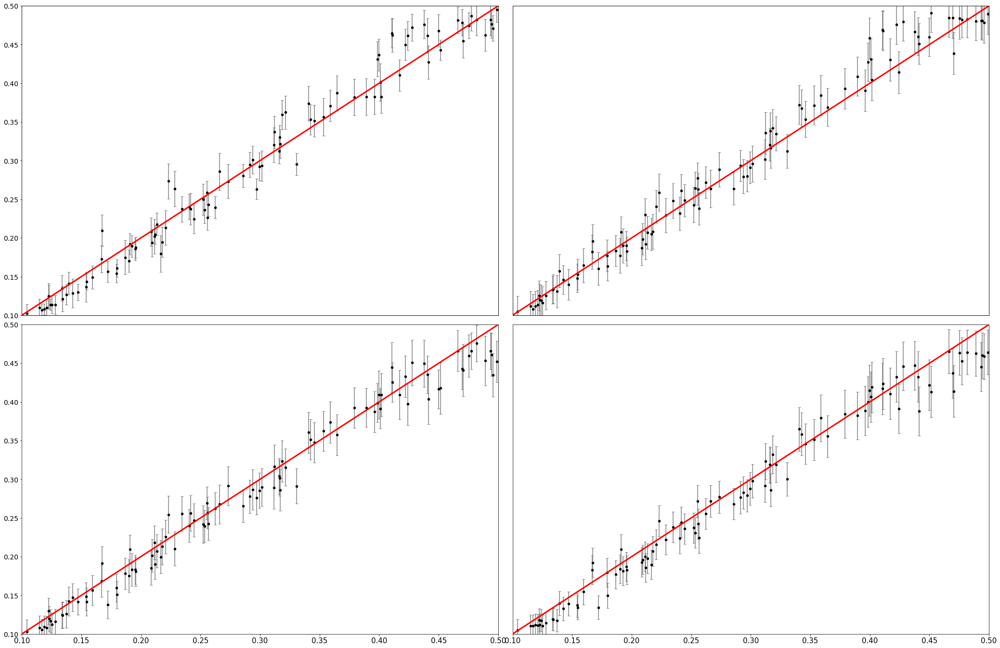

In [10]:
fig_shape = (2,2)
axes = generateAxesForMultiplePlots(shape=fig_shape,figsize=(36,24),wspace=0.03,hspace=0.03)
plt.rcParams["font.family"] = "serif"
plt.rcParams['xtick.labelsize'] = 20
plt.rcParams['ytick.labelsize'] = 20
fontsize = 30
ideal1 = np.linspace(0.1,0.5,3)
ideal2 = np.linspace(0.2,1.2,3)

l=0
for n in range(4):
    i = n%2; j = n//2;
    mist = mists[n]
    y_true, y_pred = mist.make_plots(show_plot=False, data_return=True)
    axes[i,j].errorbar(y_true[l][:,0], y_pred[l][0][:,0], y_pred[l][1][:,0],linestyle="None",ecolor="grey",
                     capsize=3,zorder=0)
    axes[i,j].scatter(y_true[l][:,0], y_pred[l][0][:,0],s=20,c='k', zorder=10)
    axes[i,j].plot(ideal1,ideal1,"r",lw=3,zorder=12)
    remove_inner_axes(axes,fig_shape)
    axes[i,j].set_xlim(0.1,0.5)
    axes[i,j].set_ylim(0.1,0.5)
    if j == 0:
        ax = axes[i,j].twiny()
        ax.xaxis.tick_top()
        ax.set_xticks([])
        #ax.set_xlabel(r"Monopole={}".format(mono),fontsize=fontsize)
    if i == 2:
        ax = axes[i,j].twinx()
        ax.yaxis.tick_right()
        ax.set_yticks([])
        #ax.set_ylabel(r"Normalization={}".format(norm),fontsize=fontsize)
#axes[0,3].set_xlabel("$\Omega_\mathrm{m, true}$", fontsize=fontsize)
#axes[0,3].set_ylabel("$\Omega_\mathrm{m, pred}$", fontsize=fontsize)
#plt.savefig("Exploration_HI_omegam_TNG.png", dpi=200, bbox_inches='tight')

(1000, 2)
$\Omega_m$: MSE=0.003, % error=16.777%, R2 score=0.740,chi2=7.562, bias=-0.149
$\sigma_8$: MSE=0.031, % error=16.559%, R2 score=-1.328,chi2=25.161, bias=0.152
(1000, 2)
$\Omega_m$: MSE=0.005, % error=20.337%, R2 score=0.647,chi2=8.715, bias=-0.195
$\sigma_8$: MSE=0.037, % error=18.273%, R2 score=-1.774,chi2=40.590, bias=0.172
(1000, 2)
$\Omega_m$: MSE=0.004, % error=19.250%, R2 score=0.671,chi2=7.009, bias=-0.179
$\sigma_8$: MSE=0.029, % error=15.763%, R2 score=-1.139,chi2=12.536, bias=0.139
(1000, 2)
$\Omega_m$: MSE=0.003, % error=16.229%, R2 score=0.760,chi2=4.332, bias=-0.140
$\sigma_8$: MSE=0.013, % error=12.876%, R2 score=0.008,chi2=1.006, bias=-0.023


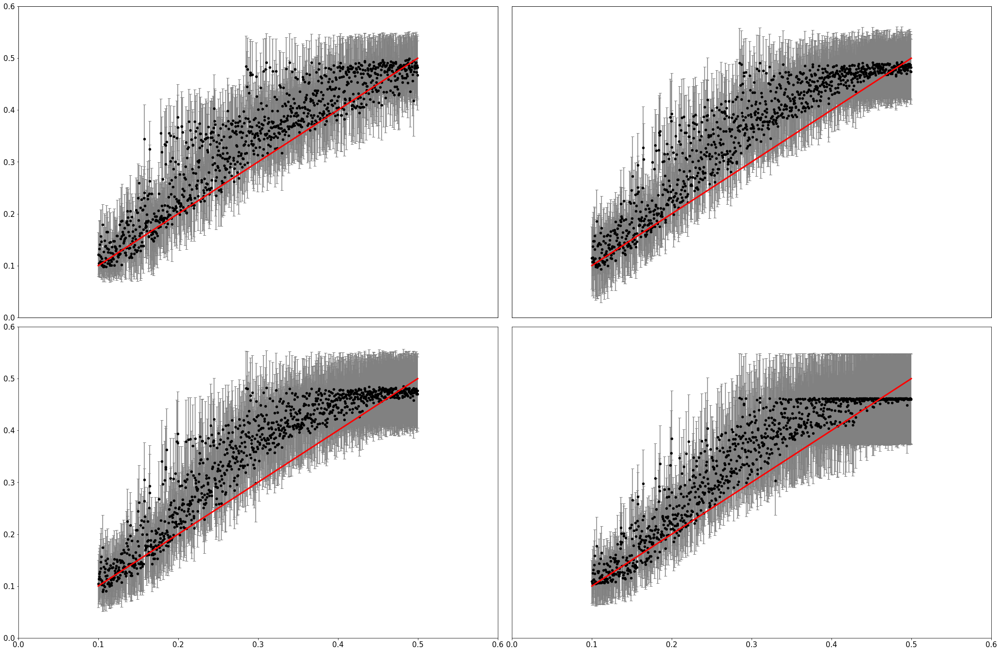

In [14]:
fig_shape = (2,2)
axes = generateAxesForMultiplePlots(shape=fig_shape,figsize=(36,24),wspace=0.03,hspace=0.03)
plt.rcParams["font.family"] = "serif"
plt.rcParams['xtick.labelsize'] = 20
plt.rcParams['ytick.labelsize'] = 20
fontsize = 30
ideal1 = np.linspace(0.1,0.5,3)
ideal2 = np.linspace(0.2,1.2,3)

l=0
for n in range(4):
    i = n%2; j = n//2;
    mist = mists[n]
    y_true, y_pred = mist.test_on(sims='ASTRID',show_plot=False, data_return=True)
    axes[i,j].errorbar(y_true[:,0], y_pred[0][:,0], y_pred[1][:,0],linestyle="None",ecolor="grey",
                     capsize=3,zorder=0)
    axes[i,j].scatter(y_true[:,0], y_pred[0][:,0],s=20,c='k', zorder=10)
    axes[i,j].plot(ideal1,ideal1,"r",lw=3,zorder=12)
    remove_inner_axes(axes,fig_shape)
    axes[i,j].set_xlim(0.0,0.6)
    axes[i,j].set_ylim(0.0,0.6)
    if j == 0:
        ax = axes[i,j].twiny()
        ax.xaxis.tick_top()
        ax.set_xticks([])
        #ax.set_xlabel(r"Monopole={}".format(mono),fontsize=fontsize)
    if i == 2:
        ax = axes[i,j].twinx()
        ax.yaxis.tick_right()
        ax.set_yticks([])
        #ax.set_ylabel(r"Normalization={}".format(norm),fontsize=fontsize)
#axes[0,3].set_xlabel("$\Omega_\mathrm{m, true}$", fontsize=fontsize)
#axes[0,3].set_ylabel("$\Omega_\mathrm{m, pred}$", fontsize=fontsize)
#plt.savefig("Exploration_HI_omegam_TNG.png", dpi=200, bbox_inches='tight')

In [10]:
sim    = ['TNG', 'SIMBA']
field  = 'HI'
gammas = [0, 0.001, 0.01, 0.1,1]
betas  = [0, 0.1, 1, 10, 100]
mists  = []

for i, beta in enumerate(betas):
    gamma = gammas[i]
    study_name = "TNG_SIMBA_HI_b_{}_g_{}_more_expressive".format(beta,gamma)
    storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
    mist = MIST(sim=sim, field=field, batch_size=1000, 
                data_type = 'wph',
                normalization=True,
                monopole = False,
                projection=False,
                average=True,
                device=device,
                L=4, dn=0, proc_imag=np.absolute)
    fpath = '../information_bottleneck/model/search/'
    mist.load_models(fname=study_name, which_machine="vib+cls", 
                     z_dim=400,hidden1=0.5,hidden2=0.5,dr=0.01,fpath=fpath)
    mists.append(mist)

(1000, 2)
$\Omega_m$: MSE=0.004, % error=17.701%, R2 score=0.725,chi2=187084.150, bias=-0.147
$\sigma_8$: MSE=0.048, % error=22.004%, R2 score=-2.611,chi2=268.854, bias=0.214
(1000, 2)
$\Omega_m$: MSE=0.003, % error=17.091%, R2 score=0.774,chi2=52.775, bias=-0.143
$\sigma_8$: MSE=0.036, % error=18.505%, R2 score=-1.713,chi2=175580.281, bias=0.174
(1000, 2)
$\Omega_m$: MSE=0.003, % error=15.089%, R2 score=0.794,chi2=65.003, bias=-0.108
$\sigma_8$: MSE=0.042, % error=20.677%, R2 score=-2.146,chi2=1049.929, bias=0.199
(1000, 2)
$\Omega_m$: MSE=0.005, % error=21.676%, R2 score=0.594,chi2=36626.166, bias=-0.214
$\sigma_8$: MSE=0.041, % error=19.979%, R2 score=-2.102,chi2=49439.496, bias=0.192


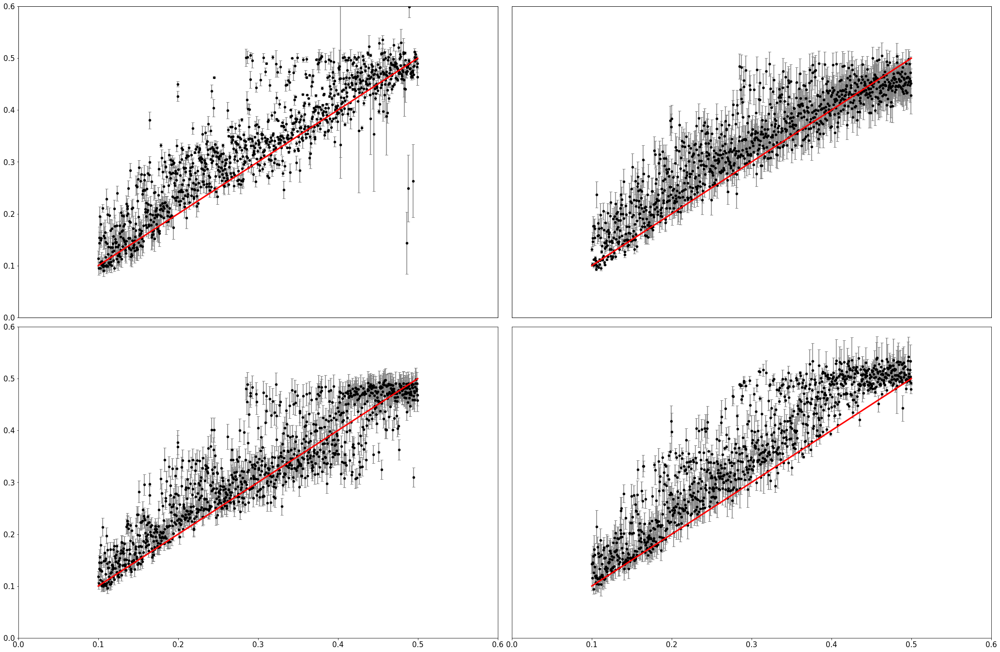

In [11]:
fig_shape = (2,2)
axes = generateAxesForMultiplePlots(shape=fig_shape,figsize=(36,24),wspace=0.03,hspace=0.03)
plt.rcParams["font.family"] = "serif"
plt.rcParams['xtick.labelsize'] = 20
plt.rcParams['ytick.labelsize'] = 20
fontsize = 30
ideal1 = np.linspace(0.1,0.5,3)
ideal2 = np.linspace(0.2,1.2,3)

l=0
for n in range(4):
    i = n%2; j = n//2;
    mist = mists[n]
    y_true, y_pred = mist.test_on(sims='ASTRID',show_plot=False, data_return=True)
    axes[i,j].errorbar(y_true[:,0], y_pred[0][:,0], y_pred[1][:,0],linestyle="None",ecolor="grey",
                     capsize=3,zorder=0)
    axes[i,j].scatter(y_true[:,0], y_pred[0][:,0],s=20,c='k', zorder=10)
    axes[i,j].plot(ideal1,ideal1,"r",lw=3,zorder=12)
    remove_inner_axes(axes,fig_shape)
    axes[i,j].set_xlim(0.0,0.6)
    axes[i,j].set_ylim(0.0,0.6)
    if j == 0:
        ax = axes[i,j].twiny()
        ax.xaxis.tick_top()
        ax.set_xticks([])
        #ax.set_xlabel(r"Monopole={}".format(mono),fontsize=fontsize)
    if i == 2:
        ax = axes[i,j].twinx()
        ax.yaxis.tick_right()
        ax.set_yticks([])
        #ax.set_ylabel(r"Normalization={}".format(norm),fontsize=fontsize)
#axes[0,3].set_xlabel("$\Omega_\mathrm{m, true}$", fontsize=fontsize)
#axes[0,3].set_ylabel("$\Omega_\mathrm{m, pred}$", fontsize=fontsize)
#plt.savefig("Exploration_HI_omegam_TNG.png", dpi=200, bbox_inches='tight')

In [8]:
sim    = ['TNG', 'SIMBA']
field  = 'HI'
gammas = [0, 0.001, 0.01, 0.1,1]
betas  = [0, 0.1, 1, 10, 100]
mists  = []

for i, beta in enumerate(betas):
    gamma = gammas[i]
    study_name = "TNG_SIMBA_HI_b_{}_g_{}_less_expressive".format(beta,gamma)
    storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
    mist = MIST(sim=sim, field=field, batch_size=1000, 
                data_type = 'wph',
                normalization=True,
                monopole = False,
                projection=False,
                average=True,
                device=device,
                L=4, dn=0, proc_imag=np.absolute)
    fpath = '../information_bottleneck/model/search/'
    mist.load_models(fname=study_name, which_machine="vib+cls", 
                     z_dim=400,hidden1=0.1,hidden2=0.1,dr=0.01,fpath=fpath)
    mists.append(mist)

(1000, 2)
$\Omega_m$: MSE=0.034, % error=41.964%, R2 score=-1.545,chi2=469.430, bias=0.246
$\sigma_8$: MSE=0.016, % error=12.950%, R2 score=-0.163,chi2=12.841, bias=-0.031
(1000, 2)
$\Omega_m$: MSE=0.007, % error=25.086%, R2 score=0.492,chi2=36.536, bias=-0.210
$\sigma_8$: MSE=0.028, % error=15.931%, R2 score=-1.130,chi2=30.454, bias=0.124
(1000, 2)
$\Omega_m$: MSE=0.007, % error=25.600%, R2 score=0.479,chi2=14.634, bias=-0.246
$\sigma_8$: MSE=0.019, % error=12.780%, R2 score=-0.428,chi2=8.831, bias=0.101
(1000, 2)
$\Omega_m$: MSE=0.006, % error=24.914%, R2 score=0.551,chi2=686.011, bias=-0.243
$\sigma_8$: MSE=0.014, % error=11.092%, R2 score=-0.034,chi2=3.853, bias=0.053


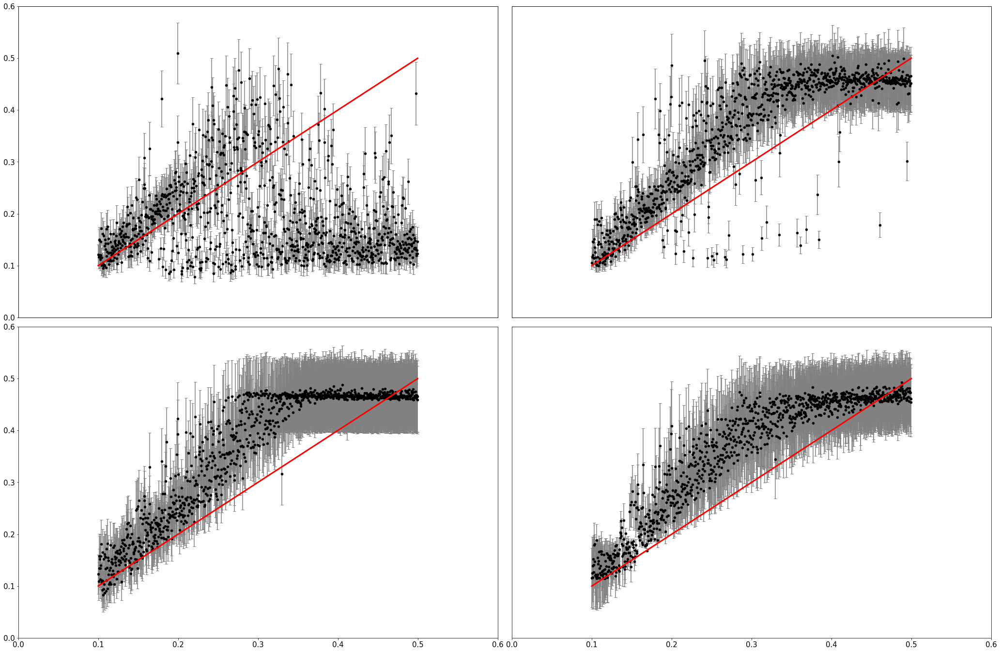

In [9]:
fig_shape = (2,2)
axes = generateAxesForMultiplePlots(shape=fig_shape,figsize=(36,24),wspace=0.03,hspace=0.03)
plt.rcParams["font.family"] = "serif"
plt.rcParams['xtick.labelsize'] = 20
plt.rcParams['ytick.labelsize'] = 20
fontsize = 30
ideal1 = np.linspace(0.1,0.5,3)
ideal2 = np.linspace(0.2,1.2,3)

l=0
for n in range(4):
    i = n%2; j = n//2;
    mist = mists[n]
    y_true, y_pred = mist.test_on(sims='ASTRID',show_plot=False, data_return=True)
    axes[i,j].errorbar(y_true[:,0], y_pred[0][:,0], y_pred[1][:,0],linestyle="None",ecolor="grey",
                     capsize=3,zorder=0)
    axes[i,j].scatter(y_true[:,0], y_pred[0][:,0],s=20,c='k', zorder=10)
    axes[i,j].plot(ideal1,ideal1,"r",lw=3,zorder=12)
    remove_inner_axes(axes,fig_shape)
    axes[i,j].set_xlim(0.0,0.6)
    axes[i,j].set_ylim(0.0,0.6)
    if j == 0:
        ax = axes[i,j].twiny()
        ax.xaxis.tick_top()
        ax.set_xticks([])
        #ax.set_xlabel(r"Monopole={}".format(mono),fontsize=fontsize)
    if i == 2:
        ax = axes[i,j].twinx()
        ax.yaxis.tick_right()
        ax.set_yticks([])
        #ax.set_ylabel(r"Normalization={}".format(norm),fontsize=fontsize)
#axes[0,3].set_xlabel("$\Omega_\mathrm{m, true}$", fontsize=fontsize)
#axes[0,3].set_ylabel("$\Omega_\mathrm{m, pred}$", fontsize=fontsize)
#plt.savefig("Exploration_HI_omegam_TNG.png", dpi=200, bbox_inches='tight')

## New WPH

In [3]:
sim    = ['TNG', 'SIMBA']
field  = 'HI'
gammas = [0, 0.001, 0.01, 0.1,1]
betas  = [0, 0.1, 1, 10, 100]
gammas = [0.001, 0.01, 0.1,1]
betas  = [0.1, 1, 10, 100]
mists  = []

for i, beta in enumerate(betas):
    gamma = gammas[i]
    study_name = "TNG_SIMBA_HI_b_{}_g_{}_z_100_simple_".format(beta,gamma)
    storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
    mist = MIST(sim=sim, field=field, batch_size=1000, 
                data_type = 'pywst',
                normalization=True,
                monopole = False,
                projection=False,
                average=True,
                device=device,
                L=4, dn=2, proc_imag=np.absolute)
    fpath = '../information_bottleneck/model/search/'
    mist.load_models(fname=study_name, which_machine="vib+cls", 
                     z_dim=100,hidden1=0.1,hidden2=0.1,dr=0.1,fpath=fpath)
    mists.append(mist)

(15000, 2)
$\Omega_m$: MSE=0.004, % error=18.386%, R2 score=0.731,chi2=3.459, bias=-0.031
$\sigma_8$: MSE=0.011, % error=10.437%, R2 score=0.191,chi2=2.716, bias=0.009
(15000, 2)
$\Omega_m$: MSE=0.004, % error=21.390%, R2 score=0.668,chi2=1.090, bias=-0.020
$\sigma_8$: MSE=0.013, % error=12.801%, R2 score=0.022,chi2=0.994, bias=-0.002
(15000, 2)
$\Omega_m$: MSE=0.003, % error=16.987%, R2 score=0.746,chi2=1.392, bias=-0.025
$\sigma_8$: MSE=0.012, % error=12.250%, R2 score=0.096,chi2=1.101, bias=-0.004
(15000, 2)
$\Omega_m$: MSE=0.003, % error=15.740%, R2 score=0.763,chi2=62785.050, bias=-0.027
$\sigma_8$: MSE=0.009, % error=9.694%, R2 score=0.352,chi2=2.344, bias=-0.017


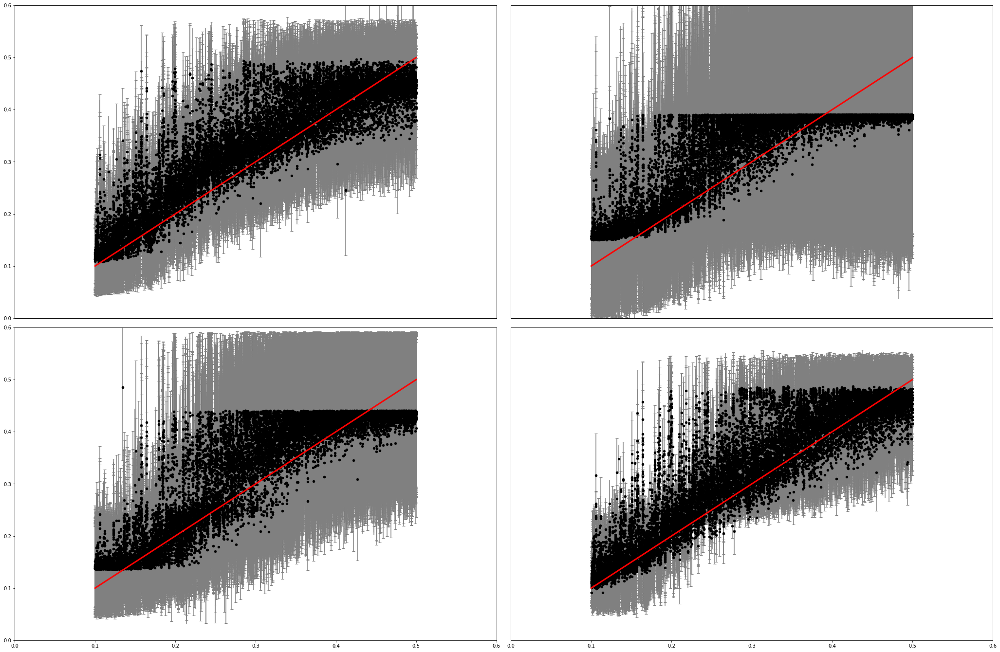

In [4]:
fig_shape = (2,2)
axes = generateAxesForMultiplePlots(shape=fig_shape,figsize=(36,24),wspace=0.03,hspace=0.03)
plt.rcParams["font.family"] = "serif"
plt.rcParams['xtick.labelsize'] = 20
plt.rcParams['ytick.labelsize'] = 20
fontsize = 30
ideal1 = np.linspace(0.1,0.5,3)
ideal2 = np.linspace(0.2,1.2,3)

l=0
for n in range(4):
    i = n%2; j = n//2;
    mist = mists[n]
    y_true, y_pred = mist.test_on(sims='ASTRID',show_plot=False, data_return=True)
    axes[i,j].errorbar(y_true[:,0], y_pred[0][:,0], y_pred[1][:,0],linestyle="None",ecolor="grey",
                     capsize=3,zorder=0)
    axes[i,j].scatter(y_true[:,0], y_pred[0][:,0],s=20,c='k', zorder=10)
    axes[i,j].plot(ideal1,ideal1,"r",lw=3,zorder=12)
    remove_inner_axes(axes,fig_shape)
    axes[i,j].set_xlim(0.0,0.6)
    axes[i,j].set_ylim(0.0,0.6)
    if j == 0:
        ax = axes[i,j].twiny()
        ax.xaxis.tick_top()
        ax.set_xticks([])
        #ax.set_xlabel(r"Monopole={}".format(mono),fontsize=fontsize)
    if i == 2:
        ax = axes[i,j].twinx()
        ax.yaxis.tick_right()
        ax.set_yticks([])
        #ax.set_ylabel(r"Normalization={}".format(norm),fontsize=fontsize)
#axes[0,3].set_xlabel("$\Omega_\mathrm{m, true}$", fontsize=fontsize)
#axes[0,3].set_ylabel("$\Omega_\mathrm{m, pred}$", fontsize=fontsize)
#plt.savefig("Exploration_HI_omegam_TNG.png", dpi=200, bbox_inches='tight')

In [7]:
sim    = ['TNG', 'SIMBA']
field  = 'HI'
gammas = [0, 0.001, 0.01, 0.1,1]
betas  = [0, 0.1, 1, 10, 100]
gammas = [0.001, 0.01, 0.1,1]
betas  = [0.1, 1, 10, 100]
mists  = []

for i, beta in enumerate(betas):
    gamma = gammas[i]
    study_name = "TNG_SIMBA_HI_b_{}_g_{}_z_100_simple".format(beta,gamma)
    storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
    mist = MIST(sim=sim, field=field, batch_size=1000, 
                data_type = 'pywst',
                normalization=True,
                monopole = False,
                projection=False,
                average=True,
                device=device,
                L=4, dn=2, proc_imag=np.absolute)
    fpath = '../information_bottleneck/model/search/'
    mist.load_models(fname=study_name, which_machine="vib+cls", 
                     z_dim=100,hidden1=0.02,hidden2=0.1,dr=0.1,fpath=fpath)
    mists.append(mist)

(15000, 2)
$\Omega_m$: MSE=0.007, % error=28.423%, R2 score=0.490,chi2=3.220, bias=-0.057
$\sigma_8$: MSE=0.014, % error=12.968%, R2 score=-0.049,chi2=1.182, bias=0.007
(15000, 2)
$\Omega_m$: MSE=0.004, % error=17.272%, R2 score=0.690,chi2=3032678.314, bias=-0.029
$\sigma_8$: MSE=0.013, % error=12.916%, R2 score=-0.006,chi2=1.001, bias=0.001
(15000, 2)
$\Omega_m$: MSE=0.008, % error=26.051%, R2 score=0.426,chi2=14.725, bias=-0.064
$\sigma_8$: MSE=0.013, % error=12.891%, R2 score=0.004,chi2=0.973, bias=-0.001
(15000, 2)
$\Omega_m$: MSE=0.006, % error=23.516%, R2 score=0.572,chi2=0.906, bias=0.004
$\sigma_8$: MSE=0.013, % error=12.841%, R2 score=0.012,chi2=0.963, bias=0.000


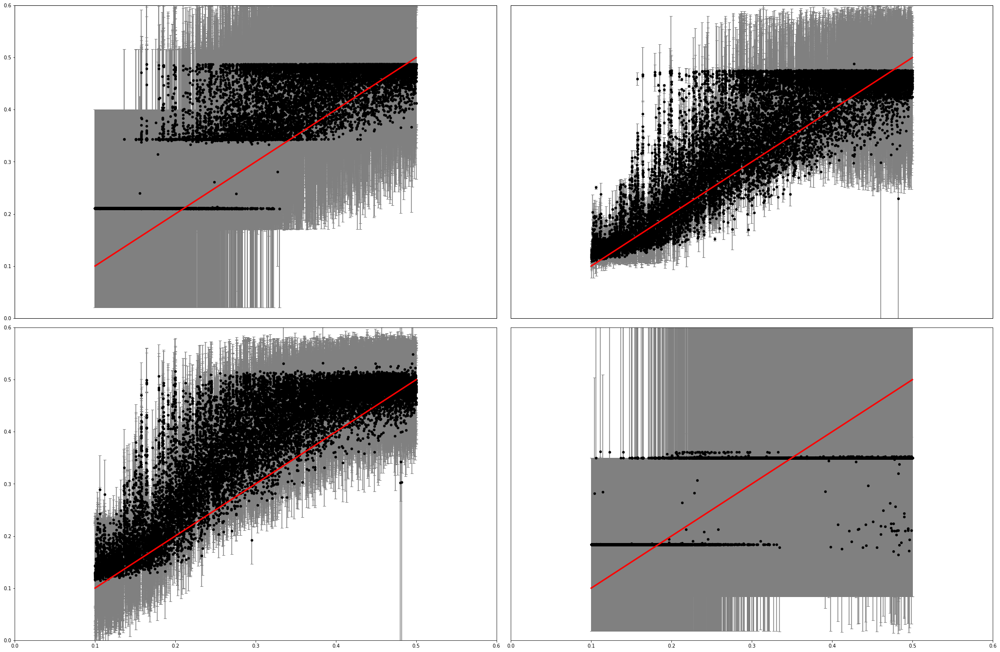

In [8]:
fig_shape = (2,2)
axes = generateAxesForMultiplePlots(shape=fig_shape,figsize=(36,24),wspace=0.03,hspace=0.03)
plt.rcParams["font.family"] = "serif"
plt.rcParams['xtick.labelsize'] = 20
plt.rcParams['ytick.labelsize'] = 20
fontsize = 30
ideal1 = np.linspace(0.1,0.5,3)
ideal2 = np.linspace(0.2,1.2,3)

l=0
for n in range(4):
    i = n%2; j = n//2;
    mist = mists[n]
    y_true, y_pred = mist.test_on(sims='ASTRID',show_plot=False, data_return=True)
    axes[i,j].errorbar(y_true[:,0], y_pred[0][:,0], y_pred[1][:,0],linestyle="None",ecolor="grey",
                     capsize=3,zorder=0)
    axes[i,j].scatter(y_true[:,0], y_pred[0][:,0],s=20,c='k', zorder=10)
    axes[i,j].plot(ideal1,ideal1,"r",lw=3,zorder=12)
    remove_inner_axes(axes,fig_shape)
    axes[i,j].set_xlim(0.0,0.6)
    axes[i,j].set_ylim(0.0,0.6)
    if j == 0:
        ax = axes[i,j].twiny()
        ax.xaxis.tick_top()
        ax.set_xticks([])
        #ax.set_xlabel(r"Monopole={}".format(mono),fontsize=fontsize)
    if i == 2:
        ax = axes[i,j].twinx()
        ax.yaxis.tick_right()
        ax.set_yticks([])
        #ax.set_ylabel(r"Normalization={}".format(norm),fontsize=fontsize)
#axes[0,3].set_xlabel("$\Omega_\mathrm{m, true}$", fontsize=fontsize)
#axes[0,3].set_ylabel("$\Omega_\mathrm{m, pred}$", fontsize=fontsize)
#plt.savefig("Exploration_HI_omegam_TNG.png", dpi=200, bbox_inches='tight')

## Raw Maps

$\Omega_m$: MSE=0.001, % error=7.005%, R2 score=0.935,chi2=2.513, bias=-0.016
$\sigma_8$: MSE=0.004, % error=6.548%, R2 score=0.677,chi2=6.328, bias=-0.009
$\Omega_m$: MSE=0.004, % error=19.254%, R2 score=0.722,chi2=10.438, bias=-0.181
$\sigma_8$: MSE=0.010, % error=10.865%, R2 score=0.218,chi2=15.057, bias=-0.062


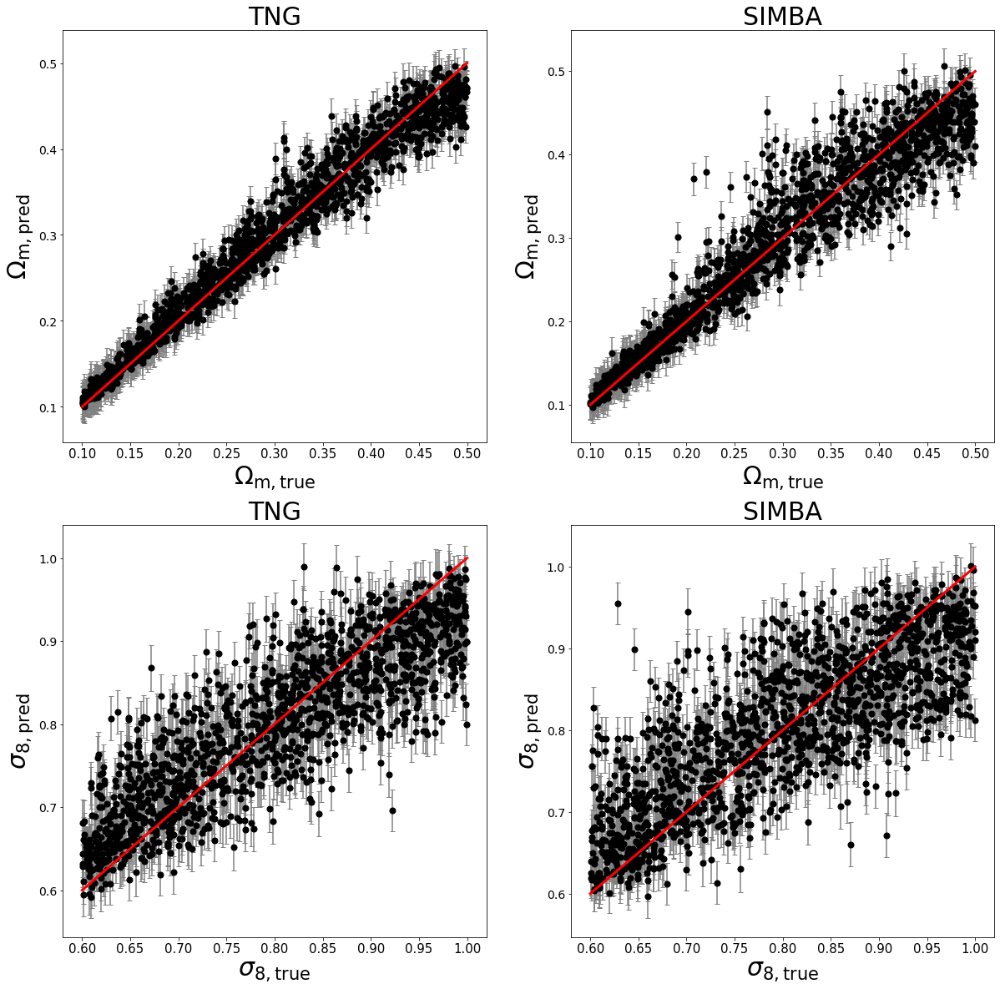

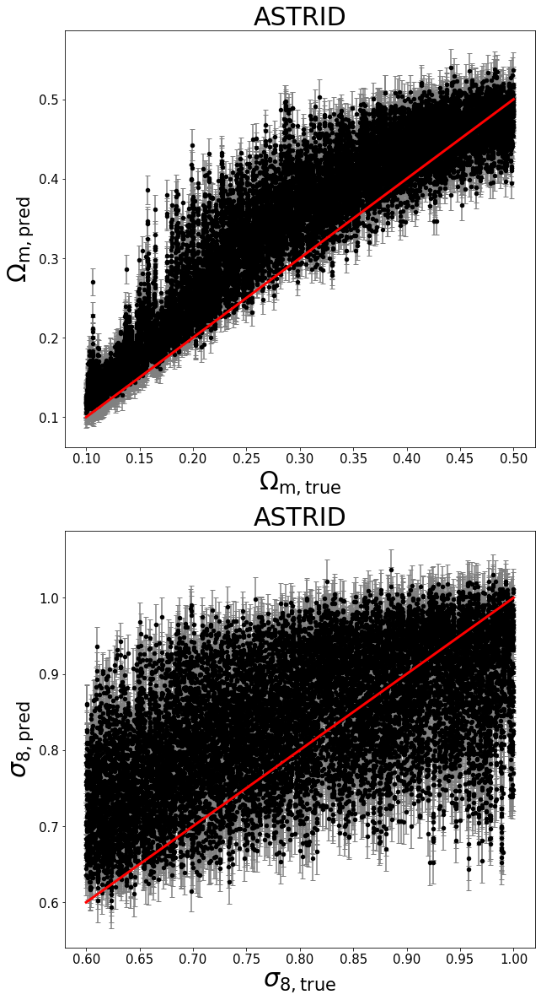

In [6]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_zero_monopole_1_new_z_500"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",
                        num_trial=100, fpath=fpath, z_dim=500)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=5.825%, R2 score=0.963,chi2=0.575, bias=-0.016
$\sigma_8$: MSE=0.003, % error=5.526%, R2 score=0.758,chi2=2.014, bias=-0.000
$\Omega_m$: MSE=0.002, % error=14.700%, R2 score=0.841,chi2=2.469, bias=-0.119
$\sigma_8$: MSE=0.016, % error=14.358%, R2 score=-0.225,chi2=10.080, bias=-0.133


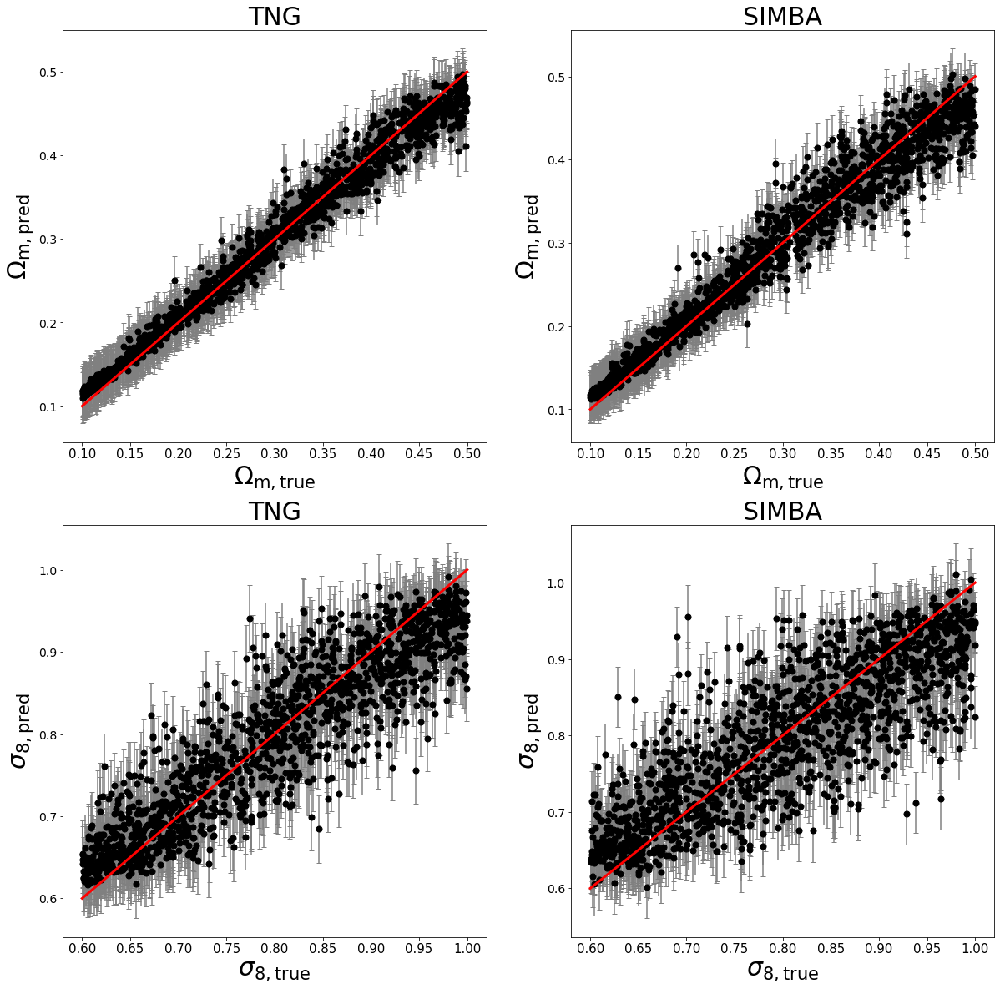

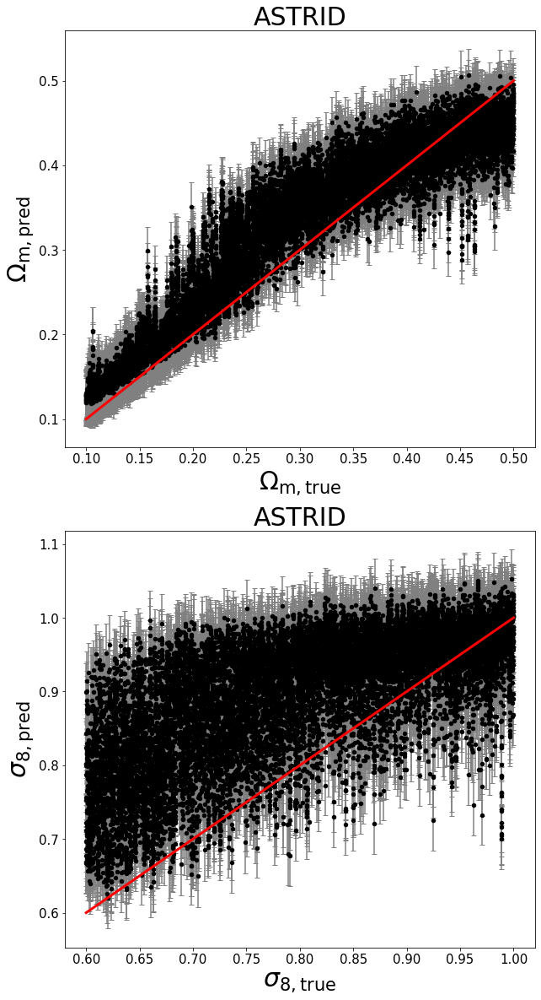

In [6]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_low_monopole_1_new_z_500"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",
                        num_trial=None, fpath=fpath, z_dim=500)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=5.480%, R2 score=0.968,chi2=0.443, bias=-0.012
$\sigma_8$: MSE=0.003, % error=5.316%, R2 score=0.791,chi2=1.000, bias=0.001
$\Omega_m$: MSE=0.002, % error=11.919%, R2 score=0.886,chi2=1.579, bias=-0.104
$\sigma_8$: MSE=0.012, % error=11.794%, R2 score=0.135,chi2=3.957, bias=-0.099


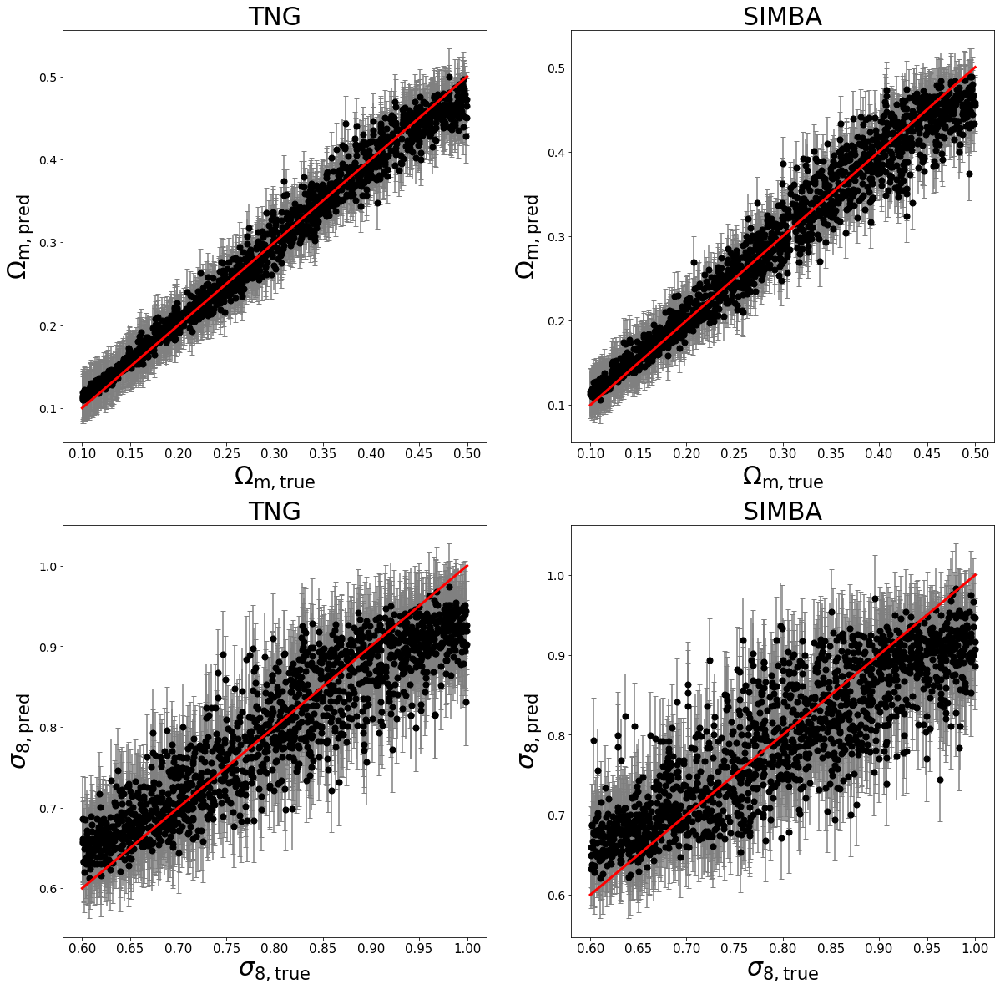

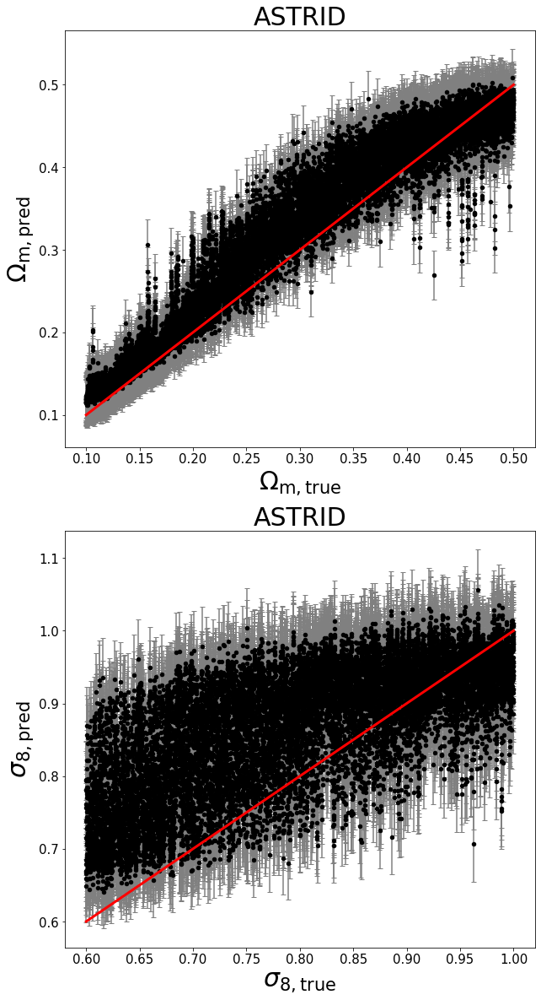

In [5]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_mid_monopole_1_new_z_500"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",
                        num_trial=None, fpath=fpath, z_dim=500)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.001, % error=7.500%, R2 score=0.948,chi2=0.598, bias=-0.020
$\sigma_8$: MSE=0.004, % error=6.141%, R2 score=0.733,chi2=0.886, bias=-0.010
$\Omega_m$: MSE=0.002, % error=14.057%, R2 score=0.856,chi2=1.751, bias=-0.095
$\sigma_8$: MSE=0.010, % error=10.862%, R2 score=0.248,chi2=2.387, bias=-0.078


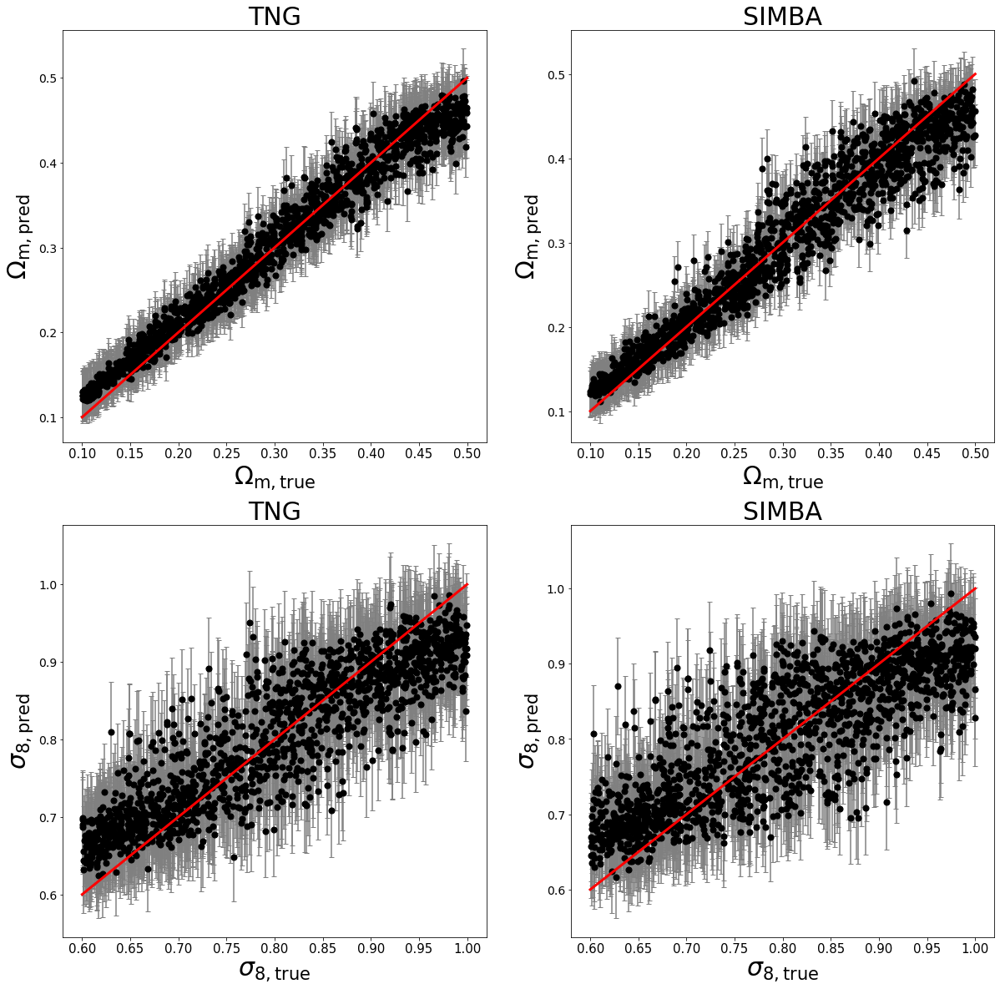

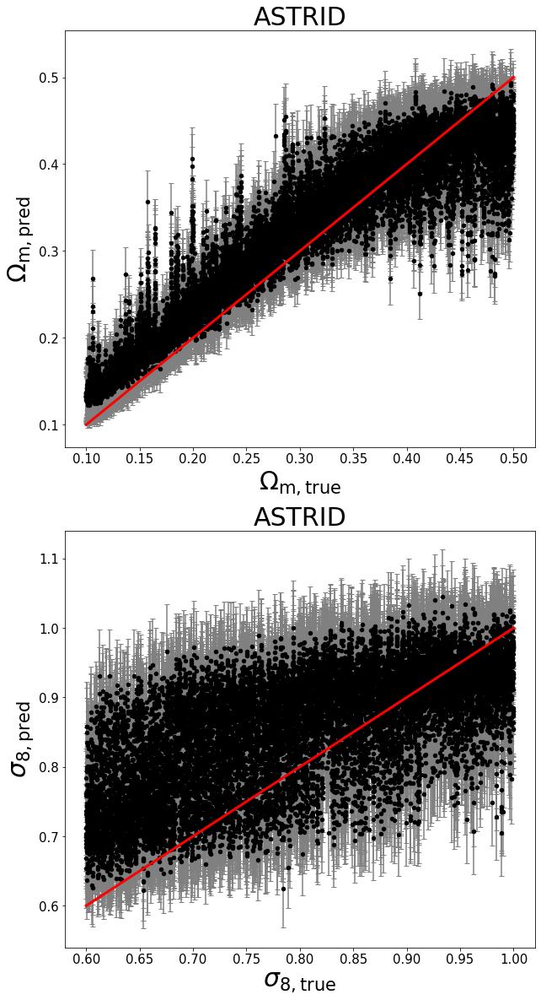

In [4]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_high_monopole_1_new_z_500"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",
                        num_trial=None, fpath=fpath, z_dim=500)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

## Raw Maps

$\Omega_m$: MSE=0.000, % error=5.177%, R2 score=0.974,chi2=0.356, bias=-0.026
$\sigma_8$: MSE=0.002, % error=4.671%, R2 score=0.842,chi2=0.772, bias=-0.003
$\Omega_m$: MSE=0.002, % error=14.661%, R2 score=0.839,chi2=2.255, bias=-0.118
$\sigma_8$: MSE=0.029, % error=20.157%, R2 score=-1.168,chi2=10.014, bias=-0.198


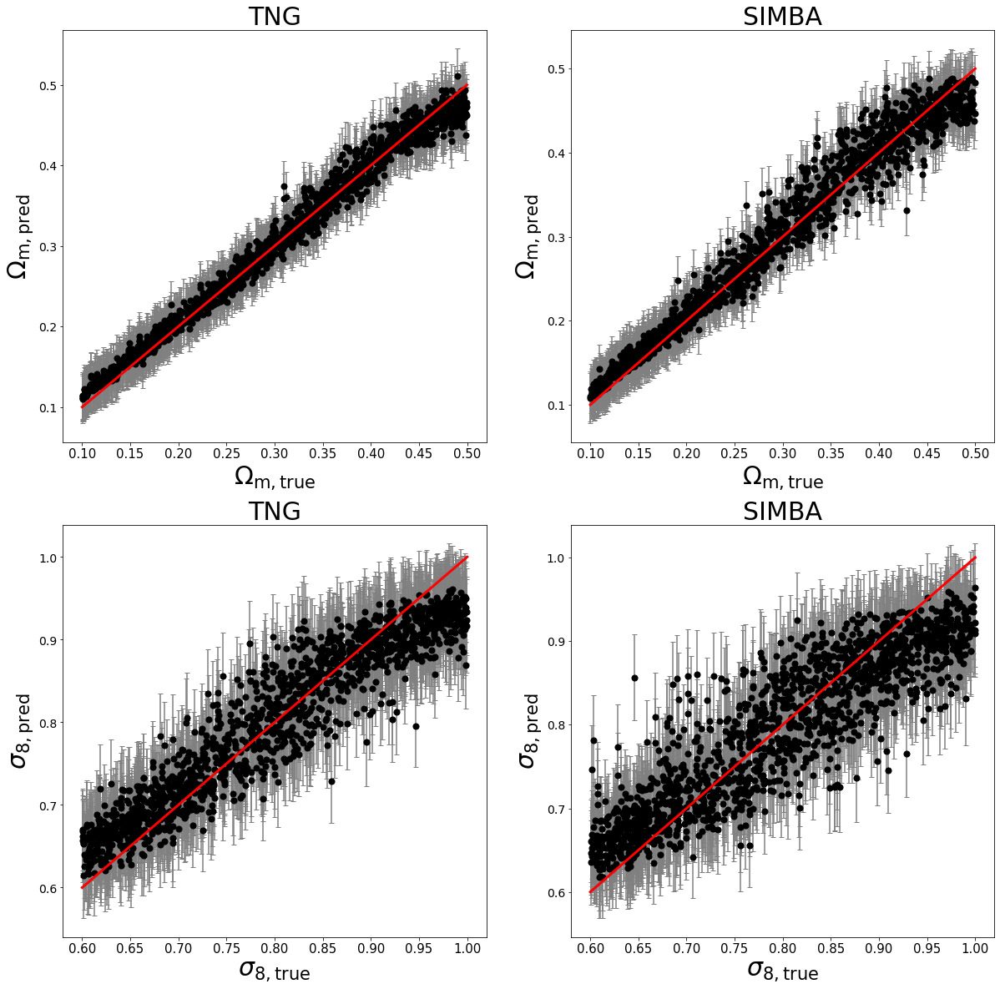

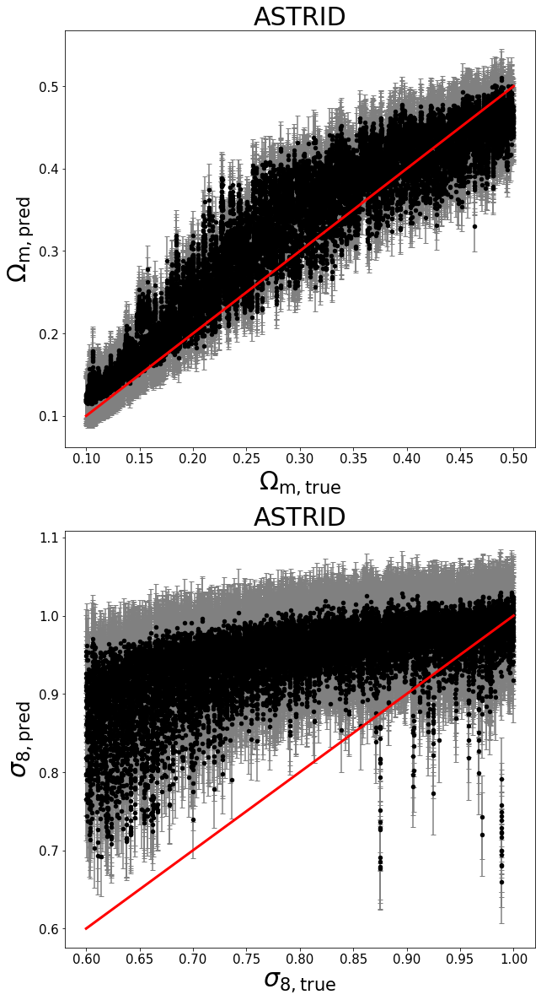

In [5]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.001, % error=6.069%, R2 score=0.953,chi2=2.024, bias=0.008
$\sigma_8$: MSE=0.004, % error=6.314%, R2 score=0.695,chi2=6.613, bias=-0.007
$\Omega_m$: MSE=0.002, % error=12.037%, R2 score=0.848,chi2=6.103, bias=-0.096
$\sigma_8$: MSE=0.012, % error=11.928%, R2 score=0.074,chi2=19.934, bias=-0.077


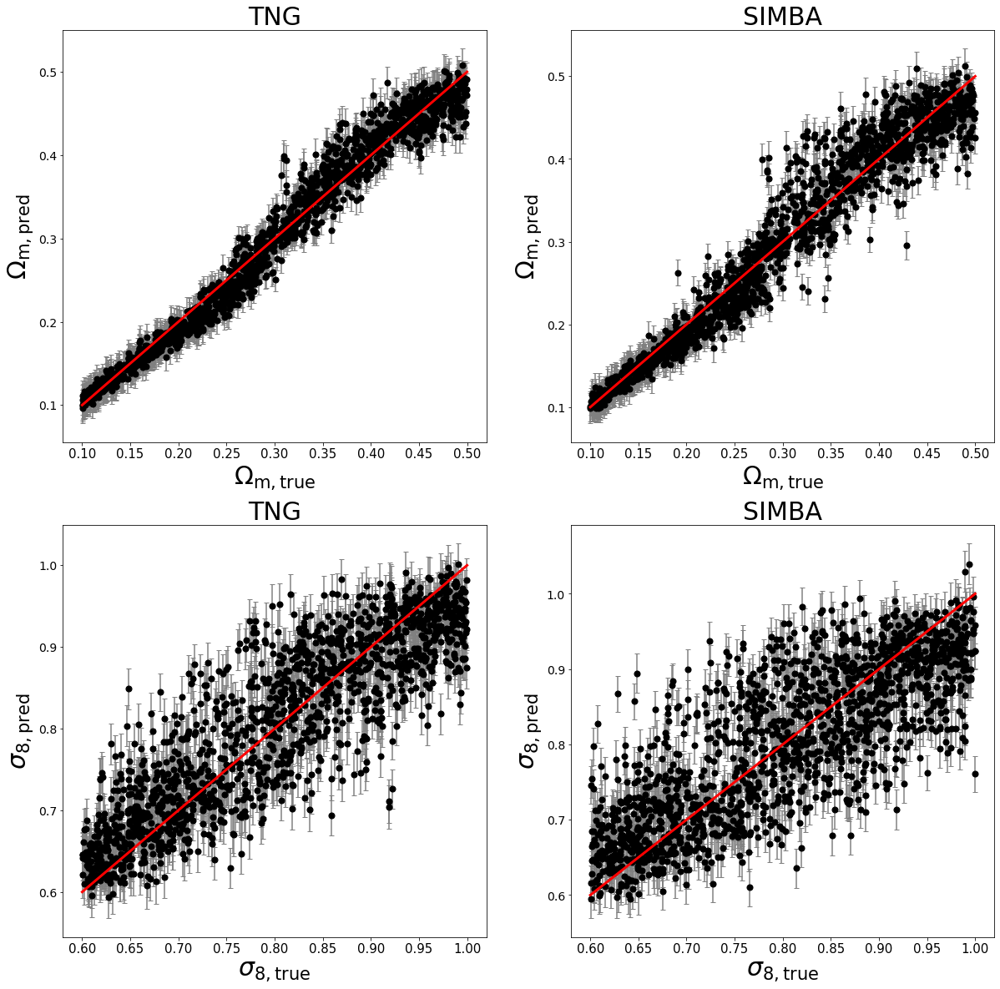

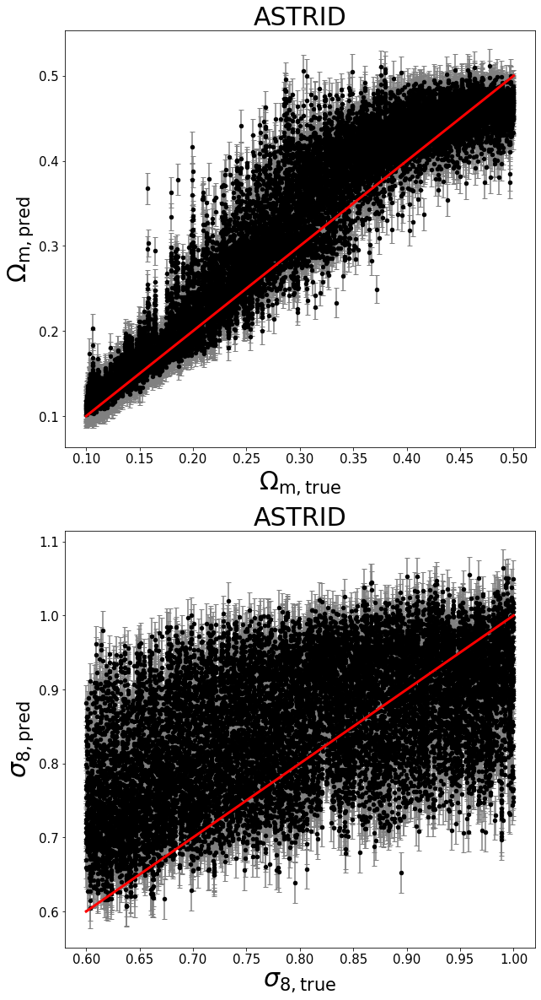

In [9]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_low_monopole_1_new"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=4.950%, R2 score=0.968,chi2=1.031, bias=-0.007
$\sigma_8$: MSE=0.003, % error=5.004%, R2 score=0.810,chi2=1.225, bias=-0.014
$\Omega_m$: MSE=0.002, % error=13.123%, R2 score=0.831,chi2=5.460, bias=-0.128
$\sigma_8$: MSE=0.021, % error=17.010%, R2 score=-0.571,chi2=11.980, bias=-0.167


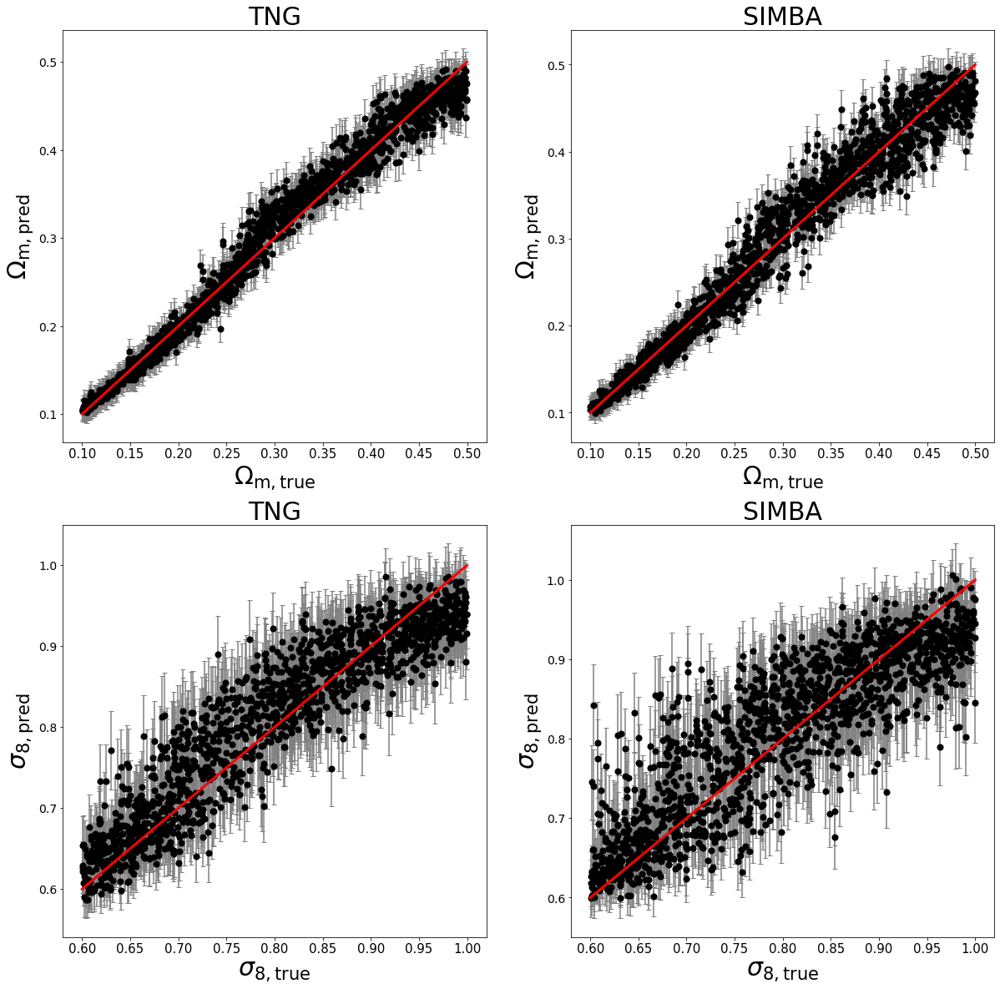

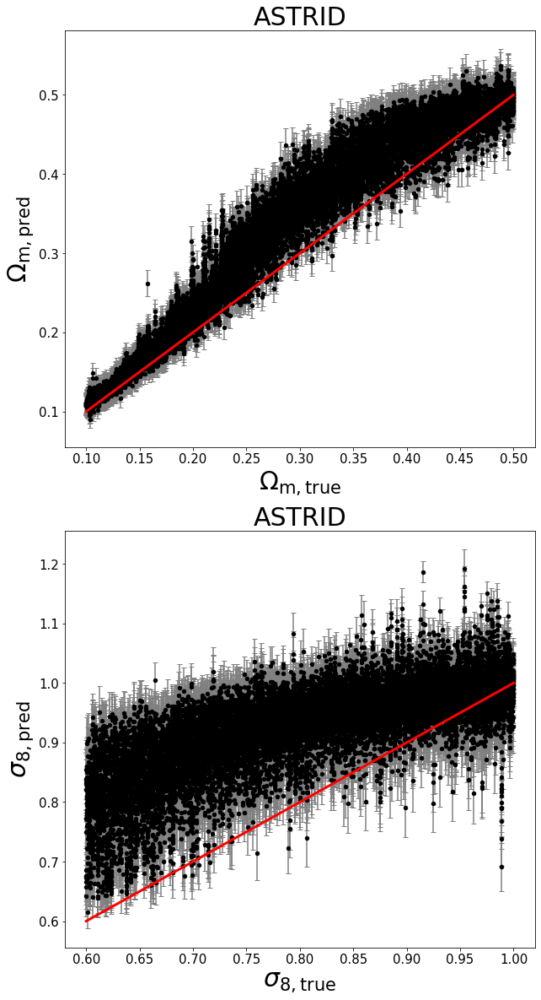

In [10]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_mid_monopole_1_new"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=4.552%, R2 score=0.974,chi2=0.486, bias=0.004
$\sigma_8$: MSE=0.002, % error=4.842%, R2 score=0.816,chi2=1.006, bias=0.003
$\Omega_m$: MSE=0.002, % error=12.719%, R2 score=0.855,chi2=2.615, bias=-0.114
$\sigma_8$: MSE=0.014, % error=13.019%, R2 score=-0.045,chi2=5.466, bias=-0.104


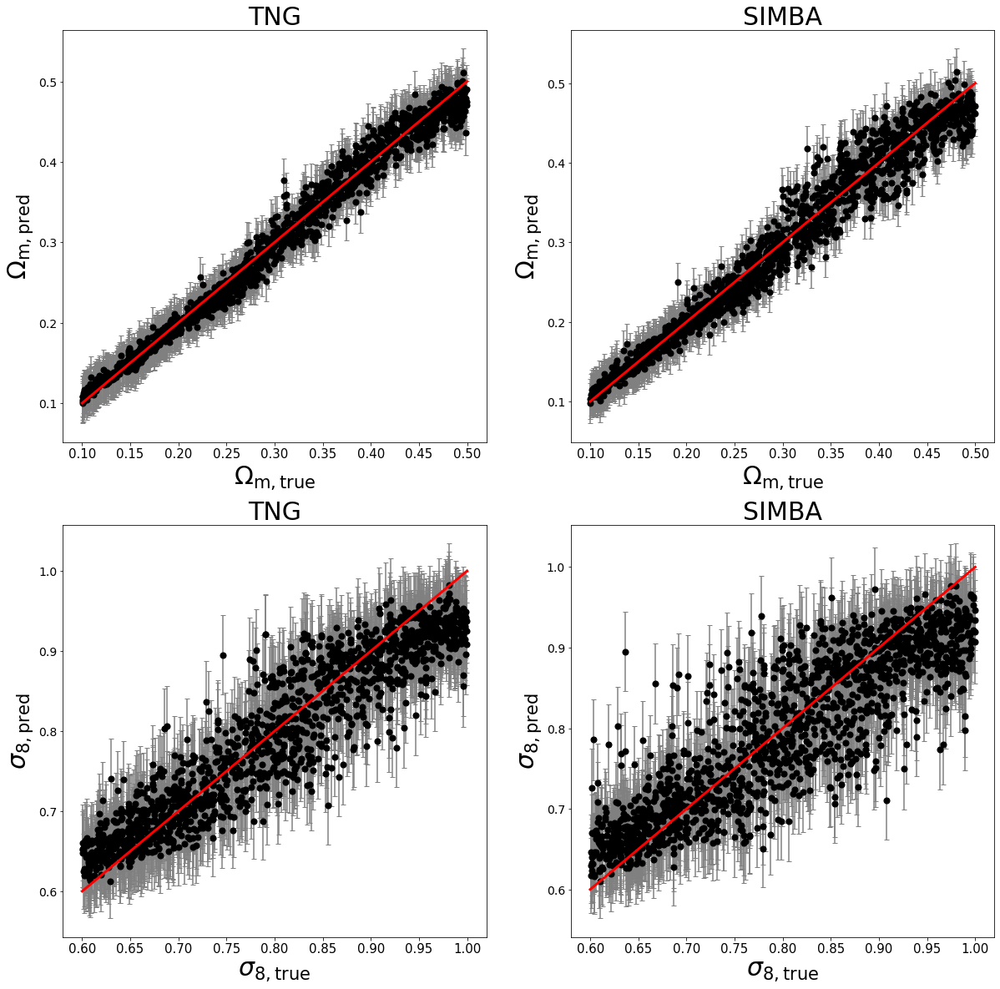

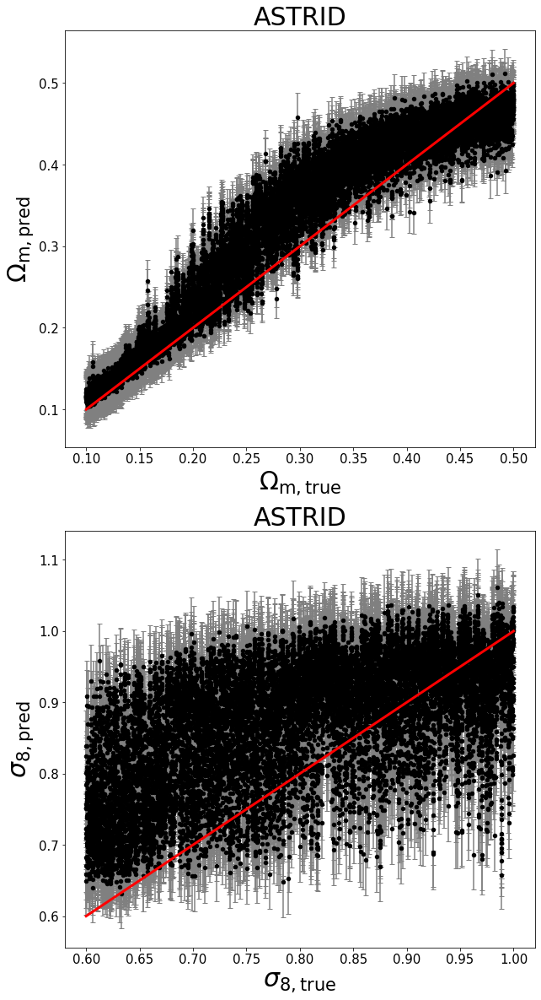

In [8]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_low_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=5.815%, R2 score=0.965,chi2=0.874, bias=0.018
$\sigma_8$: MSE=0.003, % error=5.577%, R2 score=0.746,chi2=1.013, bias=0.021
$\Omega_m$: MSE=0.001, % error=9.072%, R2 score=0.917,chi2=1.834, bias=-0.064
$\sigma_8$: MSE=0.015, % error=13.040%, R2 score=-0.106,chi2=4.376, bias=-0.113


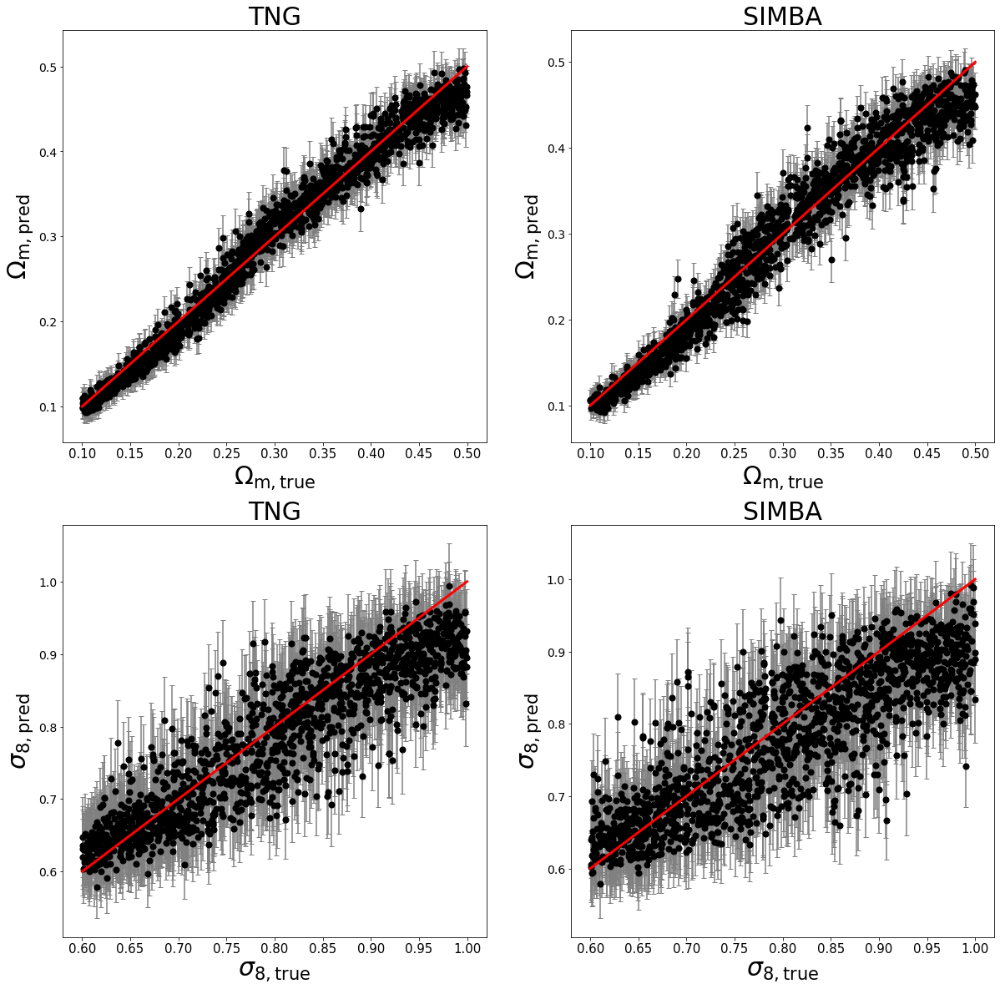

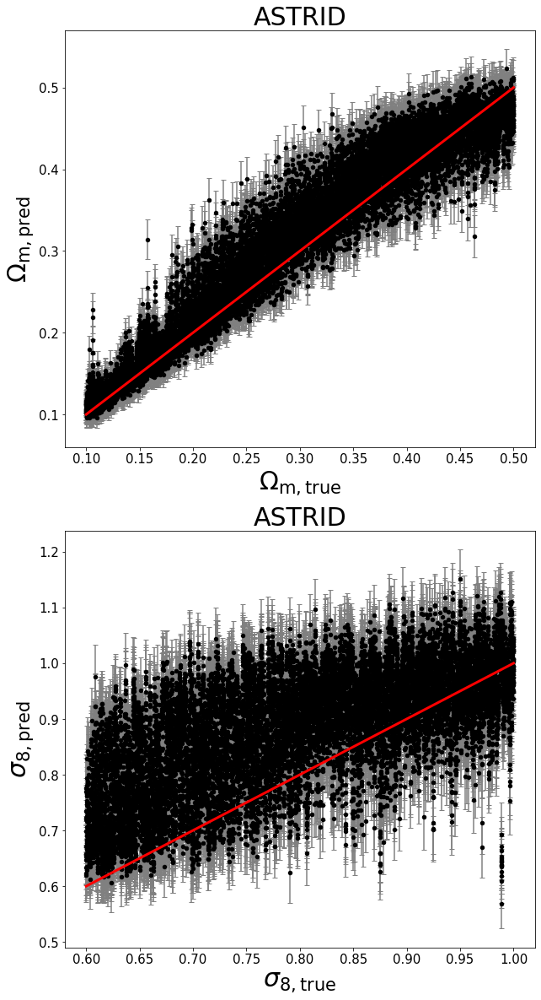

In [7]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_mid_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.001, % error=8.798%, R2 score=0.922,chi2=1.240, bias=0.038
$\sigma_8$: MSE=0.006, % error=7.555%, R2 score=0.542,chi2=1.676, bias=0.039
$\Omega_m$: MSE=0.003, % error=14.545%, R2 score=0.780,chi2=4.199, bias=-0.128
$\sigma_8$: MSE=0.008, % error=8.974%, R2 score=0.419,chi2=1.923, bias=-0.008


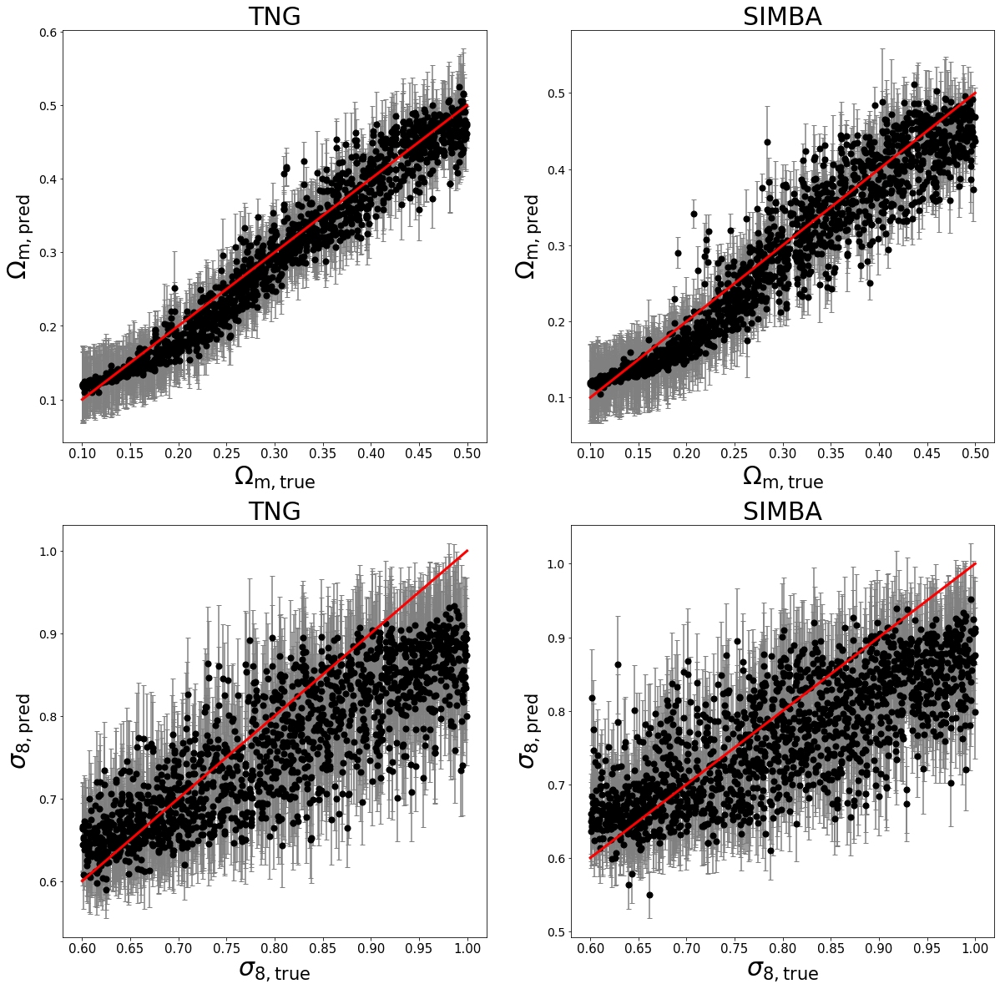

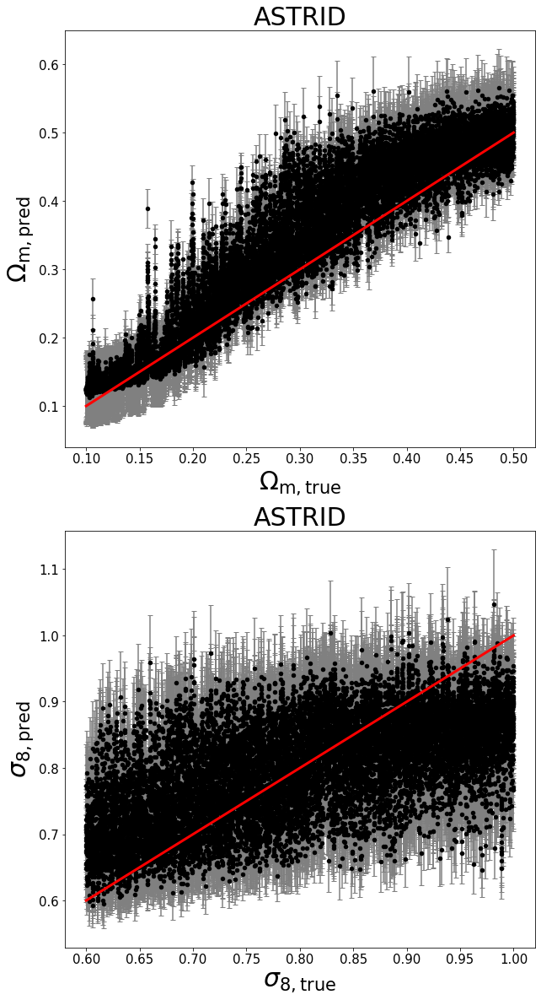

In [6]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_high_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

In [1]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

NameError: name 'MIST' is not defined

$\Omega_m$: MSE=0.000, % error=5.181%, R2 score=0.974,chi2=0.356, bias=-0.026
$\sigma_8$: MSE=0.002, % error=4.671%, R2 score=0.842,chi2=0.772, bias=-0.003
$\Omega_m$: MSE=0.006, % error=23.746%, R2 score=0.513,chi2=7.041, bias=-0.068
$\sigma_8$: MSE=0.012, % error=11.206%, R2 score=0.071,chi2=4.516, bias=-0.017


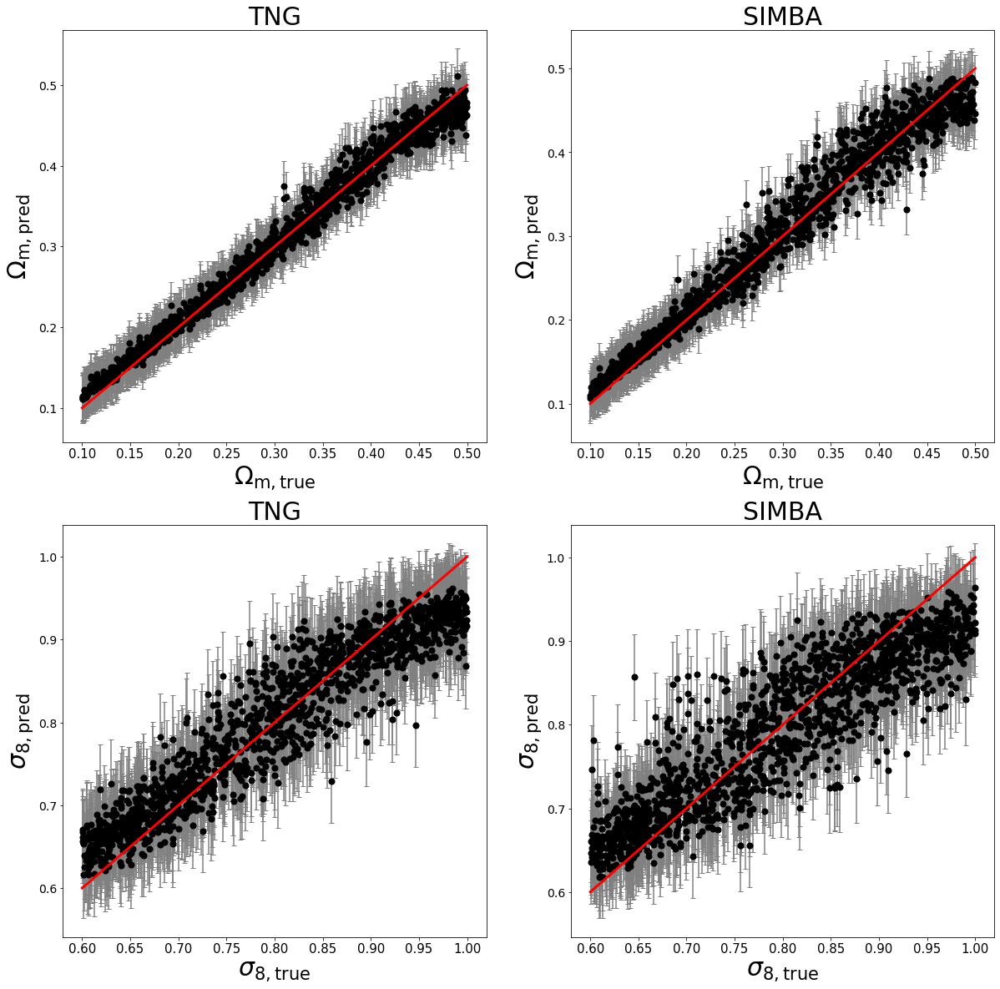

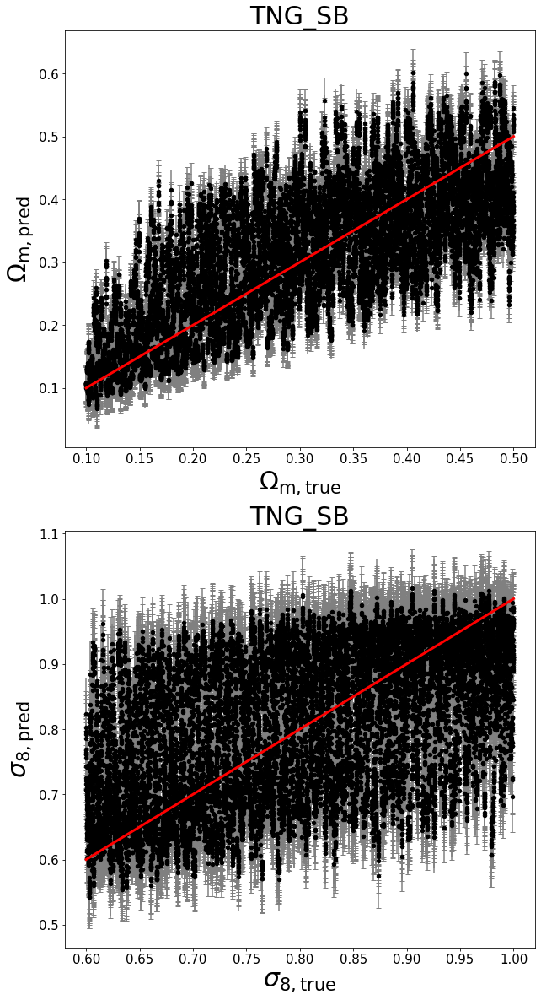

In [3]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
#plt.savefig("img/HI_cnn_zero_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_zero_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=6.091%, R2 score=0.964,chi2=0.468, bias=-0.020
$\sigma_8$: MSE=0.003, % error=5.000%, R2 score=0.812,chi2=1.047, bias=-0.003
$\Omega_m$: MSE=0.003, % error=17.297%, R2 score=0.795,chi2=2.634, bias=-0.169
$\sigma_8$: MSE=0.014, % error=13.513%, R2 score=-0.078,chi2=5.781, bias=-0.116


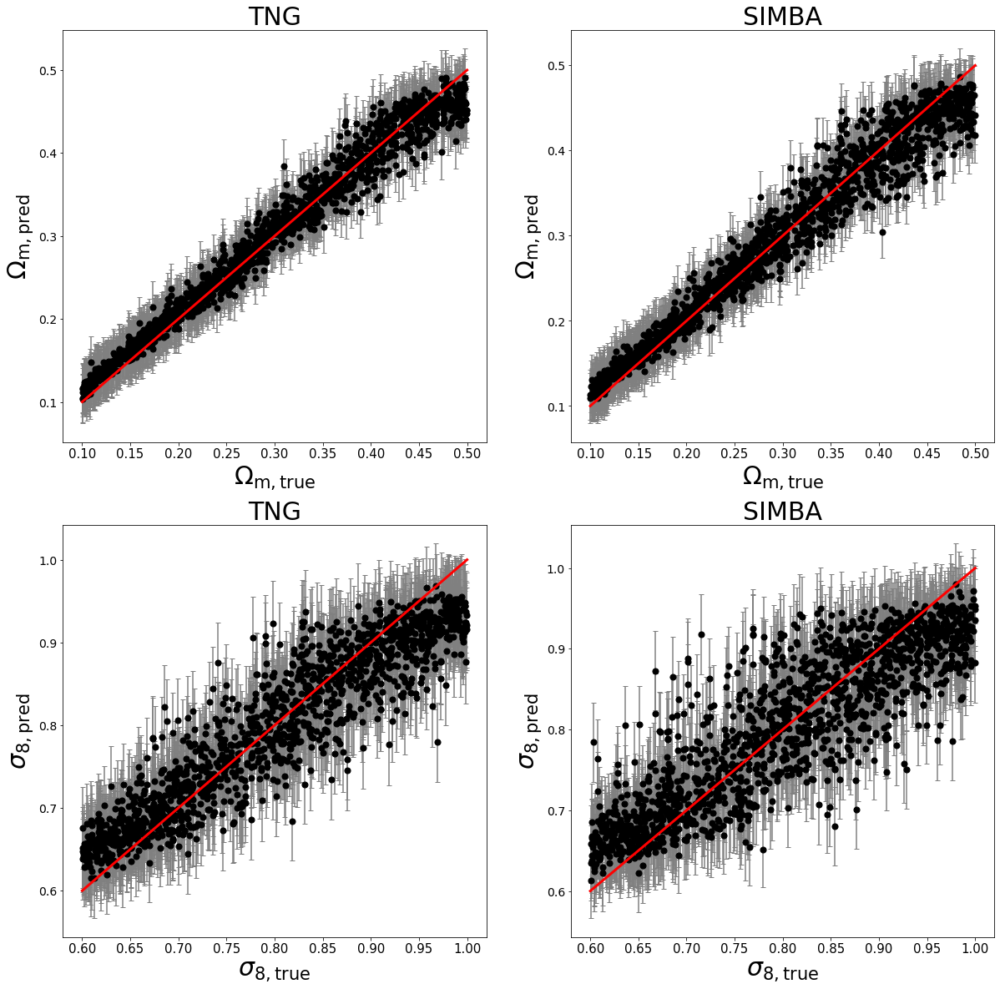

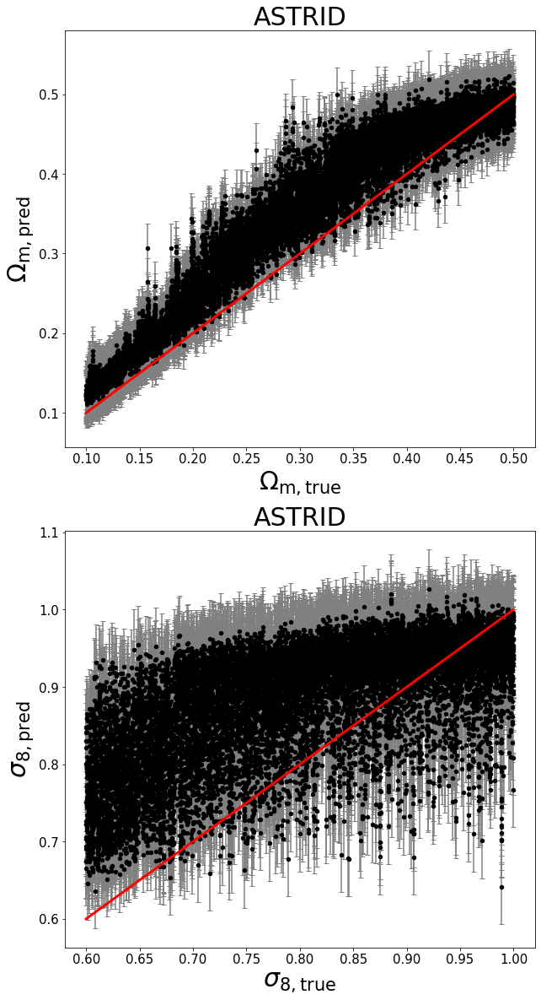

In [7]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_low_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
plt.savefig("img/HI_cnn_low_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
plt.savefig("img/HI_cnn_low_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=5.316%, R2 score=0.968,chi2=0.851, bias=-0.007
$\sigma_8$: MSE=0.003, % error=5.601%, R2 score=0.762,chi2=0.993, bias=-0.000
$\Omega_m$: MSE=0.001, % error=11.067%, R2 score=0.905,chi2=2.598, bias=-0.089
$\sigma_8$: MSE=0.016, % error=14.091%, R2 score=-0.235,chi2=5.015, bias=-0.127


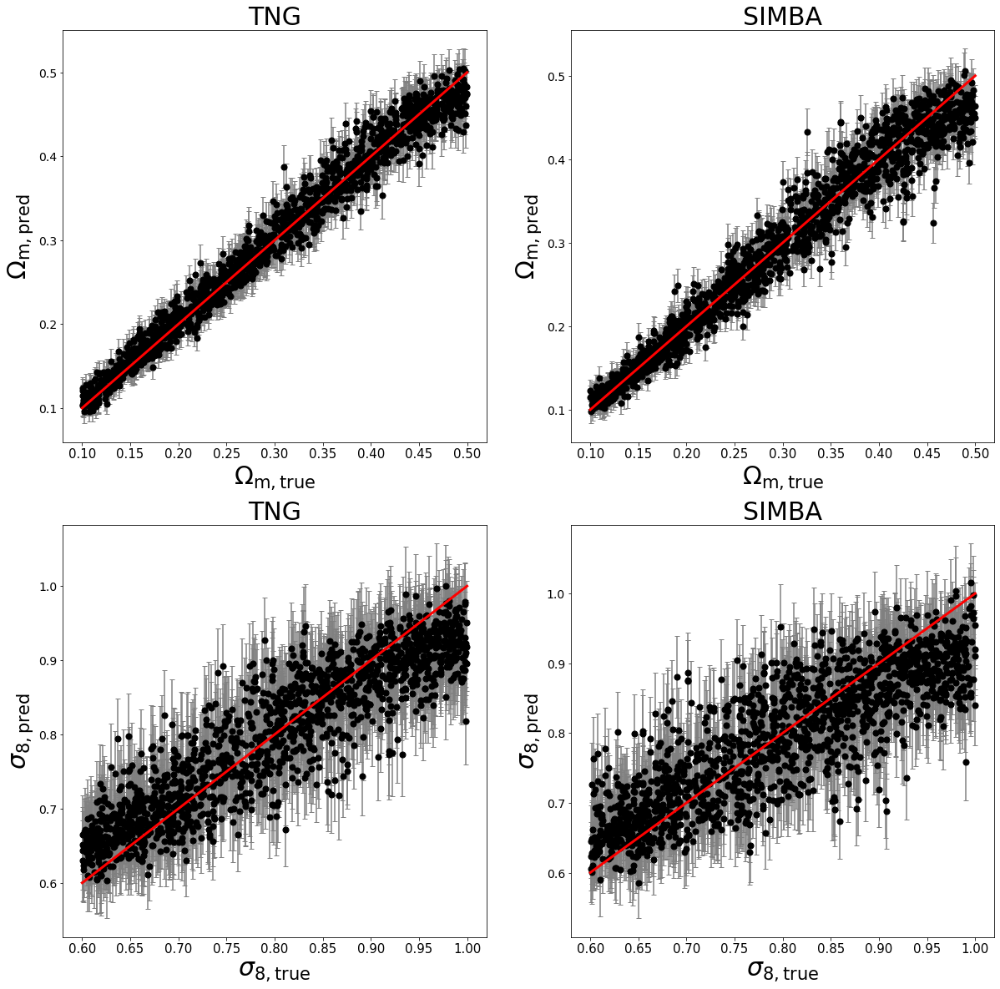

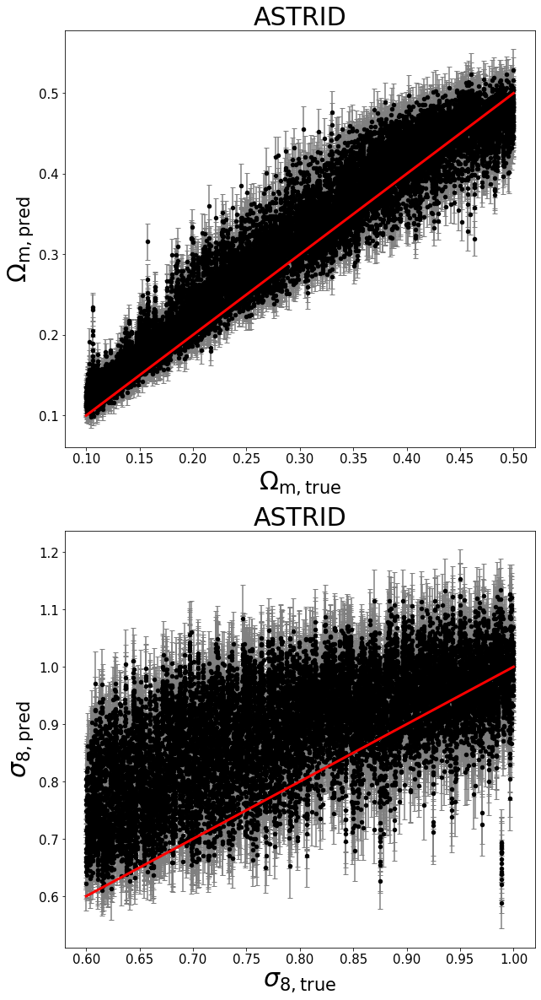

In [8]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_mid_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
plt.savefig("img/HI_cnn_mid_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
plt.savefig("img/HI_cnn_mid_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.000, % error=5.386%, R2 score=0.967,chi2=0.863, bias=-0.009
$\sigma_8$: MSE=0.003, % error=5.578%, R2 score=0.767,chi2=0.975, bias=0.001
$\Omega_m$: MSE=0.008, % error=23.766%, R2 score=0.409,chi2=20.203, bias=0.038
$\sigma_8$: MSE=0.014, % error=11.853%, R2 score=-0.026,chi2=4.313, bias=-0.031


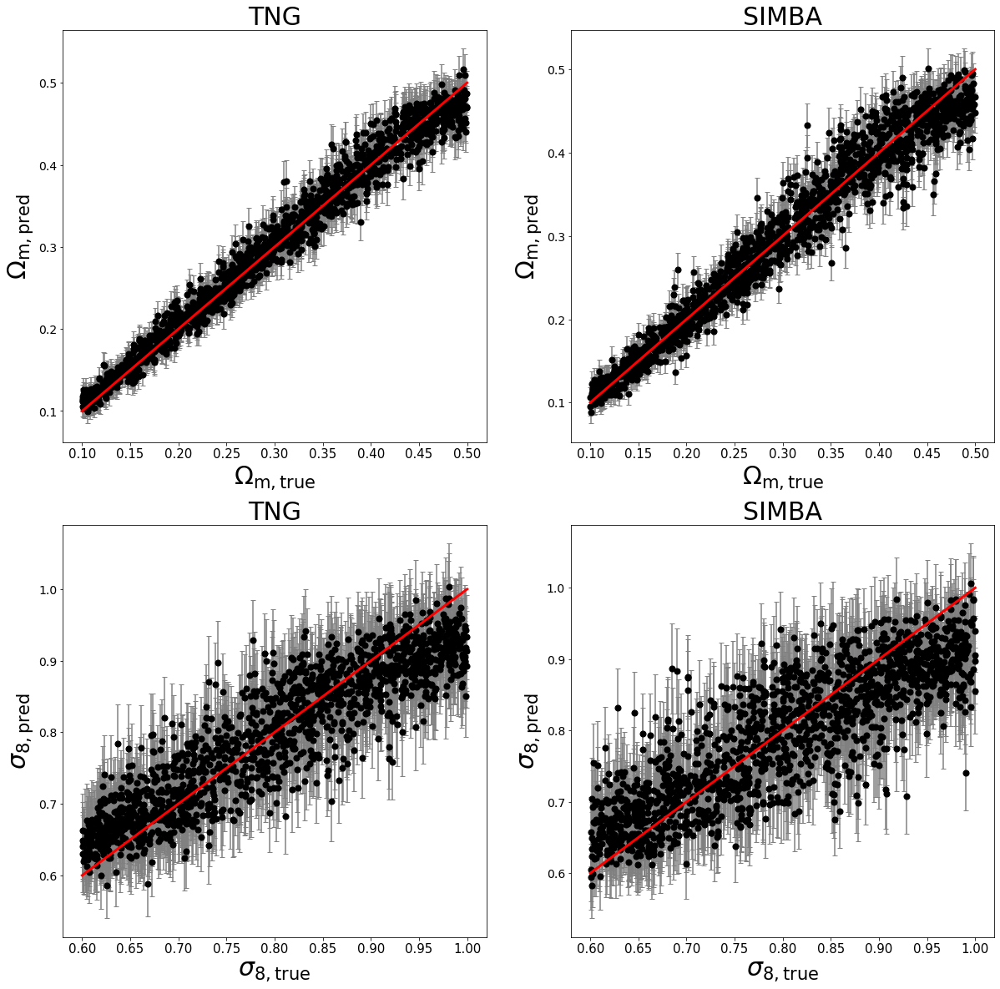

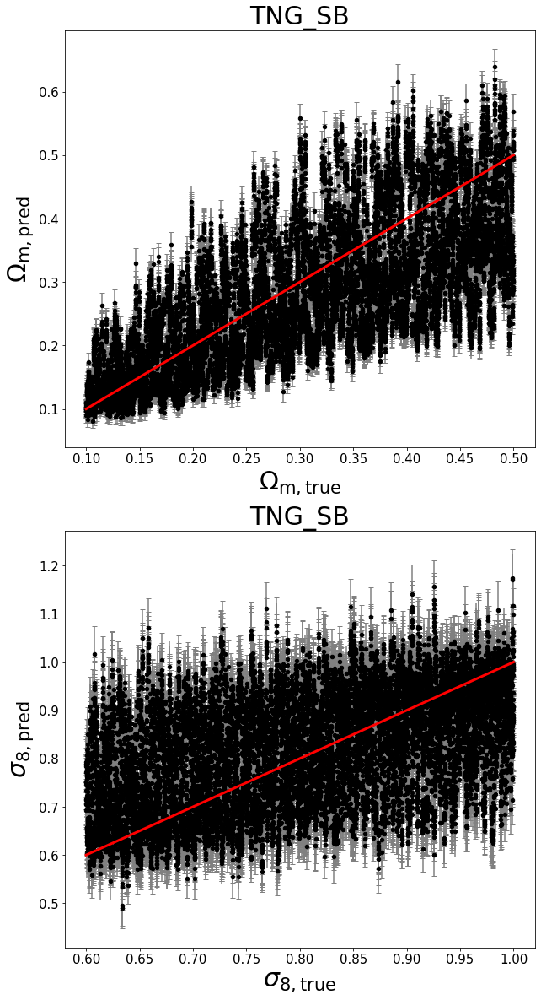

In [4]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_mid_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
#plt.savefig("img/HI_cnn_mid_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_mid_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.001, % error=10.168%, R2 score=0.912,chi2=1.733, bias=-0.037
$\sigma_8$: MSE=0.006, % error=8.075%, R2 score=0.549,chi2=1.495, bias=-0.005
$\Omega_m$: MSE=0.004, % error=20.140%, R2 score=0.705,chi2=7.737, bias=-0.193
$\sigma_8$: MSE=0.009, % error=10.414%, R2 score=0.294,chi2=2.126, bias=-0.047


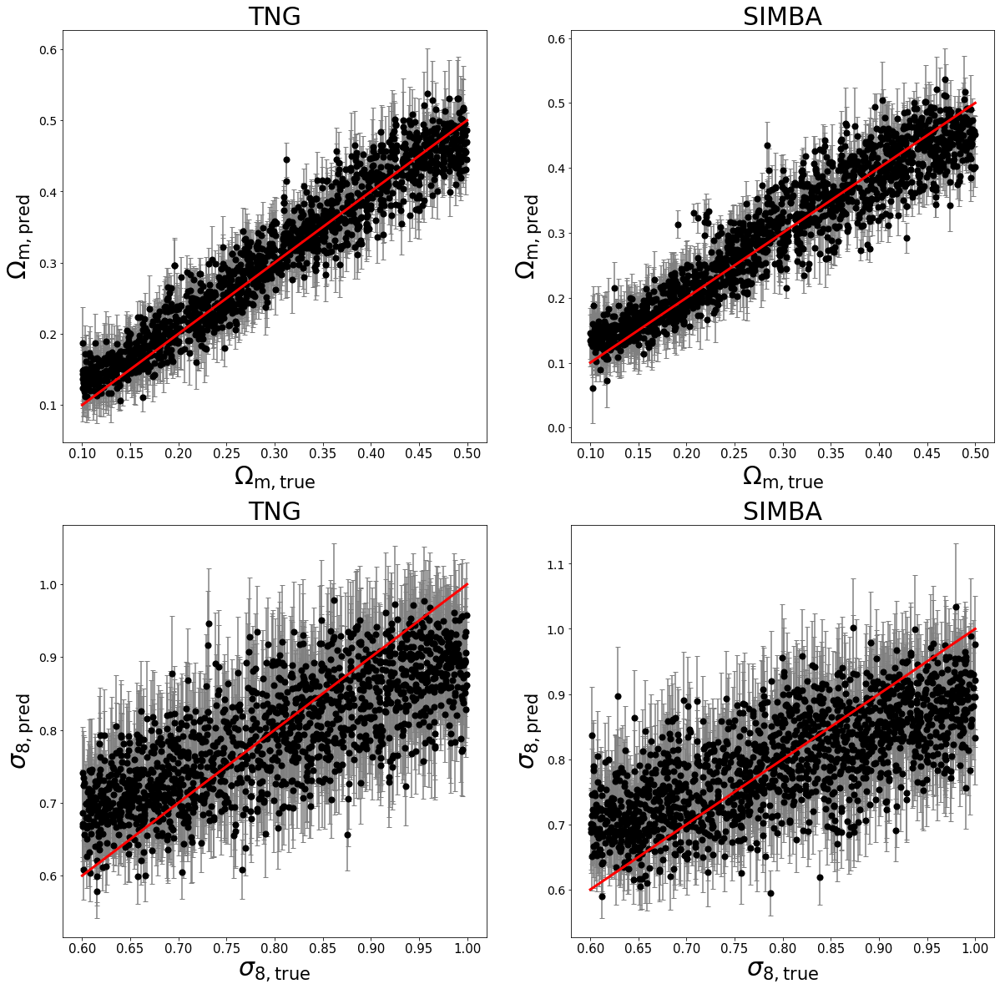

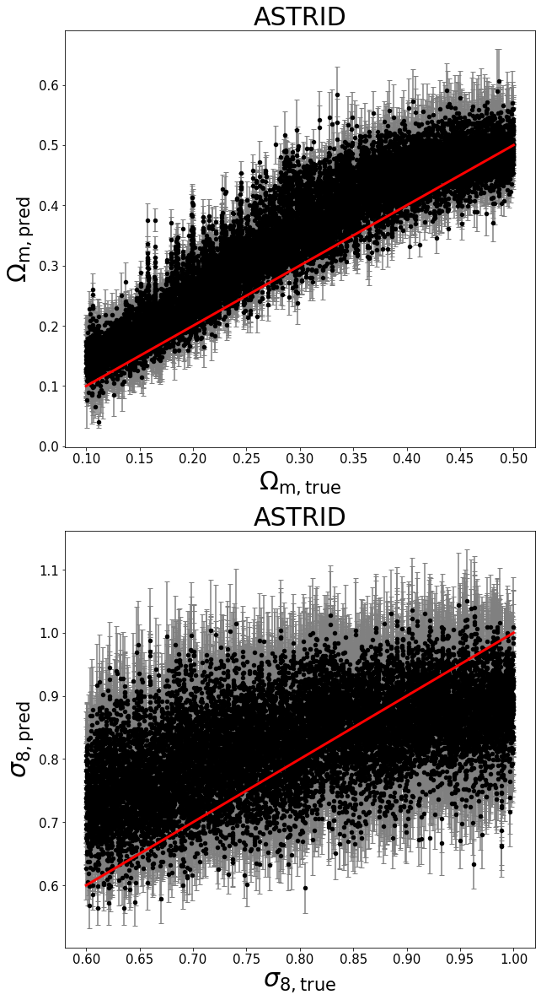

In [9]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_high_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
plt.savefig("img/HI_cnn_mid_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('ASTRID', show_score=True)
plt.savefig("img/HI_cnn_mid_ASTRID.png",dpi=200, bbox_inches='tight')

$\Omega_m$: MSE=0.001, % error=10.068%, R2 score=0.914,chi2=1.720, bias=-0.035
$\sigma_8$: MSE=0.006, % error=8.049%, R2 score=0.560,chi2=1.478, bias=-0.005
$\Omega_m$: MSE=0.008, % error=23.984%, R2 score=0.421,chi2=15.406, bias=0.010
$\sigma_8$: MSE=0.012, % error=11.167%, R2 score=0.133,chi2=2.708, bias=-0.035


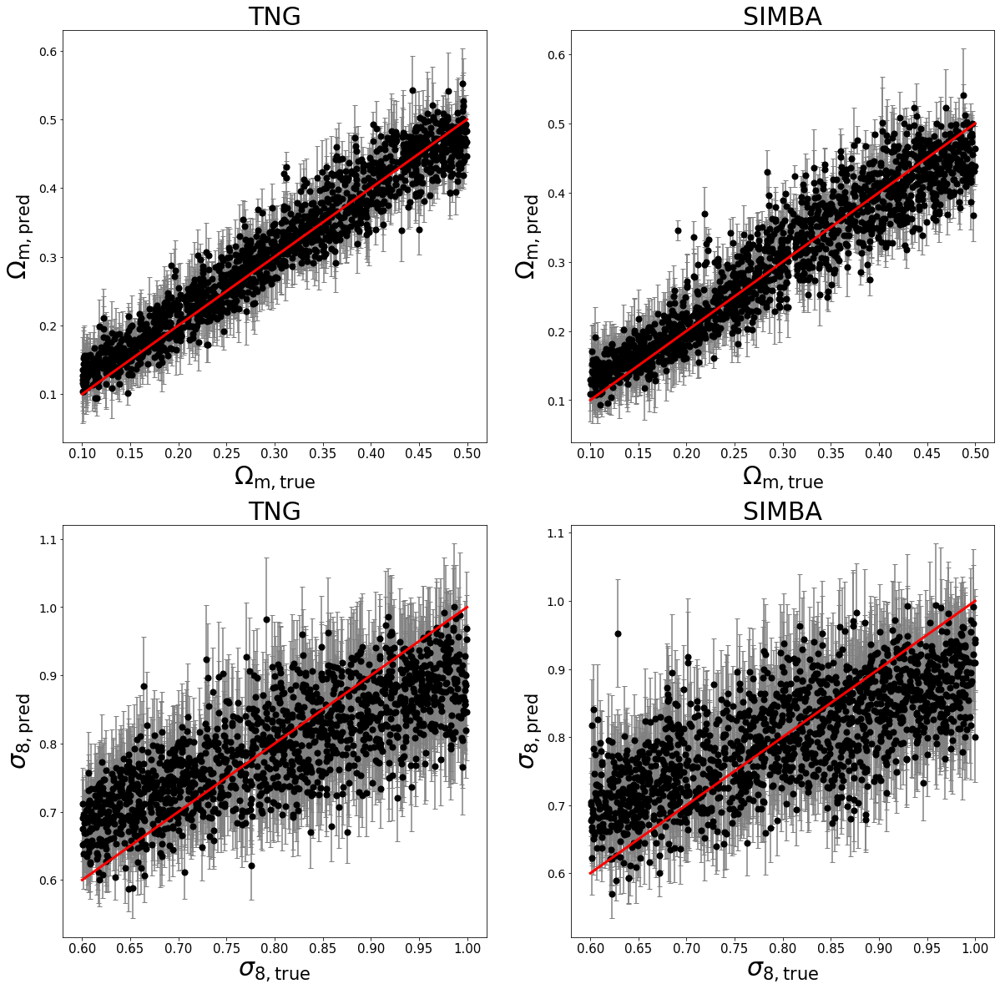

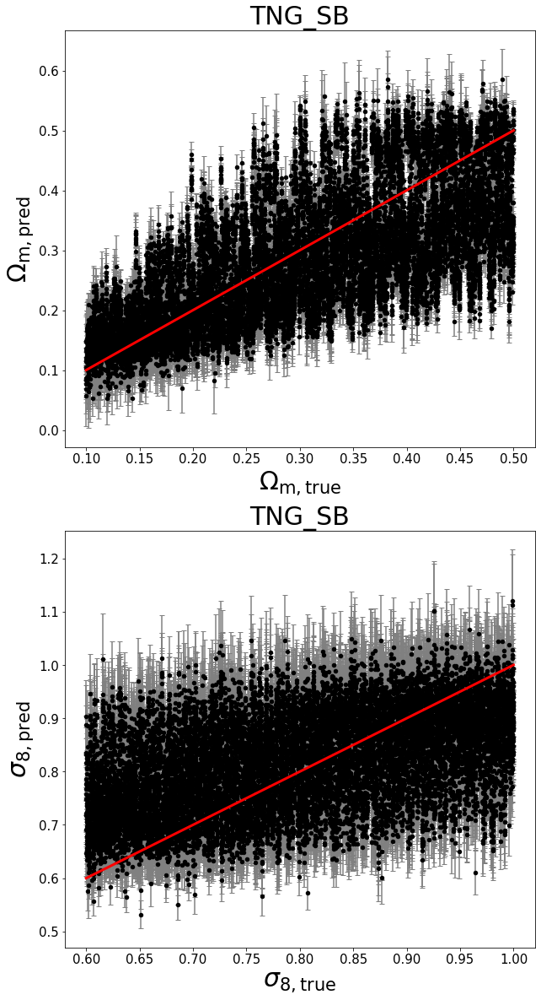

In [5]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_HI_cnn_enc_dec_high_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
#plt.savefig("img/HI_cnn_mid_TNG_SIMBA.png",dpi=200, bbox_inches='tight')
mist.test_on_cnn('TNG_SB', show_score=True)
#plt.savefig("img/HI_cnn_mid_ASTRID.png",dpi=200, bbox_inches='tight')

## WPH

$\Omega_m$: MSE=0.002, % error=10.973%, R2 score=0.886,chi2=0.964, bias=-0.041
$\sigma_8$: MSE=0.004, % error=6.664%, R2 score=0.685,chi2=1.064, bias=-0.007
The ROC AUC score for classification is 0.9886179141977298.

(15000, 2)
$\Omega_m$: MSE=0.004, % error=21.565%, R2 score=0.694,chi2=2.203, bias=-0.153
$\sigma_8$: MSE=0.012, % error=10.670%, R2 score=0.090,chi2=3.219, bias=0.044


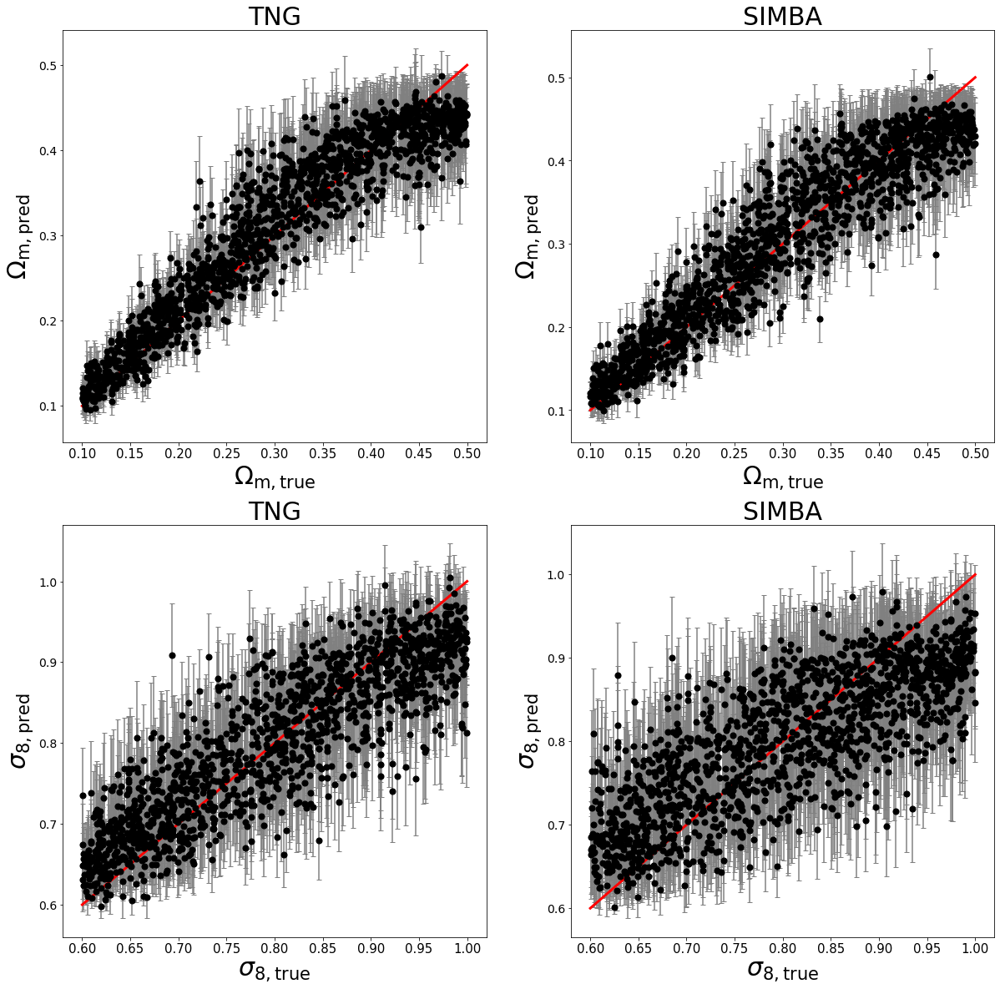

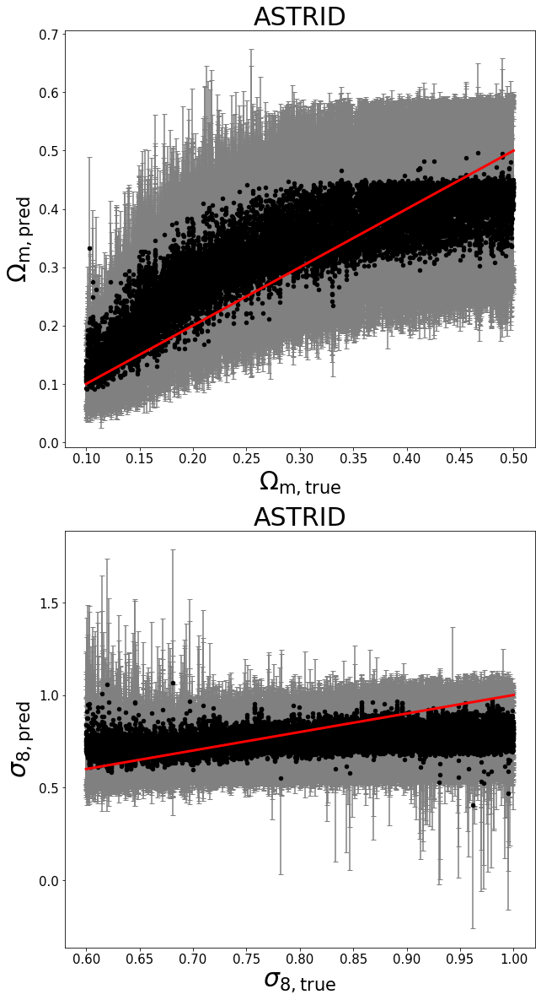

In [10]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_zero"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=False,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.002, % error=10.105%, R2 score=0.883,chi2=78.840, bias=0.022
$\sigma_8$: MSE=0.004, % error=6.610%, R2 score=0.689,chi2=1.100, bias=-0.011
The ROC AUC score for classification is 0.9791145179041922.

(15000, 2)
$\Omega_m$: MSE=0.004, % error=19.399%, R2 score=0.684,chi2=52.190, bias=-0.086
$\sigma_8$: MSE=0.015, % error=11.329%, R2 score=-0.141,chi2=4.678, bias=0.073


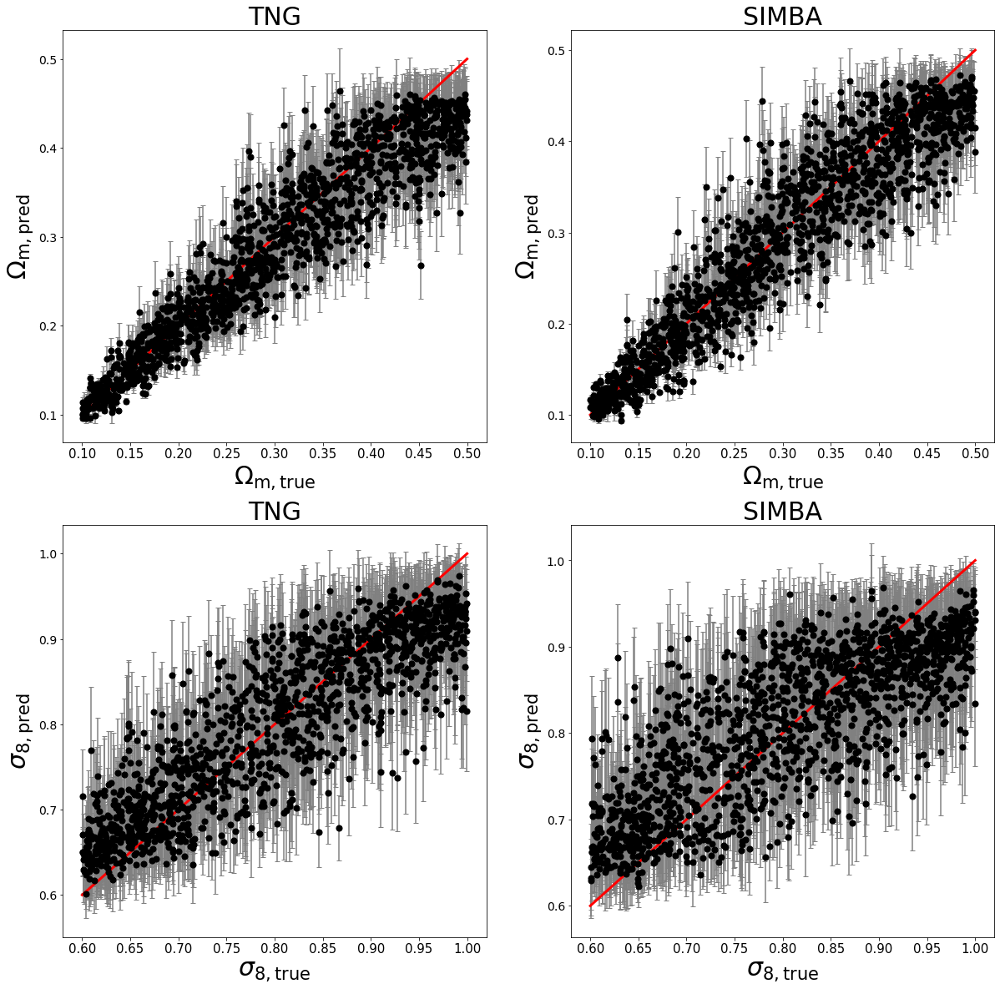

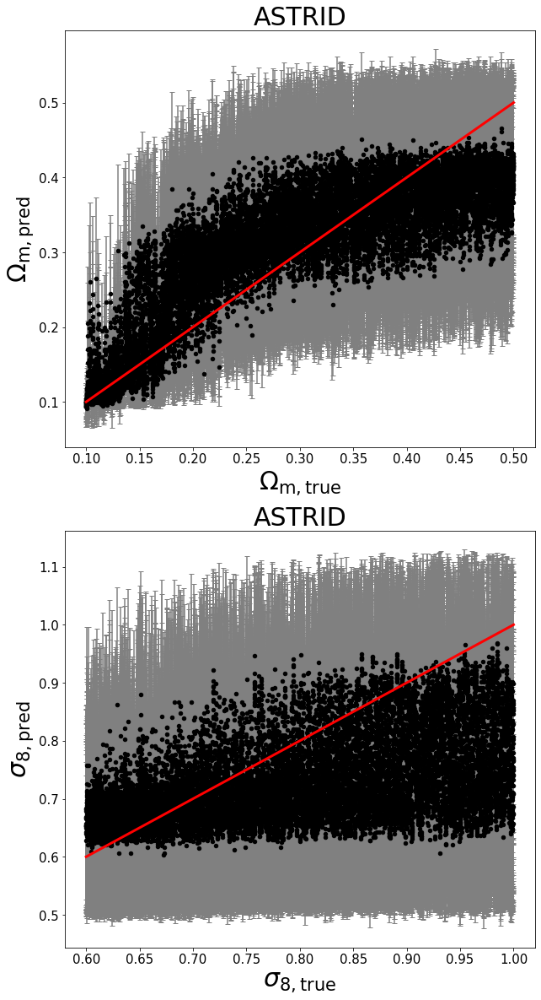

In [23]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_mid"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=False,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

In [14]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_zero"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=True,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
#mist.get_score()
#mist.make_plots(fname='cnn_test', save_plot=False)
#mist.test_on('ASTRID', show_score=True)

fe=0.12103493059333001, fd=0.13172763410379124, z dim=54


In [16]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_mid"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=True,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
#mist.get_score()
#mist.make_plots(fname='cnn_test', save_plot=False)
#mist.test_on('ASTRID', show_score=True)

fe=0.03936145035963189, fd=0.36079131363727485, z dim=354


In [17]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_high"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=True,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
#mist.get_score()
#mist.make_plots(fname='cnn_test', save_plot=False)
#mist.test_on('ASTRID', show_score=True)

fe=0.19940904589614744, fd=0.17986498078775714, z dim=188


In [18]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_high2"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=True,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
#mist.get_score()
#mist.make_plots(fname='cnn_test', save_plot=False)
#mist.test_on('ASTRID', show_score=True)

fe=0.13322009385019645, fd=0.8990765623132431, z dim=243


fe=0.14108807054375574, fd=0.1379937009007177, z dim=1517
$\Omega_m$: MSE=0.000, % error=4.878%, R2 score=0.974,chi2=101.346, bias=-0.014
$\sigma_8$: MSE=0.002, % error=4.181%, R2 score=0.851,chi2=1.784, bias=0.017
The ROC AUC score for classification is 0.6084858485848585.

(1000, 2)
$\Omega_m$: MSE=0.005, % error=21.067%, R2 score=0.640,chi2=670.857, bias=-0.200
$\sigma_8$: MSE=0.026, % error=15.885%, R2 score=-0.985,chi2=36.643, bias=0.152


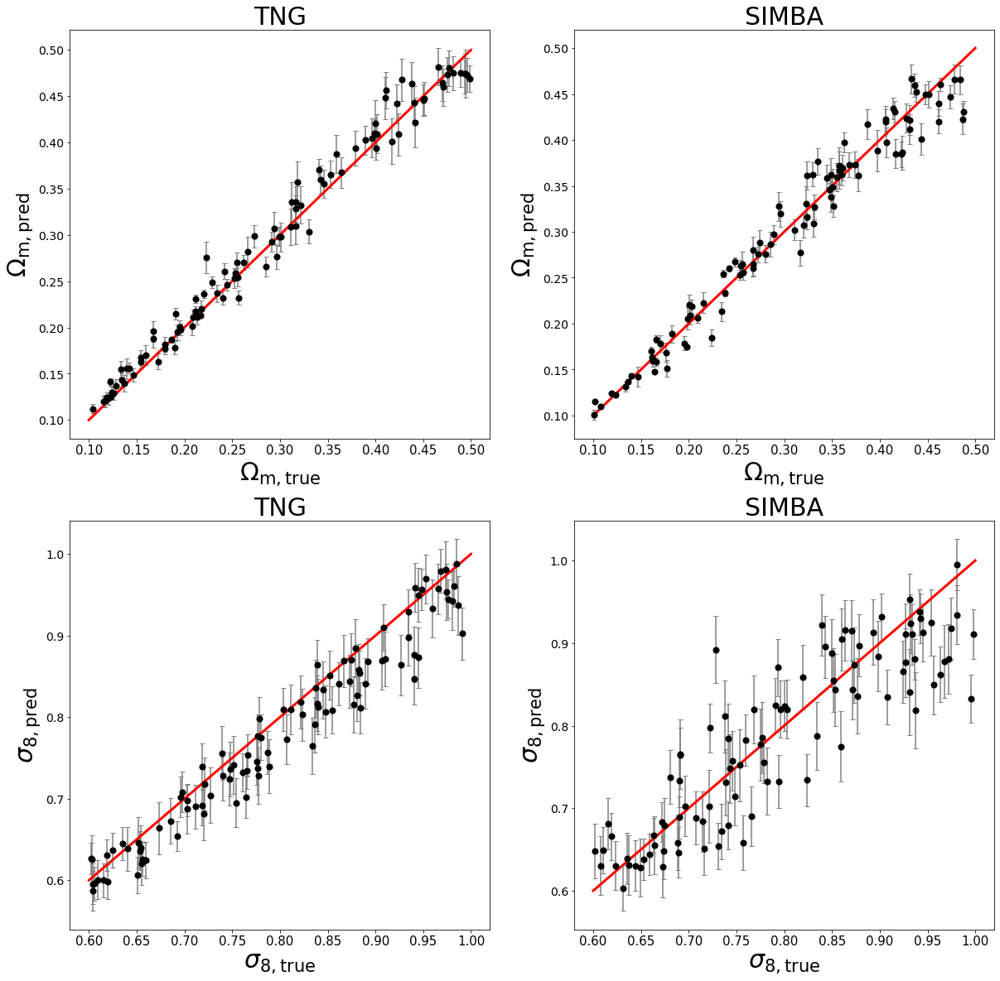

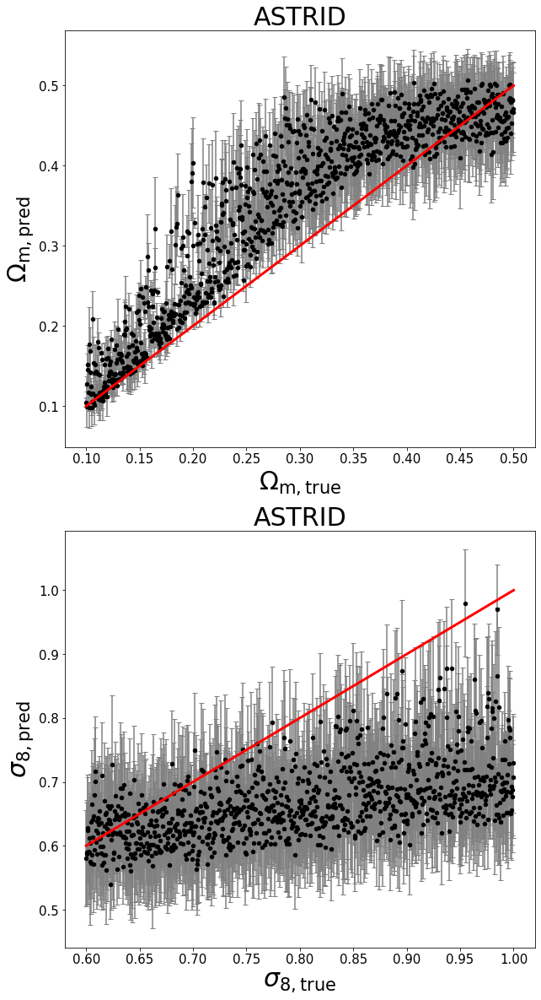

In [11]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_mid_new_mu_dn_0"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=True,
            device=device,
            L=4, dn=0, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

fe=0.011956528648039831, fd=0.2802788721092275, z dim=136
$\Omega_m$: MSE=0.000, % error=4.455%, R2 score=0.977,chi2=2.805, bias=-0.013
$\sigma_8$: MSE=0.002, % error=3.849%, R2 score=0.871,chi2=1.593, bias=-0.007
The ROC AUC score for classification is 0.9893239323932392.

(1000, 2)
$\Omega_m$: MSE=0.012, % error=30.566%, R2 score=0.124,chi2=5795.154, bias=-0.301
$\sigma_8$: MSE=0.061, % error=22.437%, R2 score=-3.594,chi2=72084974.761, bias=0.217


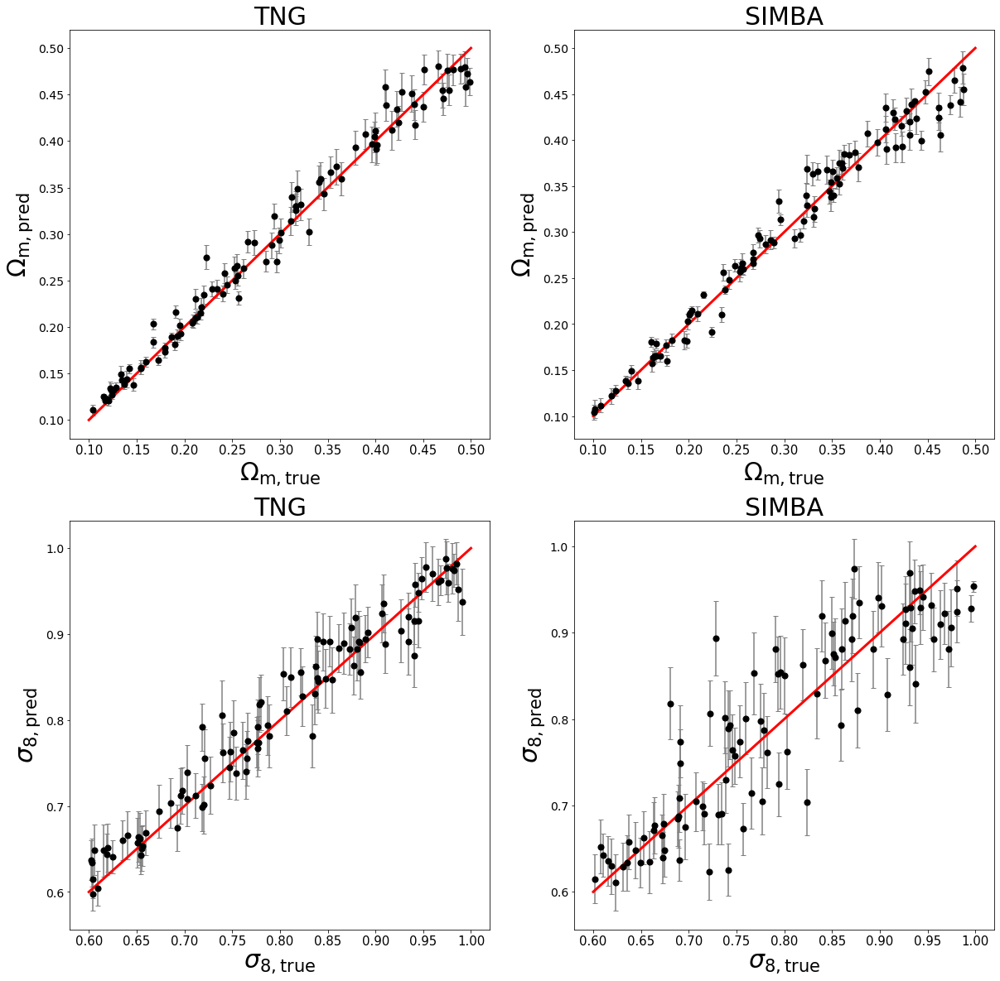

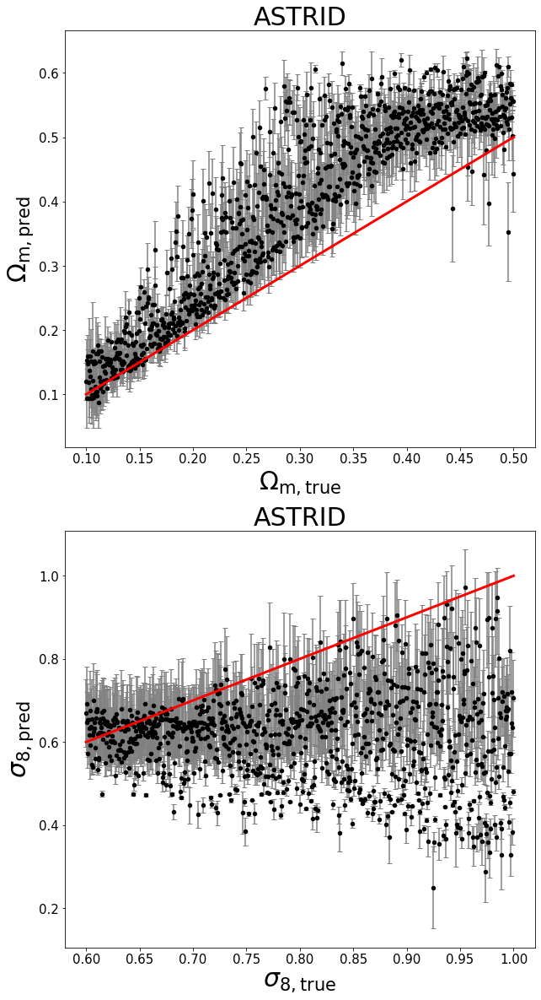

In [12]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_high_new_mu_dn_0"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=True,
            device=device,
            L=4, dn=0, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.000, % error=5.383%, R2 score=0.968,chi2=3.076, bias=-0.020
$\sigma_8$: MSE=0.002, % error=3.629%, R2 score=0.883,chi2=1.172, bias=-0.003
The ROC AUC score for classification is 0.5064756475647565.

(1000, 2)
$\Omega_m$: MSE=0.007, % error=25.777%, R2 score=0.467,chi2=10071.815, bias=-0.254
$\sigma_8$: MSE=0.035, % error=18.465%, R2 score=-1.593,chi2=215.012, bias=0.183


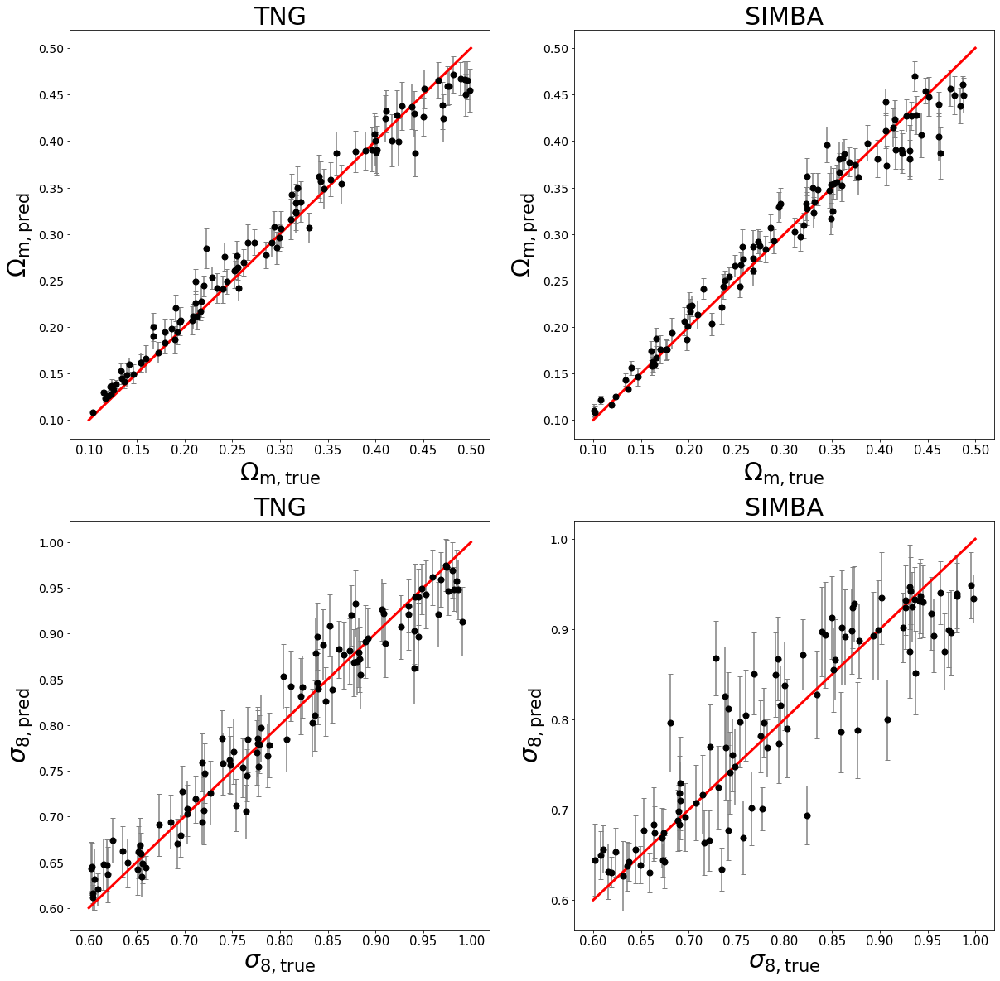

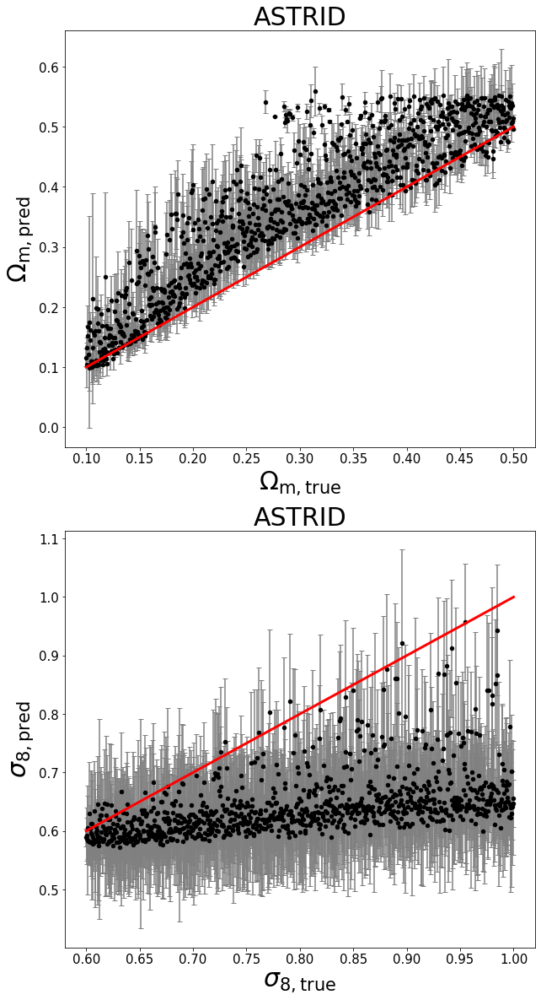

In [5]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_high2_new_mu_dn_0"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=True,
            device=device,
            L=4, dn=0, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.000, % error=5.162%, R2 score=0.962,chi2=23.646, bias=0.012
$\sigma_8$: MSE=0.002, % error=4.224%, R2 score=0.856,chi2=1.194, bias=-0.001
The ROC AUC score for classification is 0.4878737873787379.

(1000, 2)
$\Omega_m$: MSE=0.004, % error=19.275%, R2 score=0.673,chi2=17.996, bias=-0.187
$\sigma_8$: MSE=0.033, % error=17.399%, R2 score=-1.476,chi2=48.394, bias=0.168


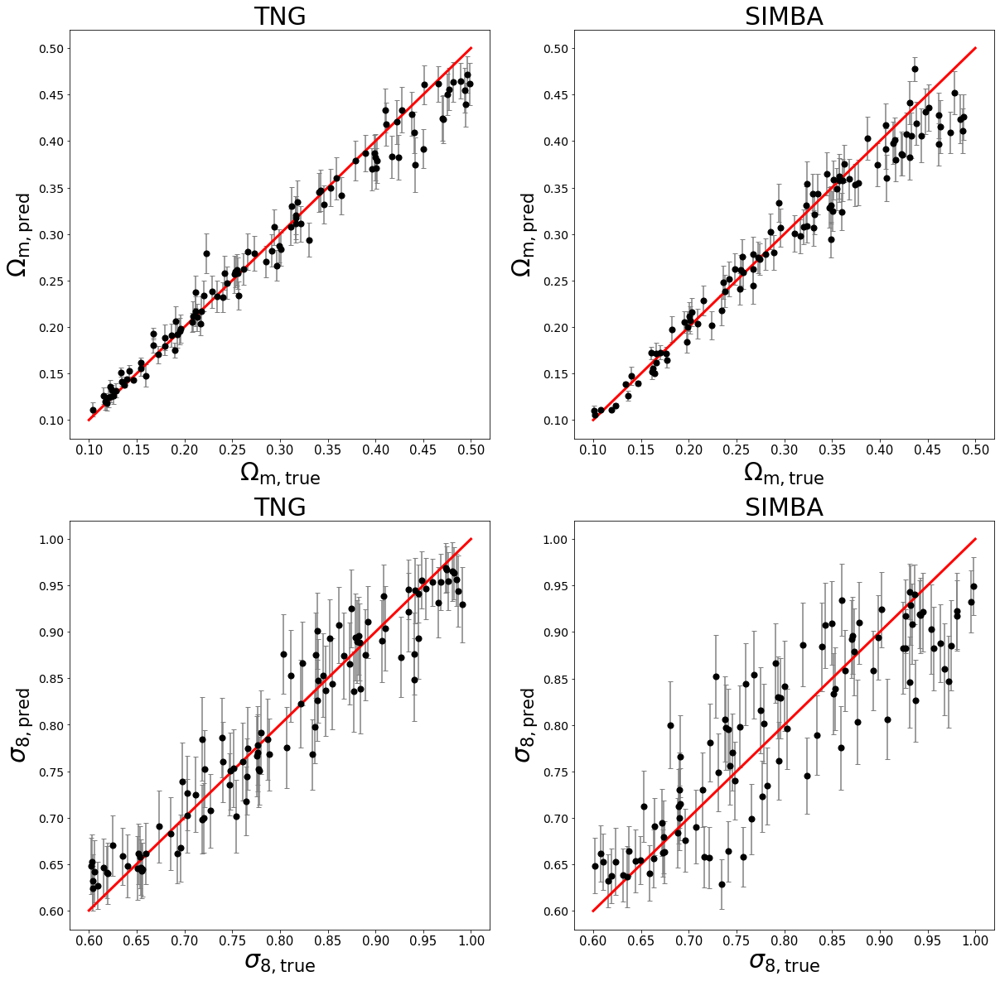

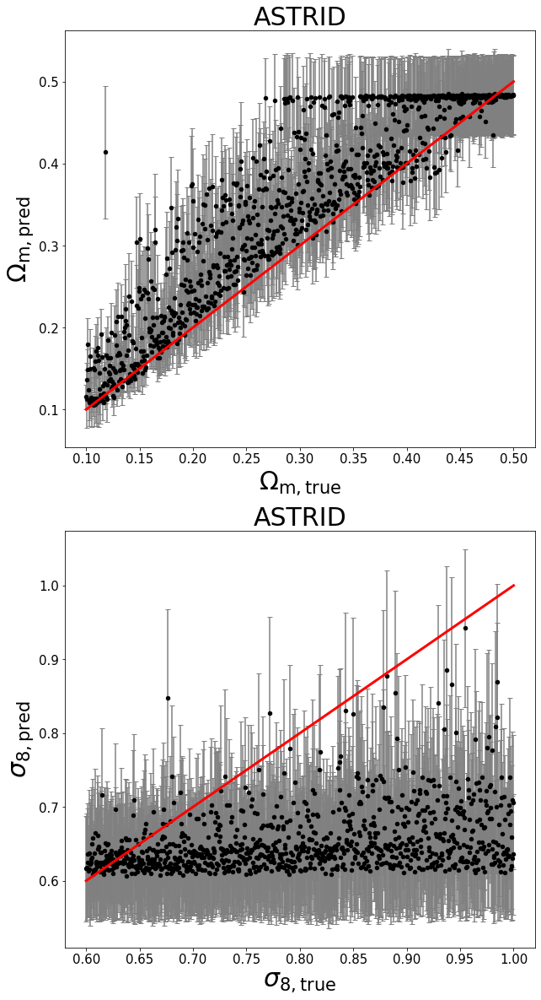

In [6]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_high3_new_mu_dn_0"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=True,
            device=device,
            L=4, dn=0, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.013, % error=43.229%, R2 score=-0.000,chi2=1.023, bias=-0.197
$\sigma_8$: MSE=0.013, % error=12.964%, R2 score=-0.000,chi2=1.008, bias=-0.023
The ROC AUC score for classification is 0.49199919991999197.

(1000, 2)
$\Omega_m$: MSE=0.013, % error=43.281%, R2 score=-0.002,chi2=1.054, bias=-0.184
$\sigma_8$: MSE=0.013, % error=12.885%, R2 score=-0.000,chi2=1.013, bias=-0.020


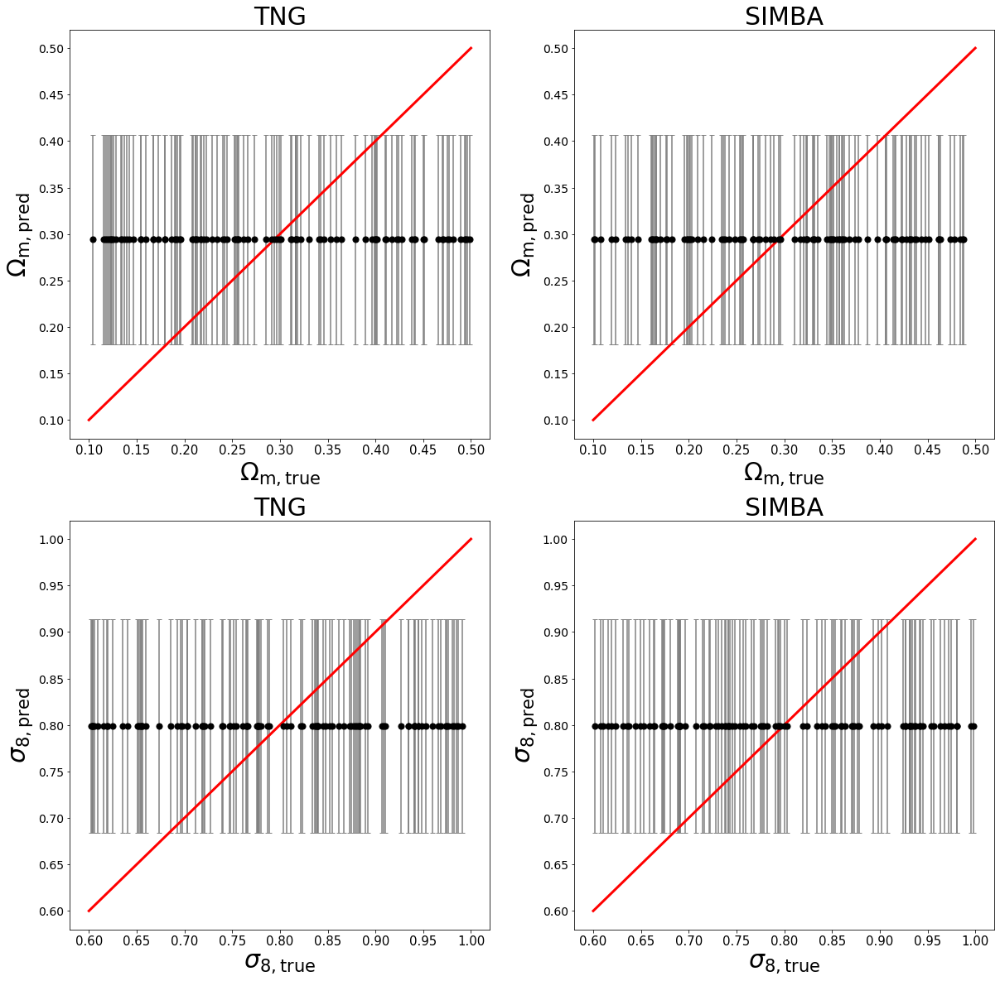

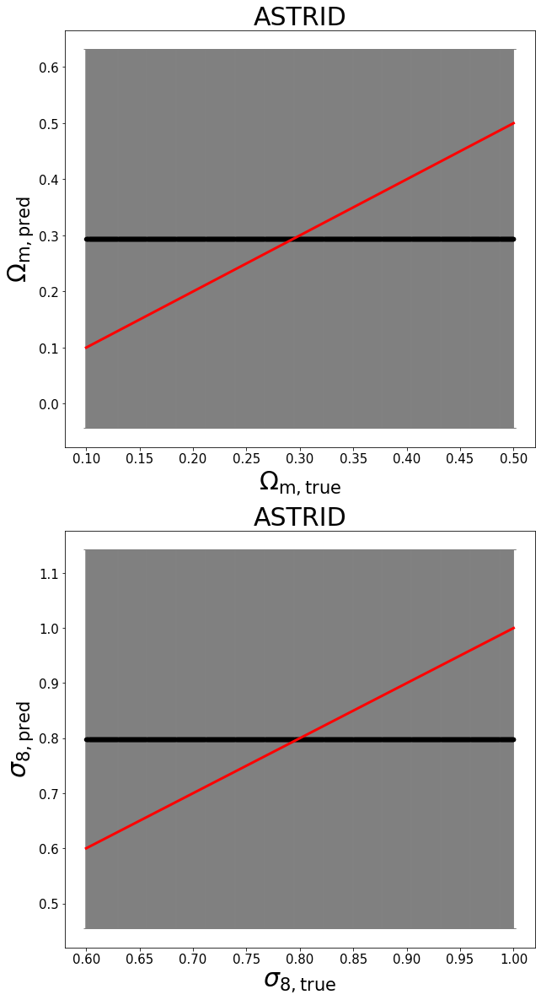

In [9]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_extrm_new_mu_dn_0"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=True,
            device=device,
            L=4, dn=0, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.000, % error=5.175%, R2 score=0.964,chi2=9991.436, bias=-0.004
$\sigma_8$: MSE=0.003, % error=5.051%, R2 score=0.775,chi2=3.173, bias=-0.022
The ROC AUC score for classification is 0.3157065706570657.

(1000, 2)
$\Omega_m$: MSE=0.004, % error=19.333%, R2 score=0.670,chi2=509.464, bias=-0.191
$\sigma_8$: MSE=0.026, % error=15.611%, R2 score=-0.945,chi2=96.707, bias=0.146


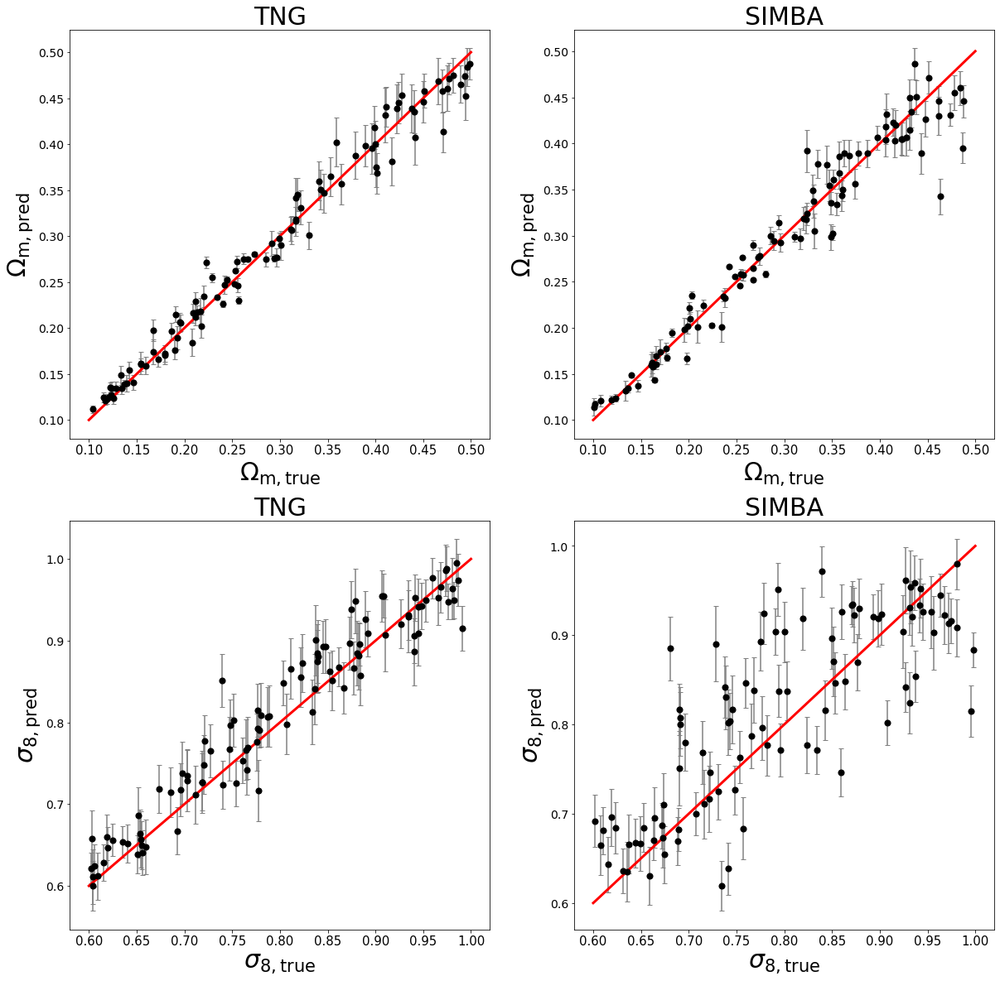

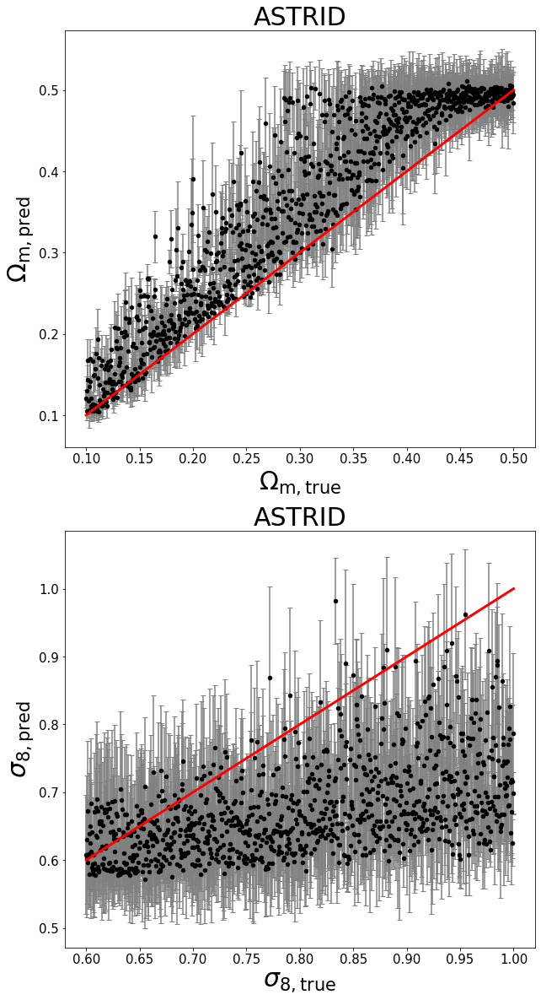

In [6]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_high_new_mu_dn_0"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=True,
            device=device,
            L=4, dn=0, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=99, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.000, % error=5.574%, R2 score=0.968,chi2=0.925, bias=0.017
$\sigma_8$: MSE=0.002, % error=4.137%, R2 score=0.862,chi2=1.240, bias=-0.008
The ROC AUC score for classification is 0.30333033303330337.

(1000, 2)
$\Omega_m$: MSE=0.005, % error=20.663%, R2 score=0.621,chi2=8.797, bias=-0.195
$\sigma_8$: MSE=0.021, % error=13.540%, R2 score=-0.605,chi2=17.473, bias=0.123


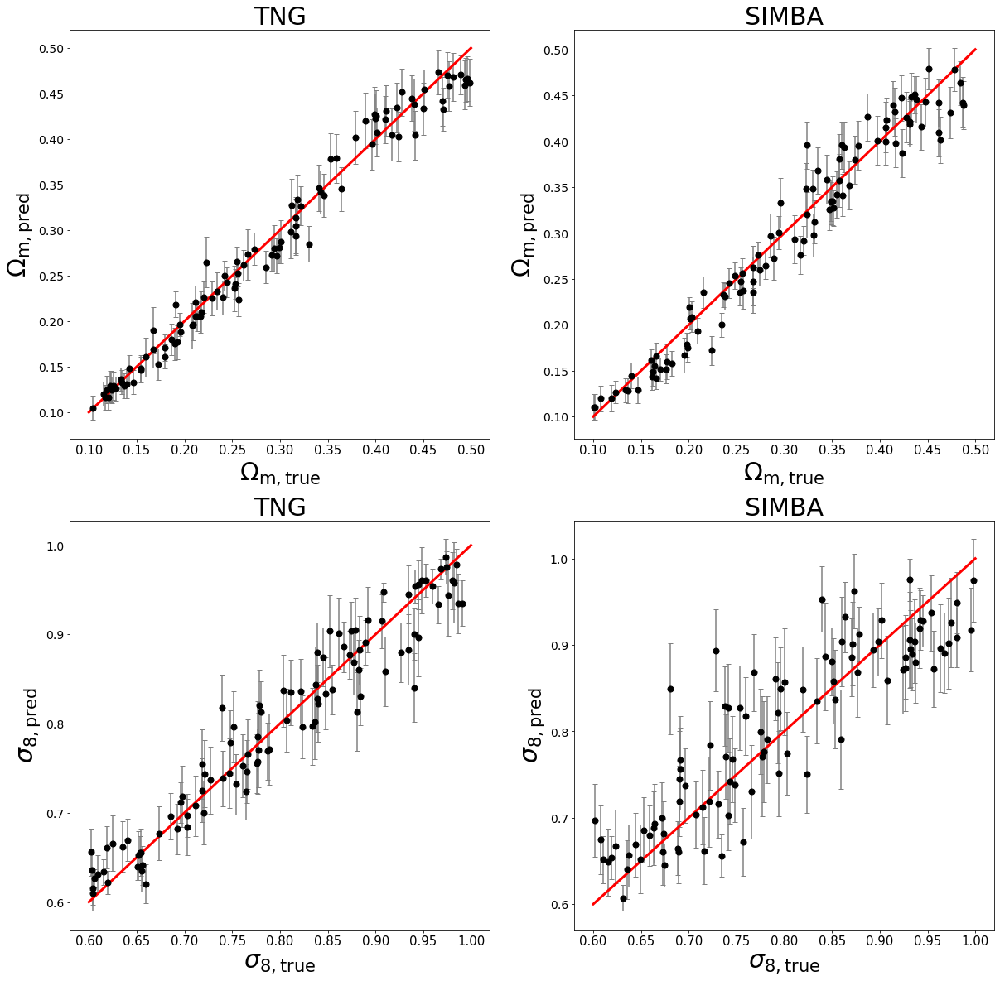

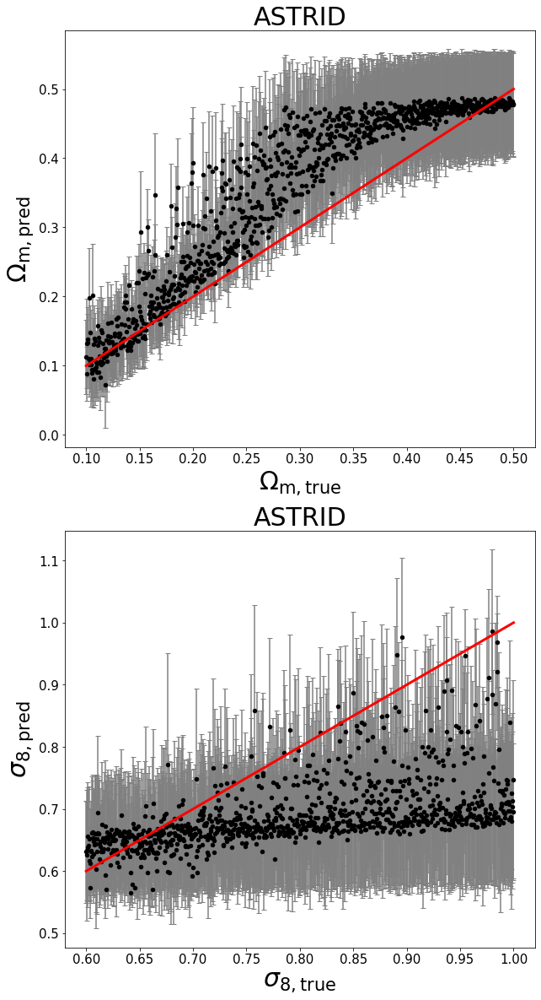

In [5]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_mid_new_mu_dn_0"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=True,
            device=device,
            L=4, dn=0, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=99, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.000, % error=5.185%, R2 score=0.967,chi2=2.931, bias=0.009
$\sigma_8$: MSE=0.002, % error=3.920%, R2 score=0.879,chi2=6.624, bias=-0.003
The ROC AUC score for classification is 0.5.

(1000, 2)
$\Omega_m$: MSE=0.015, % error=31.296%, R2 score=-0.104,chi2=22903596.200, bias=-0.309
$\sigma_8$: MSE=0.018, % error=12.495%, R2 score=-0.363,chi2=239014.492, bias=0.095


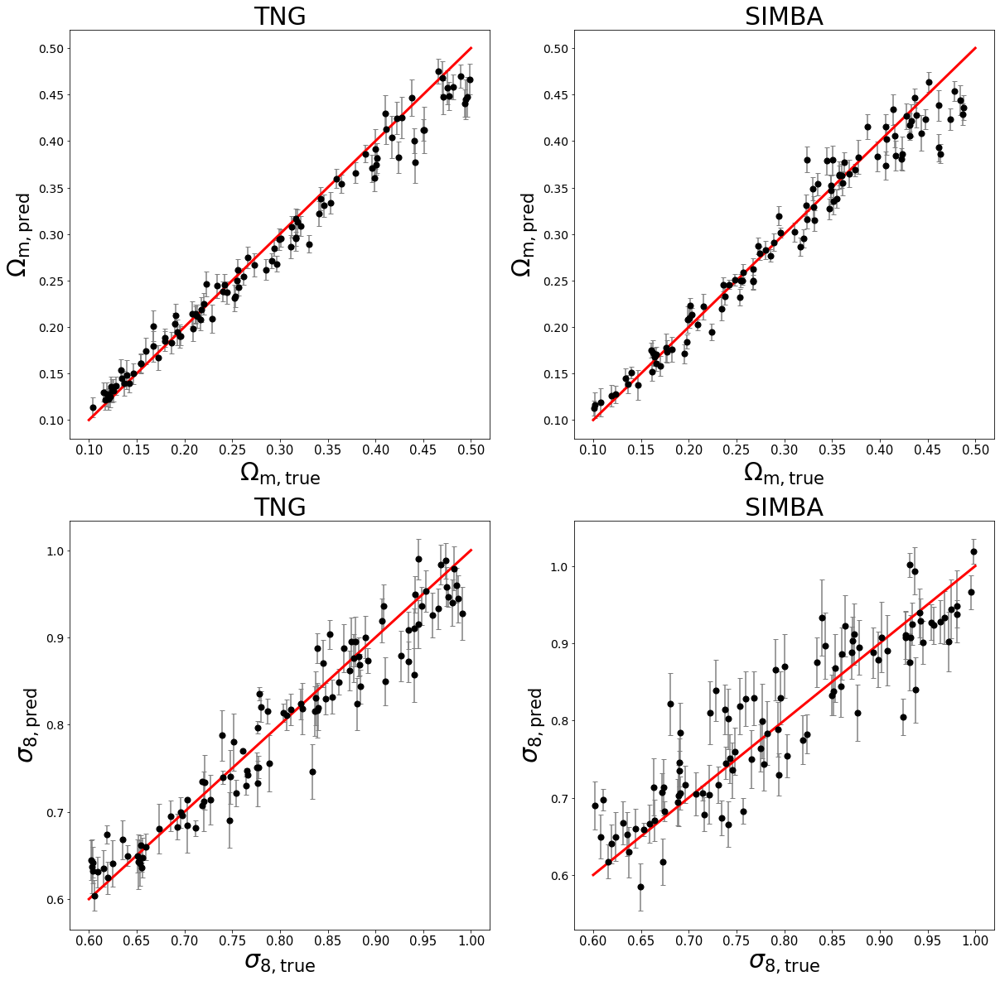

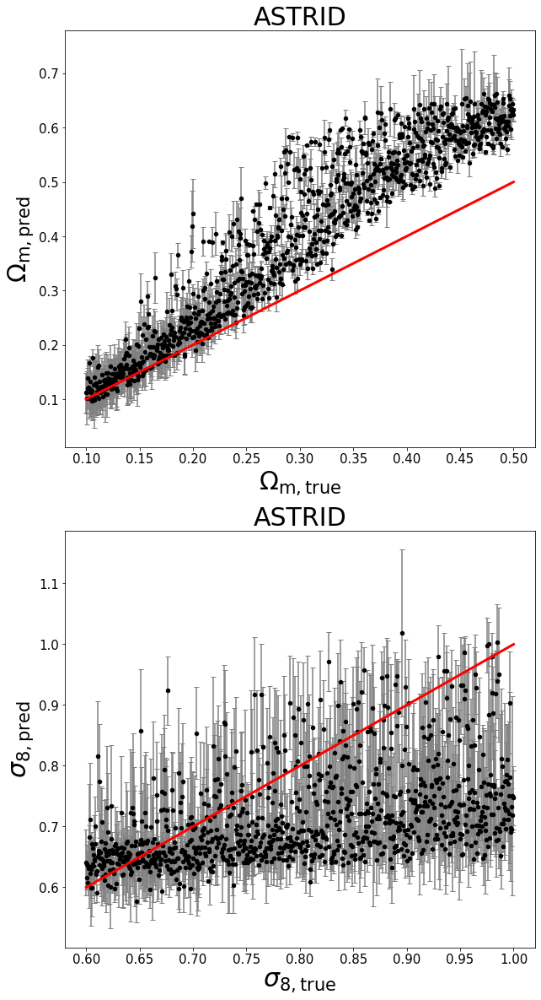

In [14]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_mid_new_mu"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = False,
            projection=False,
            average=True,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=99, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.001, % error=5.169%, R2 score=0.957,chi2=43.296, bias=0.028
$\sigma_8$: MSE=0.002, % error=4.840%, R2 score=0.821,chi2=13.180, bias=-0.025
The ROC AUC score for classification is 0.5458295829582958.

(1000, 2)
$\Omega_m$: MSE=0.008, % error=25.619%, R2 score=0.433,chi2=17713.197, bias=-0.252
$\sigma_8$: MSE=0.029, % error=16.607%, R2 score=-1.180,chi2=203.777, bias=0.142


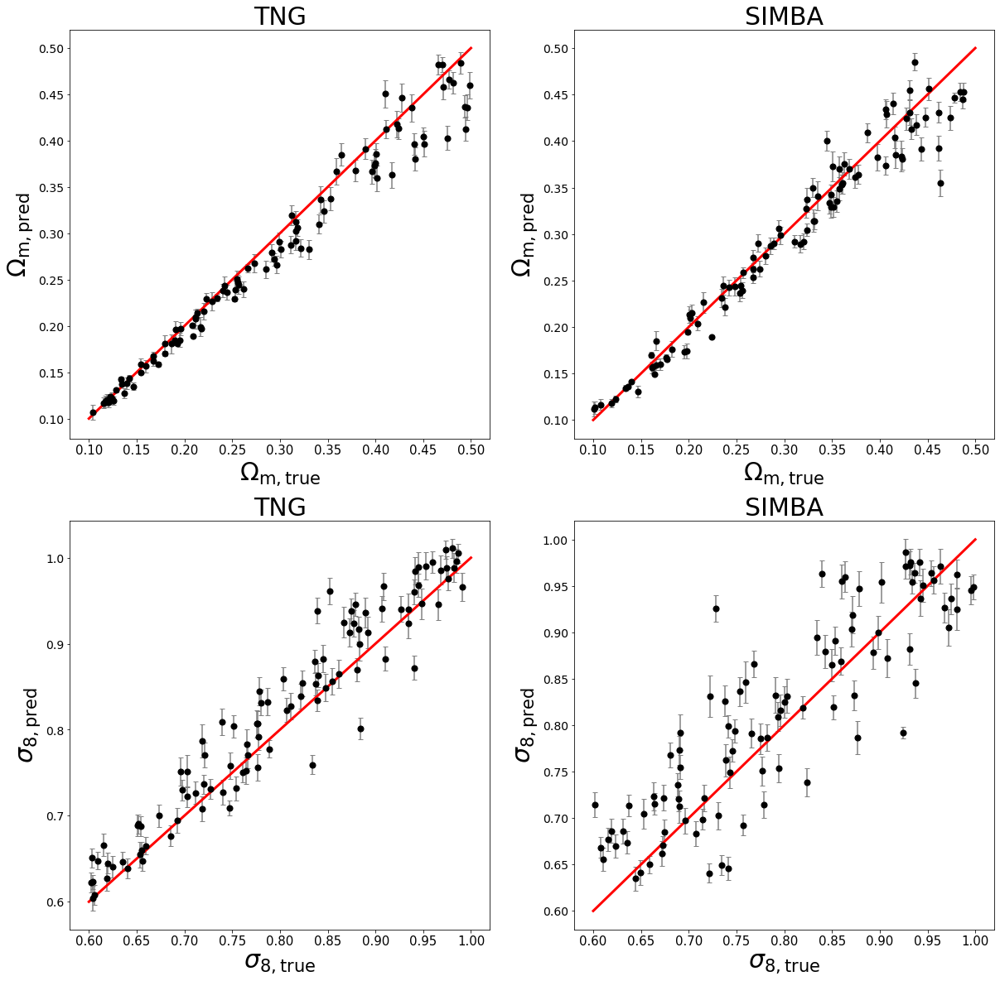

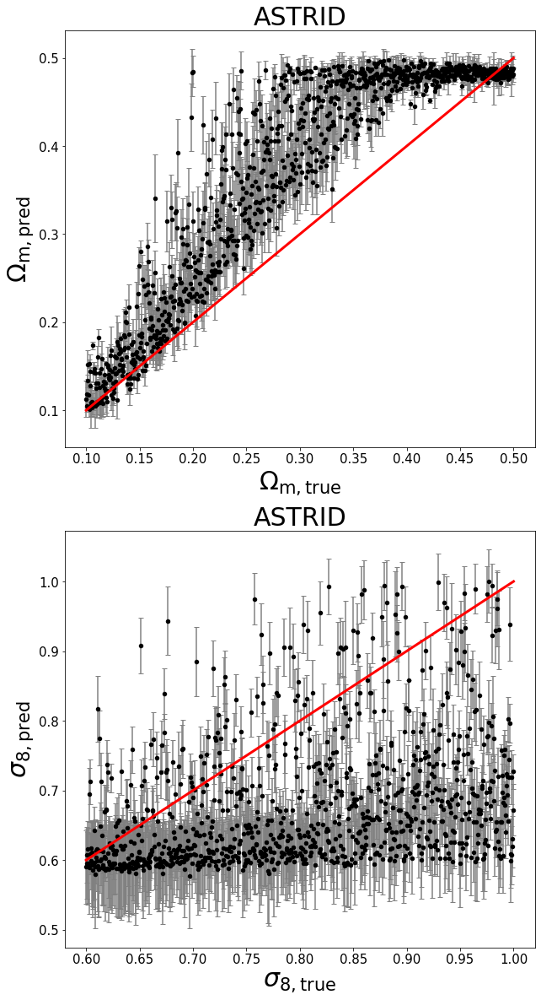

In [15]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_high_new_mu"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = False,
            projection=False,
            average=True,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=99, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.000, % error=5.108%, R2 score=0.968,chi2=20671.712, bias=-0.016
$\sigma_8$: MSE=0.002, % error=4.494%, R2 score=0.843,chi2=3587.284, bias=-0.005
The ROC AUC score for classification is 0.9934493449344934.

(1000, 2)
$\Omega_m$: MSE=0.008, % error=26.311%, R2 score=0.410,chi2=74268.776, bias=-0.261
$\sigma_8$: MSE=0.015, % error=11.743%, R2 score=-0.096,chi2=64775.970, bias=0.047


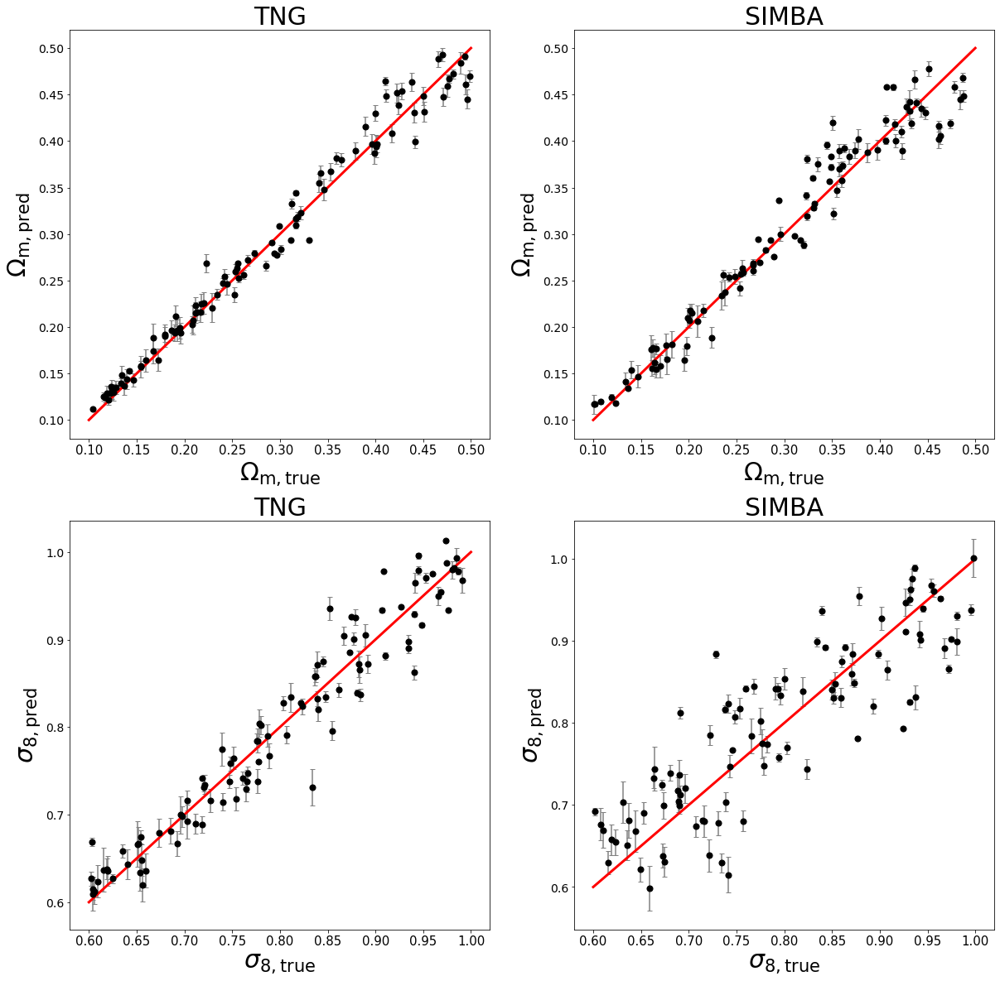

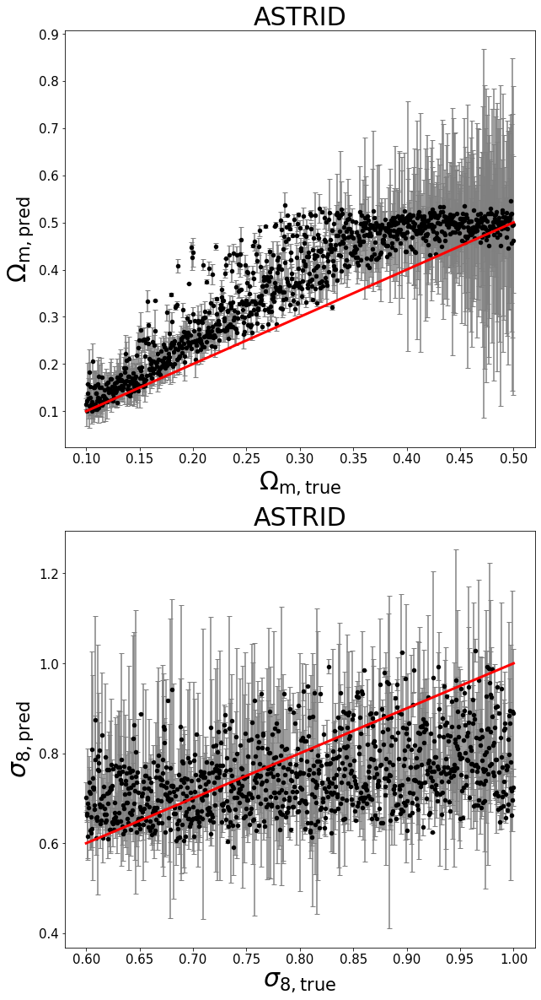

In [17]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_zero_new"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = False,
            projection=False,
            average=True,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=99, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.000, % error=4.692%, R2 score=0.967,chi2=3.239, bias=0.015
$\sigma_8$: MSE=0.002, % error=4.110%, R2 score=0.867,chi2=865.804, bias=-0.018
The ROC AUC score for classification is 0.3058055805580558.

(1000, 2)
$\Omega_m$: MSE=0.008, % error=24.826%, R2 score=0.432,chi2=29.519, bias=-0.239
$\sigma_8$: MSE=0.020, % error=13.789%, R2 score=-0.537,chi2=80347.255, bias=0.104


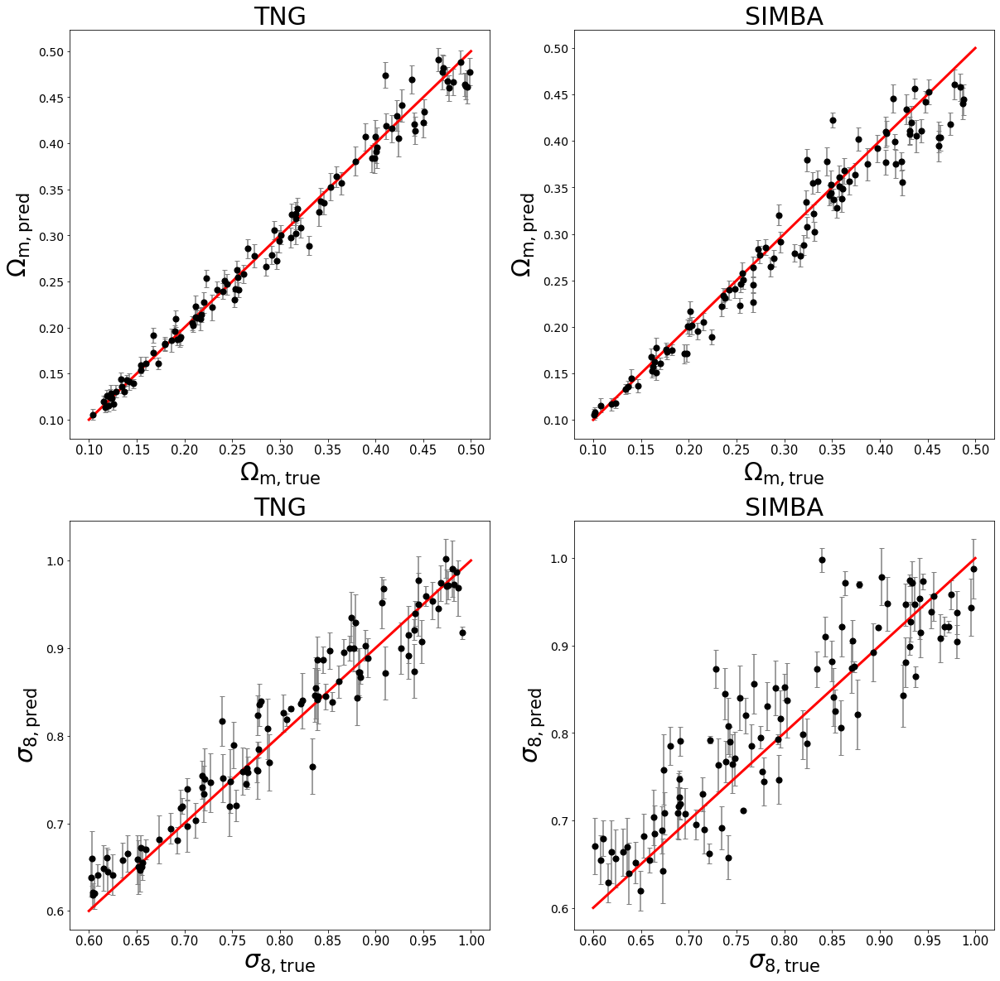

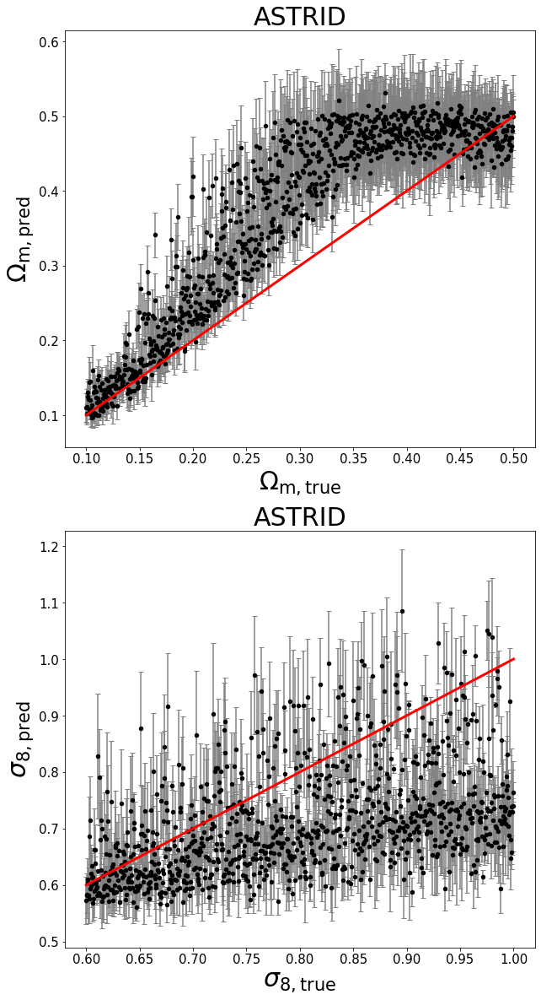

In [10]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_mid_new"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = False,
            projection=False,
            average=True,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=100, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.000, % error=4.740%, R2 score=0.973,chi2=706.983, bias=-0.011
$\sigma_8$: MSE=0.001, % error=3.697%, R2 score=0.888,chi2=77.513, bias=-0.005
The ROC AUC score for classification is 0.4215671567156716.

(1000, 2)
$\Omega_m$: MSE=0.010, % error=28.930%, R2 score=0.256,chi2=221217.233, bias=-0.288
$\sigma_8$: MSE=0.024, % error=14.491%, R2 score=-0.772,chi2=14673.764, bias=0.111


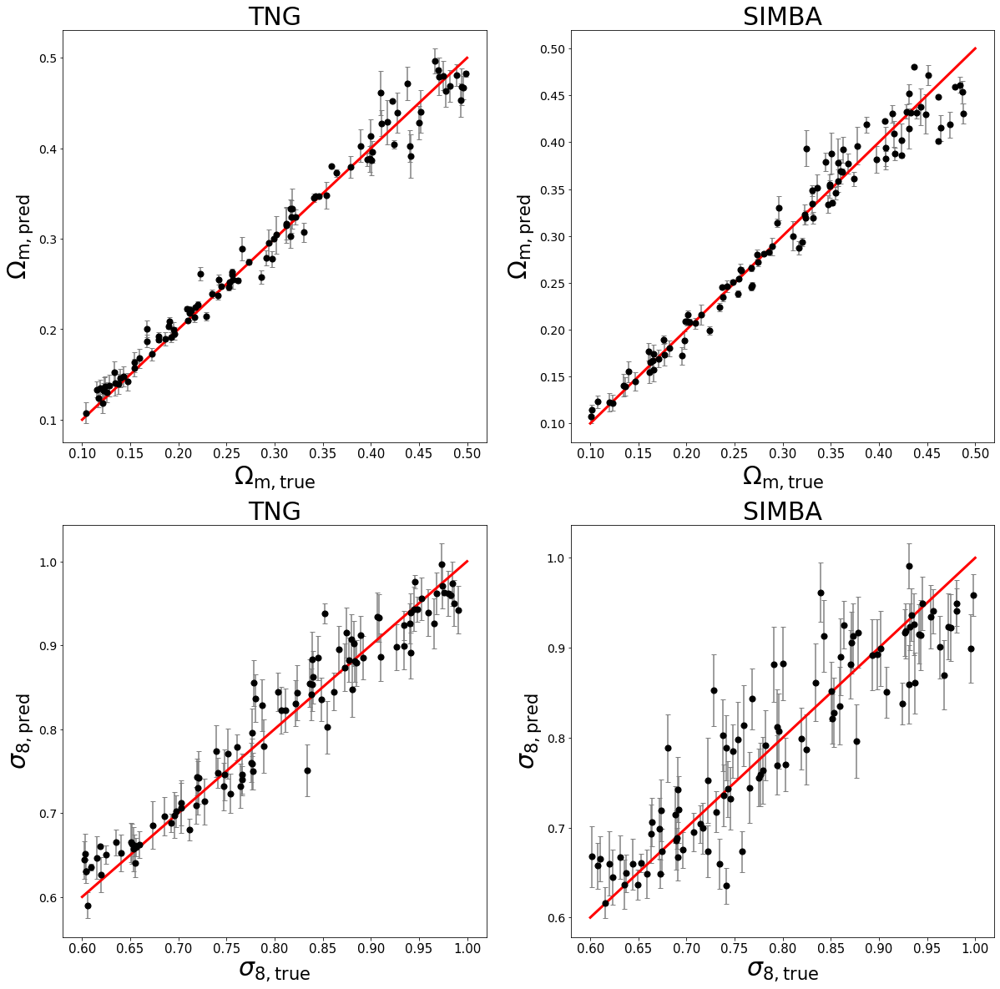

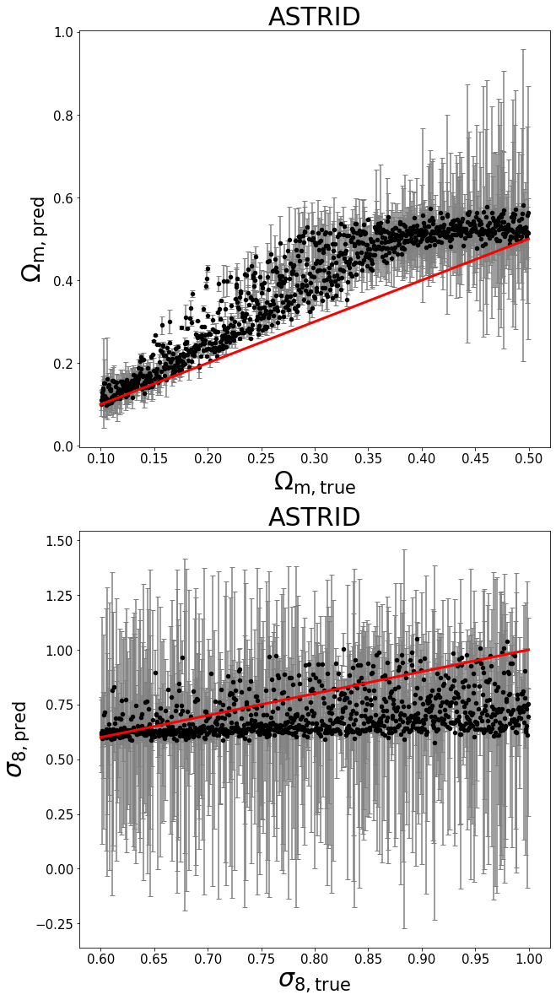

In [5]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_high_new"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = False,
            projection=False,
            average=True,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.000, % error=4.676%, R2 score=0.975,chi2=45.206, bias=-0.012
$\sigma_8$: MSE=0.002, % error=4.014%, R2 score=0.872,chi2=3.009, bias=-0.015
The ROC AUC score for classification is 0.5373287328732874.

(1000, 2)
$\Omega_m$: MSE=0.009, % error=28.485%, R2 score=0.347,chi2=677.961, bias=-0.285
$\sigma_8$: MSE=0.023, % error=14.099%, R2 score=-0.697,chi2=51.268, bias=0.113


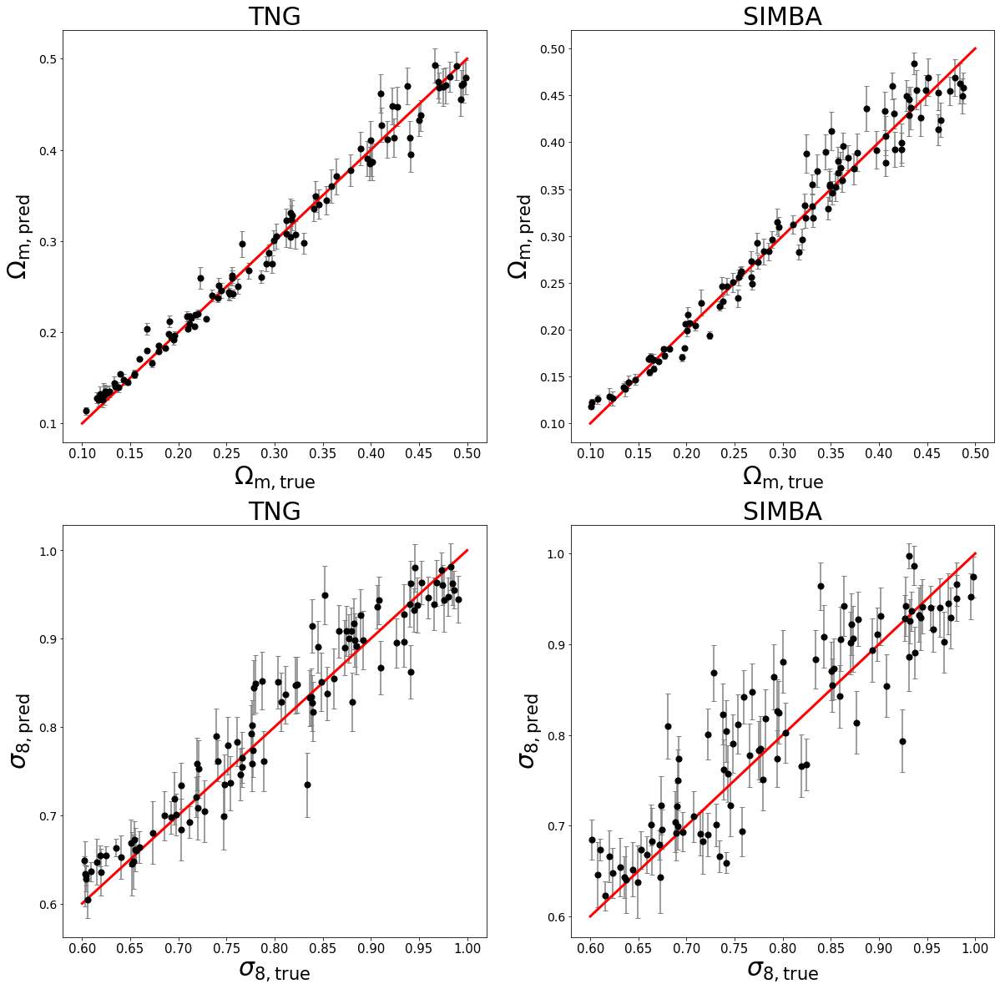

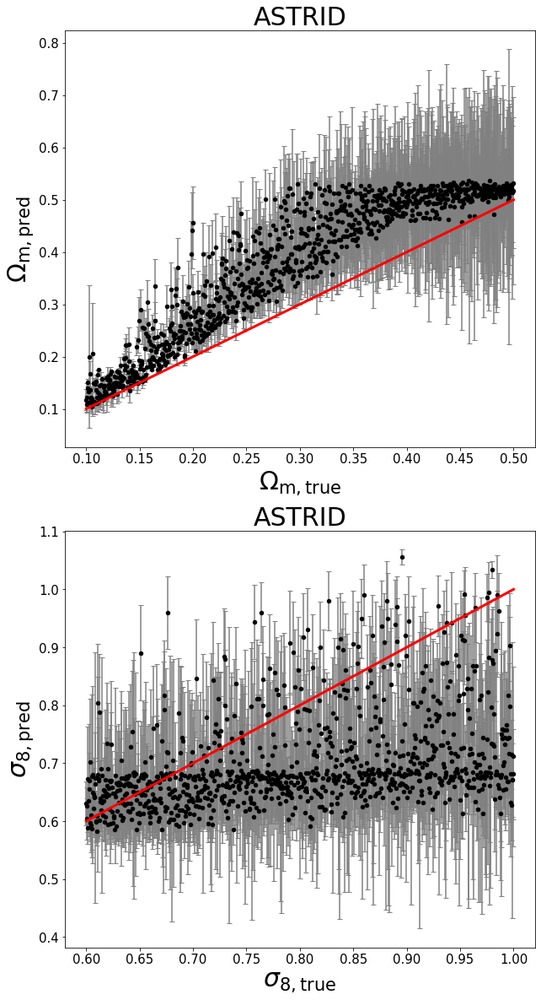

In [7]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_high2_new"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = False,
            projection=False,
            average=True,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

In [ ]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_high_new"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=False,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=100, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.001, % error=9.985%, R2 score=0.890,chi2=1.635, bias=-0.009
$\sigma_8$: MSE=0.005, % error=6.836%, R2 score=0.618,chi2=1.964, bias=0.020
The ROC AUC score for classification is 0.6019704061099933.

(15000, 2)
$\Omega_m$: MSE=0.006, % error=23.444%, R2 score=0.587,chi2=5.626, bias=-0.177
$\sigma_8$: MSE=0.012, % error=10.388%, R2 score=0.066,chi2=5.421, bias=0.059


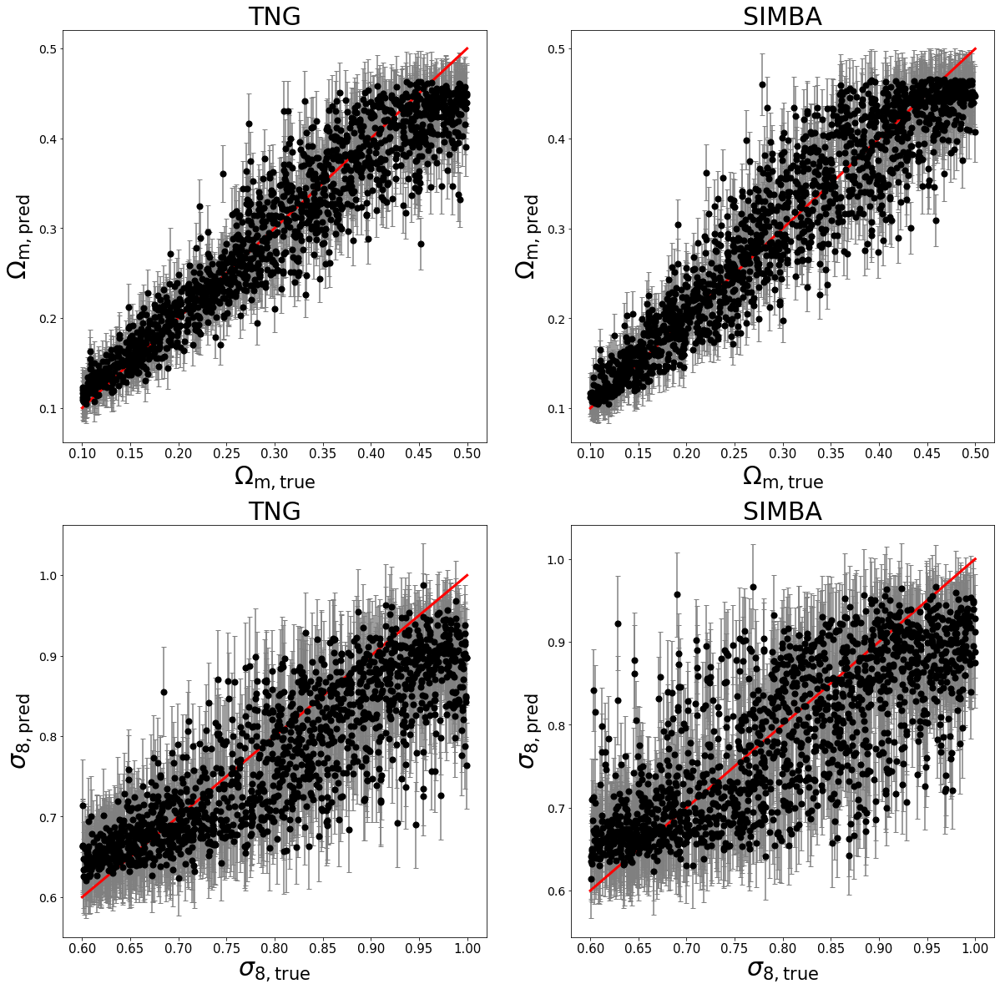

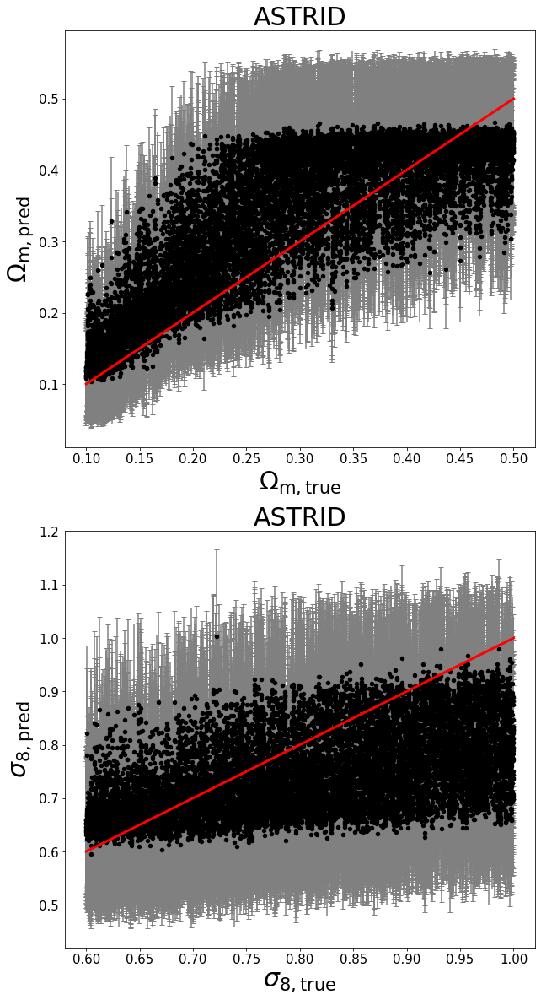

In [ ]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_high_new"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=False,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=100, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.002, % error=10.895%, R2 score=0.884,chi2=1.173, bias=-0.017
$\sigma_8$: MSE=0.004, % error=6.767%, R2 score=0.678,chi2=1.006, bias=-0.002
The ROC AUC score for classification is 0.3508971551177864.

(15000, 2)
$\Omega_m$: MSE=0.005, % error=17.394%, R2 score=0.593,chi2=4.155, bias=0.082
$\sigma_8$: MSE=0.011, % error=9.978%, R2 score=0.163,chi2=2.672, bias=0.054


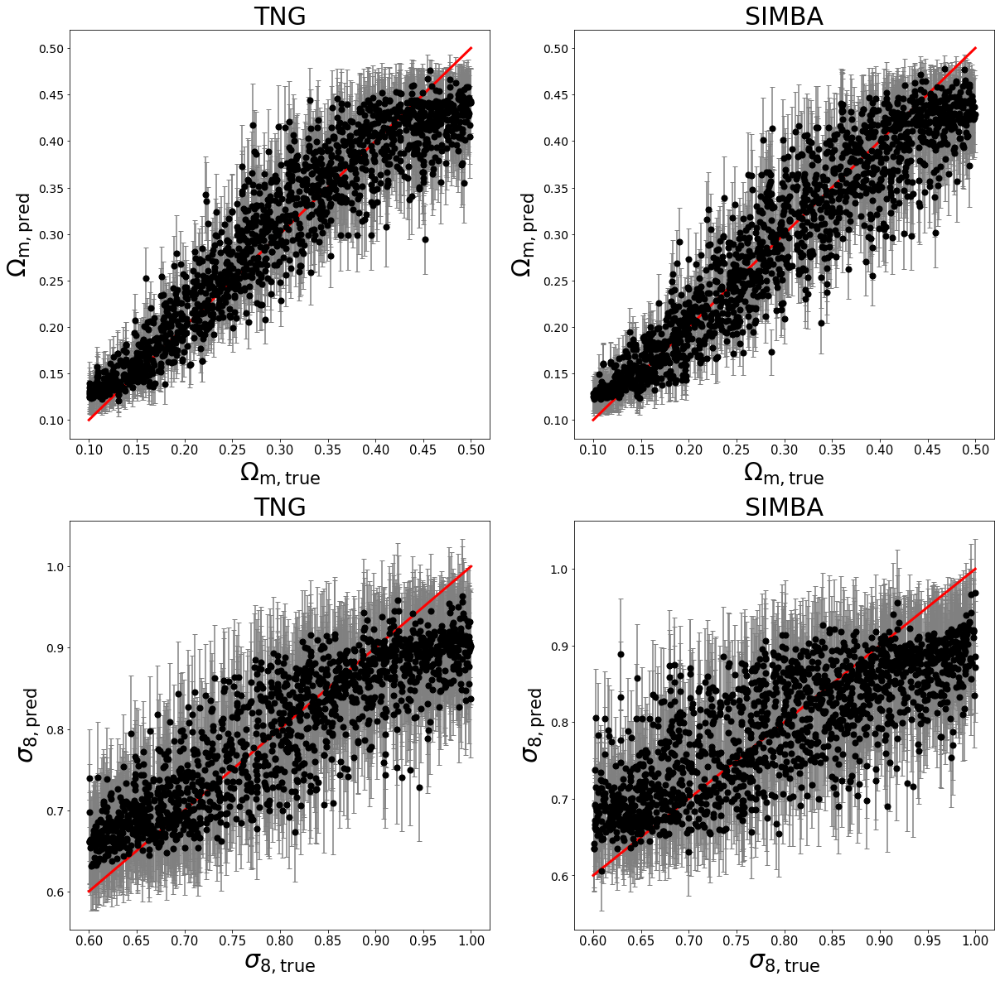

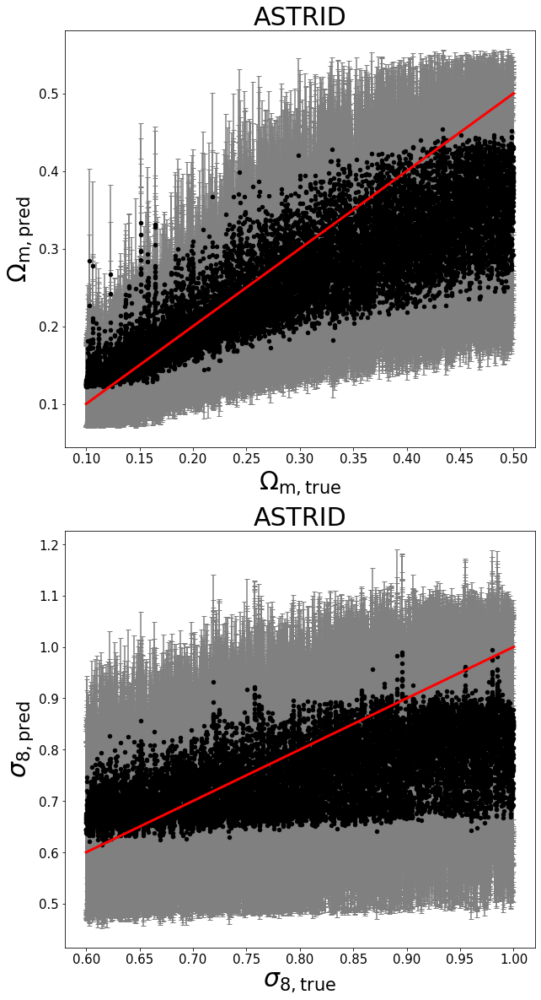

In [22]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_high"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=False,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

$\Omega_m$: MSE=0.001, % error=10.550%, R2 score=0.889,chi2=0.983, bias=-0.024
$\sigma_8$: MSE=0.004, % error=6.447%, R2 score=0.695,chi2=1.133, bias=-0.004
The ROC AUC score for classification is 0.8992713810852575.

(15000, 2)
$\Omega_m$: MSE=0.004, % error=20.503%, R2 score=0.678,chi2=2.593, bias=-0.139
$\sigma_8$: MSE=0.013, % error=10.474%, R2 score=-0.006,chi2=4.860, bias=0.073


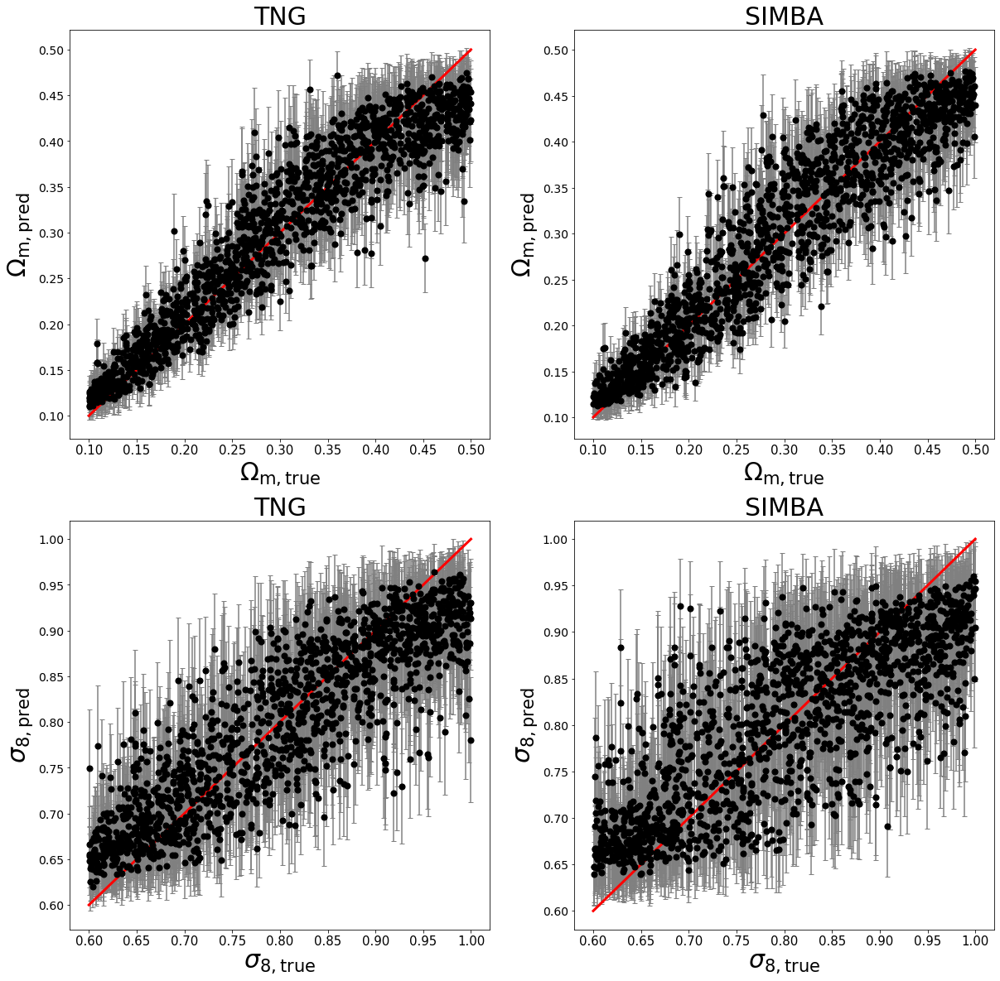

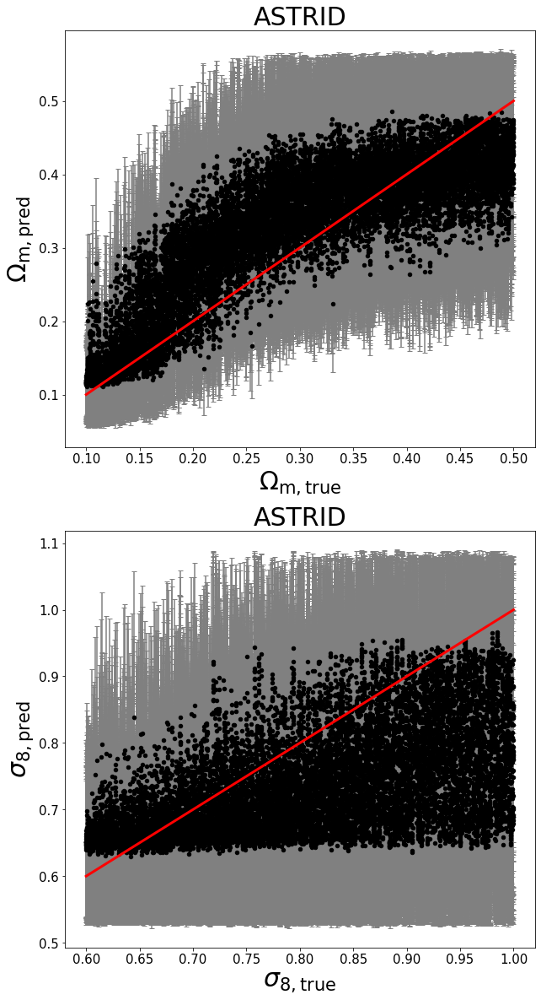

In [21]:
sim  = ['TNG', 'SIMBA']; field = 'HI'
study_name = "TNG_SIMBA_HI_wph_high2"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=1000, 
            data_type = 'wph',
            normalization=True,
            monopole = True,
            projection=False,
            average=False,
            device=device,
            L=4, dn=2, proc_imag=np.absolute)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="vib+cls",num_trial=None, fpath=fpath)
mist.get_score()
mist.make_plots(fname='cnn_test', save_plot=False)
mist.test_on('ASTRID', show_score=True)

## Three sims

$\Omega_m$: MSE=0.000, % error=4.044%, R2 score=0.979,chi2=0.679, bias=-0.012
$\sigma_8$: MSE=0.002, % error=4.479%, R2 score=0.847,chi2=1.039, bias=-0.005
$\Omega_m$: MSE=0.000, % error=3.229%, R2 score=0.989,chi2=0.352, bias=-0.009
$\sigma_8$: MSE=0.001, % error=3.796%, R2 score=0.900,chi2=0.686, bias=-0.011


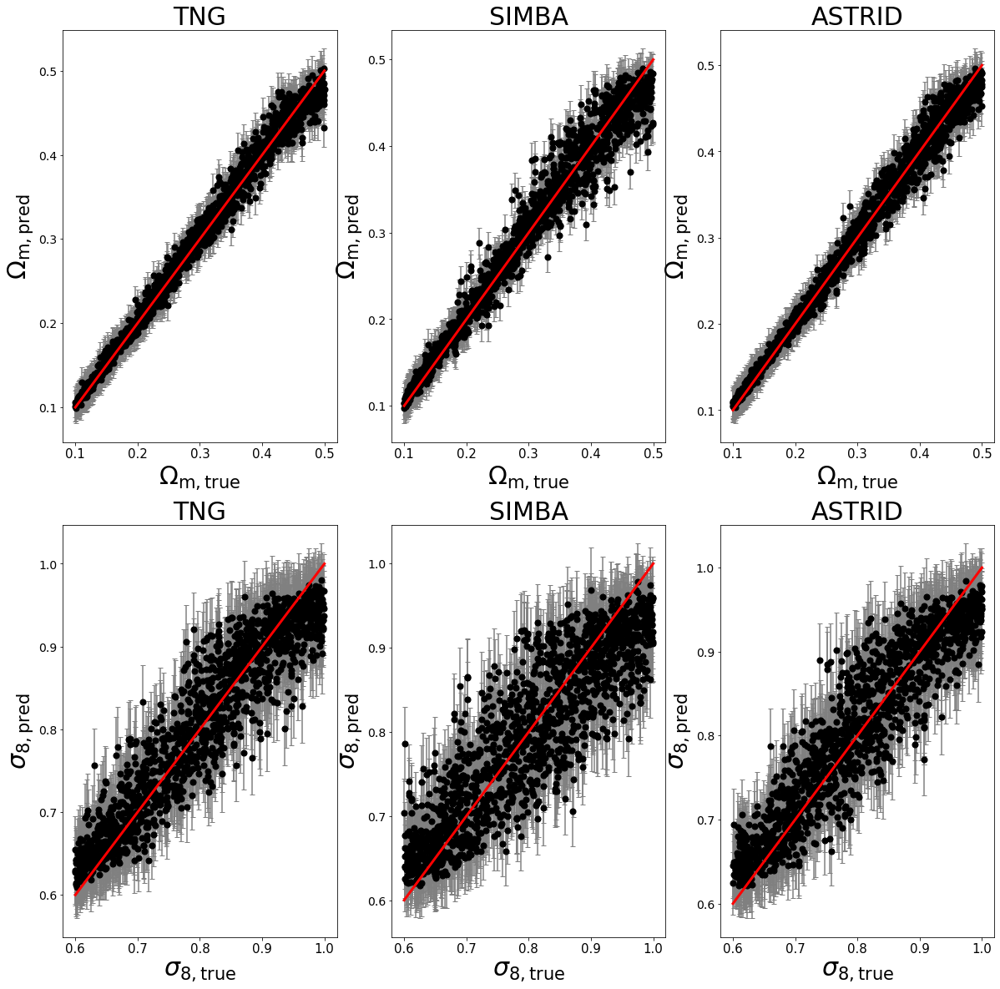

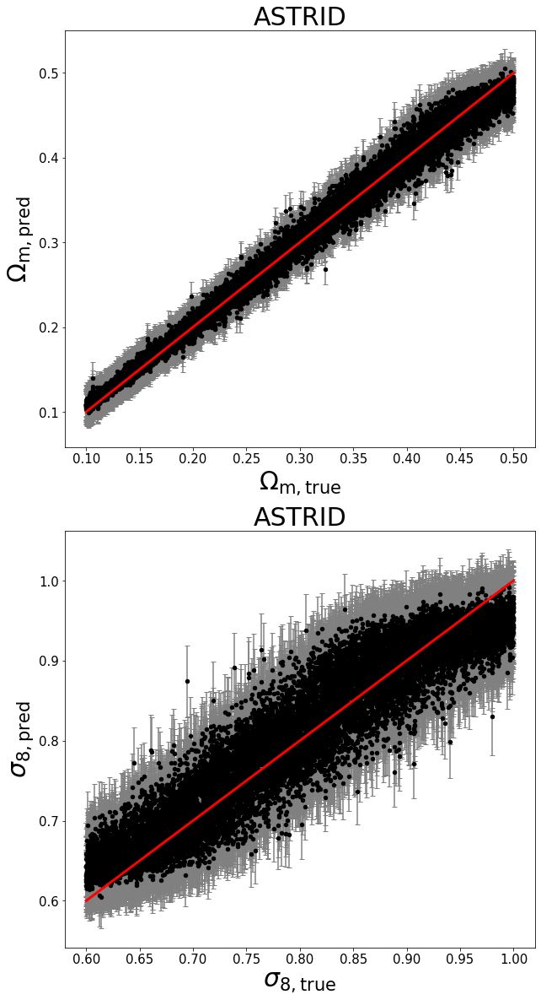

In [26]:
sim  = ['TNG', 'SIMBA', 'ASTRID']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_ASTRID_HI_cnn_enc_dec_zero_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
mist.test_on_cnn('ASTRID', show_score=True)

$\Omega_m$: MSE=0.001, % error=8.886%, R2 score=0.936,chi2=0.739, bias=-0.036
$\sigma_8$: MSE=0.013, % error=12.786%, R2 score=0.014,chi2=0.998, bias=-0.020
$\Omega_m$: MSE=0.001, % error=8.511%, R2 score=0.943,chi2=0.664, bias=-0.038
$\sigma_8$: MSE=0.013, % error=12.857%, R2 score=0.008,chi2=1.007, bias=-0.021


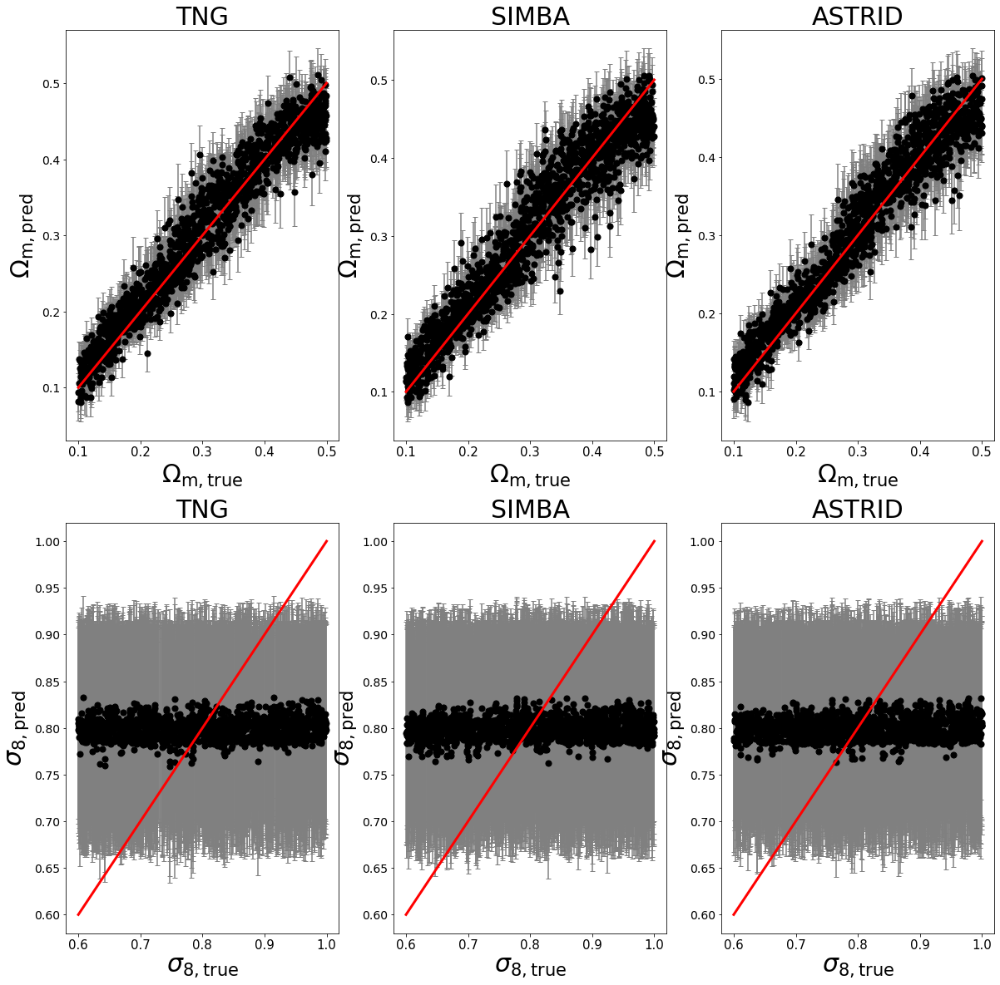

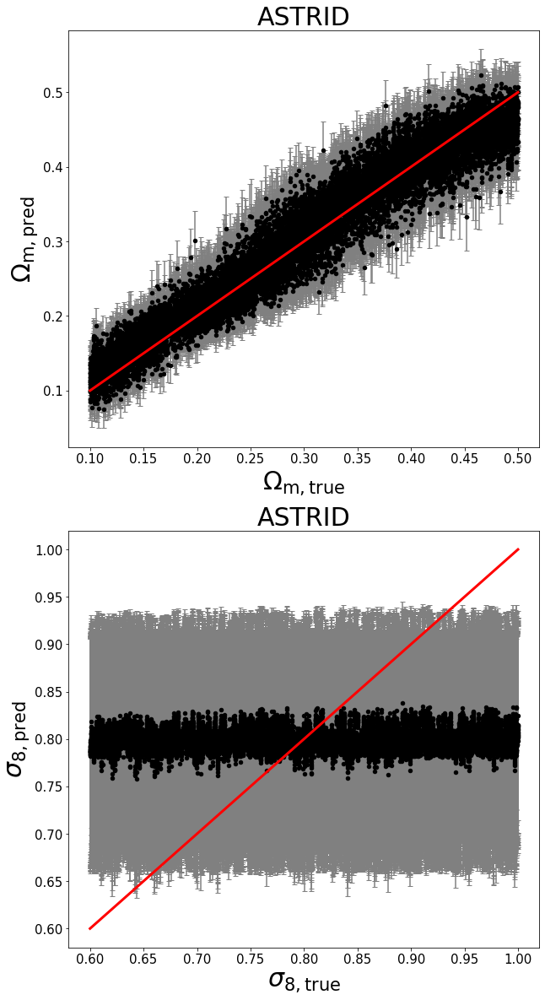

In [2]:
sim  = ['TNG', 'SIMBA', 'ASTRID']; field = 'HI'
#study_name = 'TNG_SIMBA_{}_cnn+cls_zero_monopole_1'.format(field)
study_name = "TNG_SIMBA_ASTRID_HI_cnn_enc_dec_high_monopole_1"
storage    = f"sqlite:////mnt/home/yjo10/ceph/CAMELS/MIEST/information_bottleneck/database/{study_name}.db"
mist = MIST(sim=sim, field=field, batch_size=32, 
            data_type = 'image',
            normalization=True,
            monopole = True,
            device=device)
mist.load_optuna_models(storage=storage,study_name=study_name, which_machine="cnn_enc_dec",num_trial=None, fpath=fpath)
mist.get_score_cnn()
mist.make_plots_cnn(fname='cnn_test', save_plot=False)
mist.test_on_cnn('ASTRID', show_score=True)